In [3377]:
from utility import *
import utility as utl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker 
import statsmodels.api as sm
import pymssql as msql
import pymysql
from tqdm import tqdm
from datetime import datetime
plt.rcParams['font.sans-serif']=['SimHei'] #用来正常显示中文标签
plt.rcParams['axes.unicode_minus']=False #用来正常显示负号

import warnings
warnings.filterwarnings("ignore")

import pickle
def save_variable(v,filename):
    f = open(filename,'wb')
    pickle.dump(v,f)
    f.close()
    return filename

def load_variable(filename):
    try:
        f = open(filename,'rb')
        r = pickle.load(f)
        f.close()
        return r
    except EOFError:
        return ""

pickle_path = '/home/aifi/script/jupyter_projects/hjc/Pickles/'

conn_jy = msql.connect(server="10.0.185.138",user="jrkj",password="bpkdJ4_atXFJ7",database="JYDB")
conn = pymysql.connect(host="10.20.19.174",user="fasea_ro",password="1SzzsQl@fin",database="fasea")

import cx_Oracle
import os
import time
from datetime import date, timedelta
os.environ["NLS_LANG"] = "SIMPLIFIED CHINESE_CHINA.UTF8"
Oracle_USER = "jrkj"
Oracle_PWD = 'bpkdJ4_atXFJ7'
Oracle_HOST = '10.0.185.137'
Oracle_PORT = '1521'
Oracle_SERV = 'winddb'
conn_addr = Oracle_USER + '/' + Oracle_PWD + '@' + Oracle_HOST + ':' + Oracle_PORT + '/' + Oracle_SERV
conn_wd = cx_Oracle.connect(conn_addr)

import talib as tabs

In [3378]:
def jy2wind(bd_lst):#wind_code
    import utility as utl
    sql = '''select distinct InnerCode,wind_code
            from jybondcode2wind
            where InnerCode in ({}) and wind_code is not null
            '''.format(utl.lst2sql(bd_lst))
    windcode_df = pd.read_sql(sql, conn)#.wind_code.to_list()
    sql = '''
    select distinct InnerCode,SecuAbbr from Bond_Code
    where InnerCode in ({})
    '''.format(utl.lst2sql(bd_lst))
    code_abbr_df = pd.read_sql(sql,conn_jy)#.SecuAbbr.to_list()
    abbr_df = windcode_df.merge(code_abbr_df,on = 'InnerCode',how='left');
    code_df = abbr_df[['InnerCode','wind_code','SecuAbbr']]
    code_df.columns = ['InnerCode','WindCode','ChiName']
    code_df = code_df.set_index('InnerCode')
    return code_df

In [3379]:
today_str = time.strftime("%Y%m%d", time.localtime())
today_str

'20230117'

# 数据筛选

In [3380]:
beg_dt = '20180101'
end_dt = today_str
data_counts = {}

## （一）Raw

Raw: 
Data counts: 314452
Number of bonds: 699


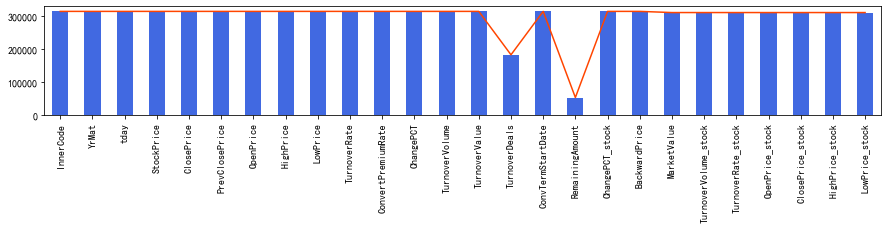

In [3381]:
sql = '''
SELECT 
a.InnerCode,a.YrMat,a.TradingDay as tday,a.StockPrice,a.ClosePrice,a.PrevClosePrice,a.OpenPrice,a.HighPrice,a.LowPrice,
a.TurnoverRate, a.ConvertPremiumRate, a.ChangePCT, a.TurnoverVolume, a.TurnoverValue, a.TurnoverDeals, b.ConvTermStartDate,
conv.RemainingAmount,per.ChangePCT as ChangePCT_stock, per.BackwardPrice, sper.TotalMV as MarketValue, 
sper.TurnoverVolume as TurnoverVolume_stock, sper.TurnoverRate as TurnoverRate_stock, sper.OpenPrice as OpenPrice_stock, 
sper.ClosePrice as ClosePrice_stock, sper.HighPrice as HighPrice_stock, sper.LowPrice as LowPrice_stock
FROM Bond_ConBDExchangeQuote a
left join Bond_ConBDBasicInfo b on a.InnerCode = b.InnerCode
left join Bond_ConBDConvertInfo conv on a.InnerCode = conv.InnerCode and a.TradingDay = conv.EndDate and conv.EventType = 1

left join SecuMain on b.SecuCode = SecuMain.SecuCode and b.SecuAbbr = SecuMain.SecuAbbr
left join DZ_PerformanceData per on SecuMain.InnerCode = per.InnerCode and per.TradingDay = a.TradingDay
left join QT_StockPerformance sper on SecuMain.InnerCode = sper.InnerCode and sper.TradingDay = a.TradingDay

WHERE a.TradingDay>='{}'
and b.BondForm = 1
order by a.InnerCode, a.TradingDay
'''
data = pd.read_sql(sql.format(beg_dt), conn_jy)
data = data.sort_values(['InnerCode','tday'])

print('Raw: ')
print('Data counts: {}'.format(data.shape[0]))
print('Number of bonds: {}'.format(len(data.InnerCode.unique())))
data_counts['Raw'] = [data.shape[0],len(data.InnerCode.unique())]

data.count().plot(figsize=(15,2),color = 'orangered')
data.count().plot(kind='bar',figsize=(15,2),color = 'royalblue')
plt.show()

In [3382]:
data.count()

InnerCode               314452
YrMat                   314452
tday                    314452
StockPrice              314452
ClosePrice              314452
PrevClosePrice          314452
OpenPrice               314446
HighPrice               314446
LowPrice                314446
TurnoverRate            314452
ConvertPremiumRate      314452
ChangePCT               314452
TurnoverVolume          314452
TurnoverValue           314452
TurnoverDeals           182647
ConvTermStartDate       314452
RemainingAmount          52867
ChangePCT_stock         314452
BackwardPrice           314452
MarketValue             310904
TurnoverVolume_stock    310904
TurnoverRate_stock      310904
OpenPrice_stock         310904
ClosePrice_stock        310904
HighPrice_stock         310904
LowPrice_stock          310904
dtype: int64

In [3383]:
nan_df = pd.DataFrame([data[data.BackwardPrice.isna()].groupby('InnerCode').min().tday,
data[data.BackwardPrice.isna()].groupby('InnerCode').max().tday],index = ['Start','End']).T
nan_df['Num'] = (data[data.BackwardPrice.isna()].groupby('InnerCode').count().tday)
#nan_df = pd.concat([nan_df,jy2wind(nan_df.index)],axis=1)

In [3384]:
nan_df 

,Start,End,Num
InnerCode,,,


## （二）Complete

In [3385]:
#将剩余价值填充
data['RemainingAmount'] = data.groupby(['InnerCode'])['RemainingAmount'].ffill()
#生成MA5/MA20
data['ma5/ma20'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(5,min_periods = 1).mean() / x.rolling(20,min_periods = 1).mean())
# data.to_excel('./data/cb_y_ori.xlsx',index=False)
data['ma5/ma20'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(5,min_periods = 1).mean() / x.rolling(20,min_periods = 1).mean())
data['ma1/ma5'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(1,min_periods = 1).mean() / x.rolling(20,min_periods = 1).mean())
data['ma1/ma10'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(1,min_periods = 1).mean() / x.rolling(10,min_periods = 1).mean())
data['ma2/ma20'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(5,min_periods = 1).mean() / x.rolling(10,min_periods = 1).mean())
data['ma2/ma10'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(5,min_periods = 1).mean() / x.rolling(40,min_periods = 1).mean())
data['ma2/ma5'] = data.groupby('InnerCode')['ClosePrice'].\
    apply(lambda x: x.rolling(5,min_periods = 1).mean() / x.rolling(60,min_periods = 1).mean())
data['ma5/ma20_stock'] = data.groupby('InnerCode')['BackwardPrice'].\
    apply(lambda x: x.rolling(5,min_periods = 1).mean() / x.rolling(20,min_periods = 1).mean())
data['ma20/ma40_stock'] = data.groupby('InnerCode')['BackwardPrice'].\
    apply(lambda x: x.rolling(20,min_periods = 1).mean() / x.rolling(40,min_periods = 1).mean())
data['ma2/ma20_stock'] = data.groupby('InnerCode')['BackwardPrice'].\
    apply(lambda x: x.rolling(2,min_periods = 1).mean() / x.rolling(20,min_periods = 1).mean())
data['ma20/ma60_stock'] = data.groupby('InnerCode')['BackwardPrice'].\
    apply(lambda x: x.rolling(20,min_periods = 1).mean() / x.rolling(60,min_periods = 1).mean())
data['ma40/ma120_stock'] = data.groupby('InnerCode')['BackwardPrice'].\
    apply(lambda x: x.rolling(40,min_periods = 1).mean() / x.rolling(120,min_periods = 1).mean())
#选择日期在转股开始日之后的
data = data[(data.tday >= data.ConvTermStartDate)]

print('Complete: ')
print('Data counts: {}'.format(data.shape[0]))
print('Number of bonds: {}'.format(len(data.InnerCode.unique())))
data_counts['Complete'] = [data.shape[0],len(data.InnerCode.unique())]

Complete: 
Data counts: 245898
Number of bonds: 620


## （三）Dirty

In [3386]:
# 赎回公告日之后不看
sql = '''
SELECT 
*
FROM Bond_ConBDCallPutInfo callput
WHERE
OpType = 101 and OpTypeSecond = 10101
AND IfOption = 1
'''
call_opt = pd.read_sql(sql.format(beg_dt), conn_jy)

# 加入special notice表中的赎回公告
sql = '''
SELECT 
InnerCode,InfoPublDate
FROM LC_SpecialNotice callput
WHERE
NoticeType = 27
order by InfoPublDate desc
'''
call_opt_notice = pd.read_sql(sql.format(beg_dt), conn_jy)
call_opt_notice = call_opt_notice.drop_duplicates(subset=['InnerCode'], keep='last')
call_opt = call_opt[['InnerCode','InfoPublDate']].append(call_opt_notice, ignore_index=True).sort_values(['InnerCode','InfoPublDate']).\
    drop_duplicates(subset=['InnerCode'], keep='first')

data_co = data.merge(call_opt[['InnerCode','InfoPublDate']], on='InnerCode', how='left')
data_co = data_co[data_co.InfoPublDate.isna() | (data_co.tday <= data_co.InfoPublDate)]
#data_co = utl.jy2wind_df(data_co, conn_wd)
data_co = utl.jy2wind_df(data_co, conn)

sql = '''
SELECT 
S_INFO_WINDCODE, S_INFO_COMPCODE, S_INFO_TYPECODE
FROM CBondIssuer
WHERE
S_INFO_TYPECODE = 115200000
and S_INFO_WINDCODE in ({})
order by S_INFO_WINDCODE, USED desc
'''
wind_compcode = pd.read_sql(sql.format(utl.lst2sql(data_co.wind_code.drop_duplicates().to_list())),conn)
wind_compcode = wind_compcode.drop_duplicates('S_INFO_WINDCODE', keep='first')

data_co = data_co.merge(wind_compcode, left_on='wind_code', right_on='S_INFO_WINDCODE', how='left')
data_co['y_pct_5'] = data_co.groupby(['InnerCode'])['ClosePrice'].pct_change(5).shift(-5)
data_co['y_pct_5_rank'] = data_co.groupby('tday', as_index=False)['y_pct_5'].rank(pct=True).shift(-5)

print('Dirty: ')
print('Data counts: {}'.format(data_co.shape[0]))
print('Number of bonds: {}'.format(len(data_co.InnerCode.unique())))
data_counts['Dirty'] = [data_co.shape[0],len(data_co.InnerCode.unique())]

Dirty: 
Data counts: 242088
Number of bonds: 620


## （四）Clean

In [3387]:
data_co_yaogu = data_co[
                ((data_co.ClosePrice>=140.0)&(data_co.ConvertPremiumRate>=40.0))|
                ((data_co.ClosePrice>=180.0)&(data_co.ConvertPremiumRate>=30.0))
                ]
data_co_high_to = data_co[
                data_co.TurnoverRate>=80
                ]
data_co_yaogu_gp = data_co_yaogu.groupby('InnerCode')['tday'].count().to_frame()
data_co_high_to_gp = data_co_high_to.groupby('InnerCode')['tday'].count().to_frame()
data_co_gp = data_co.groupby('InnerCode')['tday'].count().to_frame()
data_co_gp = data_co_gp.merge(data_co_yaogu_gp, left_index=True, right_index=True, how='left', suffixes=['', '_yaogu']).\
                        merge(data_co_high_to_gp, left_index=True, right_index=True, how='left', suffixes=['', '_to'])
data_co_gp = data_co_gp.fillna(0)
data_co_gp['yaogu_r'] = data_co_gp['tday_yaogu']/data_co_gp['tday']
data_co_gp['to_r'] = data_co_gp['tday_to']/data_co_gp['tday']
#剔除妖比例比较大的转债
data_co_gp_drop = data_co_gp[(data_co_gp['yaogu_r']>0.5)|(data_co_gp['to_r']>0.5)].index
# 人工加入小康转债
data_co_gp_drop = data_co_gp_drop.to_list()
data_co_gp_drop.append(150450)
cdata = data_co[(~data_co.InnerCode.isin(data_co_gp_drop))&
                (data_co.RemainingAmount>=100000000)&
                (~((data_co.ClosePrice>=140)&(data_co.ConvertPremiumRate>=40)))&
                (~((data_co.ClosePrice>=180)&(data_co.ConvertPremiumRate>=30)))&
                (data_co.YrMat>0.5)
                # (data_co.TurnoverRate<40)
                ]
# 剔除债项评级A以下
cdata = cdata[~cdata.SecuAbbr.isin(['众信转债','蓝盾转债','亚药转债','鸿达转债','搜特转债','起步转债','花王转债','洪涛转债','福特转债'])]

print('Clean: ')
print('Data counts: {}'.format(cdata.shape[0]))
print('Number of bonds: {}'.format(len(cdata.InnerCode.unique())))
data_counts['Clean'] = [cdata.shape[0],len(cdata.InnerCode.unique())]

Clean: 
Data counts: 218617
Number of bonds: 581


In [3388]:
pd.DataFrame(data_counts,index = ['data counts','bonds number'])

,Raw,Complete,Dirty,Clean
data counts,314452,245898,242088,218617
bonds number,699,620,620,581


# 简单回测

## （一）IC

<AxesSubplot:>

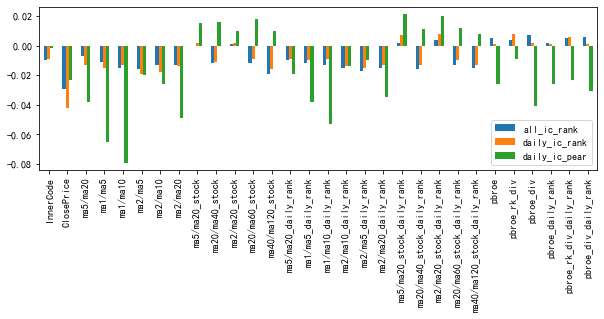

In [3389]:
wdata = cdata[['InnerCode','ClosePrice', 'tday', 'ma5/ma20', 'ma1/ma5', 'ma1/ma10', 'ma2/ma5', 'ma2/ma10', 'ma2/ma20',
'ma5/ma20_stock','ma20/ma40_stock','ma2/ma20_stock','ma20/ma60_stock','ma40/ma120_stock']].copy()
wdata['ma5/ma20_daily_rank'] = wdata.groupby('tday', as_index=False)['ma5/ma20'].rank(pct=True)
wdata['ma1/ma5_daily_rank'] = wdata.groupby('tday', as_index=False)['ma1/ma5'].rank(pct=True)
wdata['ma1/ma10_daily_rank'] = wdata.groupby('tday', as_index=False)['ma1/ma10'].rank(pct=True)
wdata['ma2/ma10_daily_rank'] = wdata.groupby('tday', as_index=False)['ma2/ma10'].rank(pct=True)
wdata['ma2/ma5_daily_rank'] = wdata.groupby('tday', as_index=False)['ma2/ma5'].rank(pct=True)
wdata['ma2/ma20_daily_rank'] = wdata.groupby('tday', as_index=False)['ma2/ma20'].rank(pct=True)
wdata['ma5/ma20_stock_daily_rank'] = wdata.groupby('tday', as_index=False)['ma5/ma20_stock'].rank(pct=True)
wdata['ma20/ma40_stock_daily_rank'] = wdata.groupby('tday', as_index=False)['ma20/ma40_stock'].rank(pct=True)
wdata['ma2/ma20_stock_daily_rank'] = wdata.groupby('tday', as_index=False)['ma2/ma20_stock'].rank(pct=True)
wdata['ma20/ma60_stock_daily_rank'] = wdata.groupby('tday', as_index=False)['ma20/ma60_stock'].rank(pct=True)
wdata['ma40/ma120_stock_daily_rank'] = wdata.groupby('tday', as_index=False)['ma40/ma120_stock'].rank(pct=True)
wdata['pbroe'] = wdata['ma5/ma20_daily_rank'] - wdata['ma20/ma40_stock_daily_rank']
wdata['pbroe_rk_div'] = wdata['ma5/ma20_daily_rank']/wdata['ma20/ma40_stock_daily_rank']
wdata['pbroe_div'] = wdata['ma5/ma20']/wdata['ma20/ma40_stock']
wdata['pbroe_daily_rank'] = wdata.groupby('tday', as_index=False)['pbroe'].rank(pct=True)
wdata['pbroe_rk_div_daily_rank'] = wdata.groupby('tday', as_index=False)['pbroe_rk_div'].rank(pct=True)
wdata['pbroe_div_daily_rank'] = wdata.groupby('tday', as_index=False)['pbroe_div'].rank(pct=True)

df = wdata.merge(data_co[['InnerCode','tday','y_pct_5_rank','y_pct_5','ChangePCT']], on=['InnerCode','tday'], how='outer')
#加入clean mask
clean_mask_long = np.array(df.ClosePrice.isna().replace([True,False],[np.nan,1]))
for i in df.columns[3:]:
    df[i] = df[i]*clean_mask_long
#求相关性
feature_corr = np.abs(df.corr()['y_pct_5_rank'])
feature_keep = list(feature_corr[(feature_corr>0.02)&(feature_corr<1.0)].index)
df_filtered = df[feature_keep+['InnerCode','tday']]
new_res = df[df.tday>=datetime.strptime('20151001', '%Y%m%d')].corr()['y_pct_5_rank']
#求日相关性
daily_corr = df.groupby('tday').corr().replace(1,np.nan)['y_pct_5_rank'].reset_index().groupby('level_1').mean()
daily_corr_pear = df.groupby('tday').corr().replace(1,np.nan)['y_pct_5'].reset_index().groupby('level_1').mean()
#不同计算方式产生的不同结果
IC_result = pd.DataFrame([new_res,daily_corr.y_pct_5_rank,daily_corr_pear.y_pct_5
             ],index = ['all_ic_rank','daily_ic_rank','daily_ic_pear']
            ).round(3).iloc[:,:-3]
IC_result.T.plot(kind='bar',figsize=(10,3))

In [3390]:
IC_result

,InnerCode,ClosePrice,ma5/ma20,ma1/ma5,ma1/ma10,ma2/ma5,ma2/ma10,ma2/ma20,ma5/ma20_stock,ma20/ma40_stock,...,ma20/ma40_stock_daily_rank,ma2/ma20_stock_daily_rank,ma20/ma60_stock_daily_rank,ma40/ma120_stock_daily_rank,pbroe,pbroe_rk_div,pbroe_div,pbroe_daily_rank,pbroe_rk_div_daily_rank,pbroe_div_daily_rank
all_ic_rank,-0.010,-0.029,-0.007,-0.011,-0.015,-0.016,-0.013,-0.013,0.000,-0.012,...,-0.016,0.004,-0.013,-0.015,0.005,0.004,0.007,0.002,0.005,0.006
daily_ic_rank,-0.009,-0.042,-0.013,-0.015,-0.013,-0.019,-0.018,-0.014,0.002,-0.011,...,-0.013,0.008,-0.010,-0.013,0.001,0.008,0.002,0.001,0.006,0.001
daily_ic_pear,-0.002,-0.023,-0.038,-0.065,-0.079,-0.020,-0.026,-0.049,0.015,0.016,...,0.011,0.020,0.012,0.008,-0.026,-0.009,-0.041,-0.026,-0.023,-0.031


In [3391]:
wdata.shape

(218617, 31)

## （二）净值曲线

<AxesSubplot:xlabel='tday'>

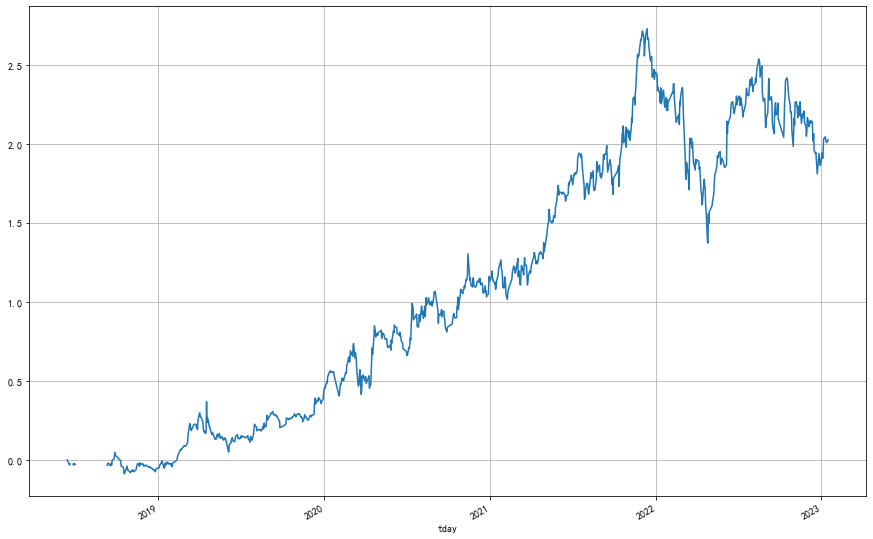

In [3392]:
factor = 'ma5/ma20_daily_rank'
hld = wdata[['InnerCode','tday',factor]].merge(data_co[['InnerCode','tday','ChangePCT']], on=['InnerCode','tday'], how='right')
hld['sig_ma'] = hld[factor]<0.02
hld[hld['tday']==max(hld['tday'])].dropna(subset=[factor], axis=0).sort_values(factor)

hld_period = 5
# ffill持仓
hld['sig_ma'] = hld['sig_ma'].replace(False, np.nan)
hld['hld'] = hld.groupby('InnerCode')['sig_ma'].shift(1).ffill(limit=(hld_period-1))
hld['ret'] = hld['hld']*hld['ChangePCT']/100
hld = utl.jy2wind_df(hld, conn)
((1+hld.groupby('tday')['ret'].mean()).cumprod()-1).plot(figsize=(15,10),grid=True)


In [3393]:
wdata.count()

InnerCode                      218617
ClosePrice                     218617
tday                           218617
ma5/ma20                       218617
ma1/ma5                        218617
ma1/ma10                       218617
ma2/ma5                        218617
ma2/ma10                       218617
ma2/ma20                       218617
ma5/ma20_stock                 218617
ma20/ma40_stock                218617
ma2/ma20_stock                 218617
ma20/ma60_stock                218617
ma40/ma120_stock               218617
ma5/ma20_daily_rank            218617
ma1/ma5_daily_rank             218617
ma1/ma10_daily_rank            218617
ma2/ma10_daily_rank            218617
ma2/ma5_daily_rank             218617
ma2/ma20_daily_rank            218617
ma5/ma20_stock_daily_rank      218617
ma20/ma40_stock_daily_rank     218617
ma2/ma20_stock_daily_rank      218617
ma20/ma60_stock_daily_rank     218617
ma40/ma120_stock_daily_rank    218617
pbroe                          218617
pbroe_rk_div

# 深入探索

## （一）数据格式转换

<AxesSubplot:>

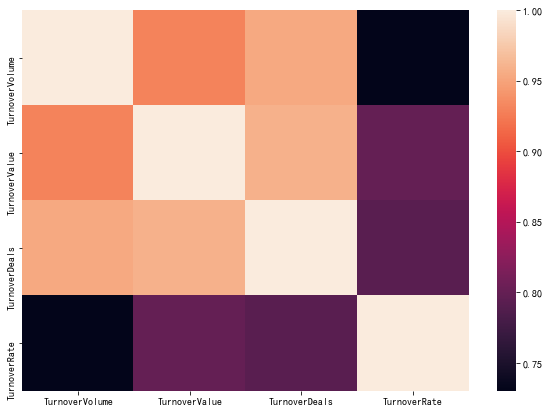

In [3394]:
import seaborn as sns
plt.figure(figsize=(10,7))
sns.heatmap(data[['TurnoverVolume','TurnoverValue','TurnoverDeals','TurnoverRate']].corr())

In [3395]:
data[['TurnoverVolume','TurnoverValue','TurnoverDeals','TurnoverRate']].corr()

,TurnoverVolume,TurnoverValue,TurnoverDeals,TurnoverRate
TurnoverVolume,1.000000,0.930459,0.954372,0.730316
TurnoverValue,0.930459,1.000000,0.959790,0.800664
TurnoverDeals,0.954372,0.959790,1.000000,0.792813
TurnoverRate,0.730316,0.800664,0.792813,1.000000


In [3396]:
data[['TurnoverVolume','TurnoverValue','TurnoverDeals','TurnoverRate']].describe().round(3)

,TurnoverVolume,TurnoverValue,TurnoverDeals,TurnoverRate
count,2.458980e+05,2.458980e+05,144572.000,245898.000
mean,9.038425e+05,1.565797e+08,12407.334,36.666
std,2.964308e+06,5.866508e+08,36074.875,161.522
min,2.000000e+01,2.080000e+03,0.000,0.000
25%,5.879775e+04,6.517154e+06,712.000,0.699
50%,1.683375e+05,1.987848e+07,2313.000,1.943
75%,5.773510e+05,7.864396e+07,8455.000,9.190
max,1.026693e+08,2.973454e+10,918548.000,7105.784


In [3397]:
from datetime import datetime
df = wdata.merge(cdata[['InnerCode','tday']], on=['InnerCode','tday'], how='outer')
factor_keep = ['ma5/ma20','ma5/ma20_daily_rank']
df_filtered = df[factor_keep+['InnerCode','tday']]

def func(x):
    return x.mean()

def long_to_dataframe(df,col_name,time_name,code_name,time_delta,func):
    return np.nan,(df.pivot(index = code_name,columns = time_name,values = col_name))

factor = 'ma5/ma20'
factor_rank = 'ma5/ma20_daily_rank'
#5/20 官方信号
hld = df_filtered[['InnerCode','tday',factor]].merge(data[['InnerCode','tday','ChangePCT']], on=['InnerCode','tday'], how='right')
a,Factor_long = long_to_dataframe(hld,'ma5/ma20','tday','InnerCode',1,func)
#5/20 rank 官方信号
hld = df_filtered[['InnerCode','tday',factor_rank]].merge(data[['InnerCode','tday','ChangePCT']], on=['InnerCode','tday'], how='right')
a,Factor_rank_long = long_to_dataframe(hld,'ma5/ma20_daily_rank','tday','InnerCode',1,func)
#dirty上官方回测数据
a,change_pct_long = long_to_dataframe(data,'ChangePCT','tday','InnerCode',1,func)
#dirty上价格和溢价率提取
factor = 'ma5/ma20'
a,Close_price_df = long_to_dataframe(data,'ClosePrice','tday','InnerCode',1,func)
a,Premium_df = long_to_dataframe(data,'ConvertPremiumRate','tday','InnerCode',1,func)
#clean mask
all_df = cdata[['InnerCode','tday','ClosePrice']].merge(hld[['InnerCode','tday','ChangePCT']],how='right')
a,b = long_to_dataframe(all_df,'ClosePrice','tday','InnerCode',1,func)
clean_mask = b.isna().replace([True,False],[np.nan,1])
#Trade 提取
a,Trade_volume_df = long_to_dataframe(data,'TurnoverVolume','tday','InnerCode',1,func)
a,Trade_value_df = long_to_dataframe(data,'TurnoverValue','tday','InnerCode',1,func)
a,Trade_deals_df = long_to_dataframe(data,'TurnoverDeals','tday','InnerCode',1,func)
a,Turnover_rate_df = long_to_dataframe(data,'TurnoverRate','tday','InnerCode',1,func)
#股价提取
a,Stock_price_df = long_to_dataframe(data,'BackwardPrice','tday','InnerCode',1,func) 
a,Stock_price_ori_df = long_to_dataframe(data,'StockPrice','tday','InnerCode',1,func) 
#高开低收提取
High_price_df = (data[['InnerCode','tday','HighPrice']].pivot(index = 'InnerCode',columns = 'tday',values = 'HighPrice'))
Open_price_df = (data[['InnerCode','tday','OpenPrice']].pivot(index = 'InnerCode',columns = 'tday',values = 'OpenPrice'))
Low_price_df = (data[['InnerCode','tday','LowPrice']].pivot(index = 'InnerCode',columns = 'tday',values = 'LowPrice'))
#市值提取
a,Market_value_df = long_to_dataframe(data,'MarketValue','tday','InnerCode',1,func)
#股票成交情况提取
a,Trade_volume_stock_df = long_to_dataframe(data,'TurnoverVolume_stock','tday','InnerCode',1,func) 
a,Turnover_rate_stock_df = long_to_dataframe(data,'TurnoverRate_stock','tday','InnerCode',1,func) 
a,High_price_stock_df = long_to_dataframe(data,'HighPrice_stock','tday','InnerCode',1,func) 
a,Open_price_stock_df = long_to_dataframe(data,'OpenPrice_stock','tday','InnerCode',1,func) 
a,Low_price_stock_df = long_to_dataframe(data,'LowPrice_stock','tday','InnerCode',1,func)  
a,Close_price_stock_df = long_to_dataframe(data,'ClosePrice_stock','tday','InnerCode',1,func)  

def unify_fr(Factor,Return):
    Return = Return.dropna(how='all',axis=1).dropna(how='all',axis=0)
    index = Return.index
    date = Return.columns
    Factor = Factor.loc[index][date]
    print(Factor.shape)
    print(Return.shape)
    return Return, Factor

change_pct_long,Factor_long = unify_fr(Factor_long,change_pct_long)
change_pct_long,Factor_rank_long = unify_fr(Factor_rank_long,change_pct_long)
change_pct_long,Close_price_df = unify_fr(Close_price_df,change_pct_long)
change_pct_long,clean_mask = unify_fr(clean_mask,change_pct_long)
change_pct_long,High_price_df = unify_fr(High_price_df,change_pct_long)
change_pct_long,Low_price_df = unify_fr(Low_price_df,change_pct_long)
change_pct_long,Open_price_df = unify_fr(Open_price_df,change_pct_long)
change_pct_long,Premium_df = unify_fr(Premium_df,change_pct_long)
change_pct_long,Trade_volume_df = unify_fr(Trade_volume_df,change_pct_long)
change_pct_long,Trade_value_df = unify_fr(Trade_value_df,change_pct_long)
change_pct_long,Trade_deals_df = unify_fr(Trade_deals_df,change_pct_long)
change_pct_long,Stock_price_df = unify_fr(Stock_price_df,change_pct_long)
change_pct_long,Stock_price_ori_df = unify_fr(Stock_price_ori_df,change_pct_long)
Stock_price_df_fill = Stock_price_df.fillna(Stock_price_ori_df)
change_pct_long,Market_value_df = unify_fr(Market_value_df,change_pct_long)
change_pct_long,Turnover_rate_df = unify_fr(Turnover_rate_df,change_pct_long)
change_pct_long,Trade_volume_stock_df = unify_fr(Trade_volume_stock_df,change_pct_long)
change_pct_long,Turnover_rate_stock_df = unify_fr(Turnover_rate_stock_df,change_pct_long)
change_pct_long,High_price_stock_df = unify_fr(High_price_stock_df,change_pct_long)
change_pct_long,Low_price_stock_df = unify_fr(Low_price_stock_df,change_pct_long)
change_pct_long,Open_price_stock_df = unify_fr(Open_price_stock_df,change_pct_long)
change_pct_long,Close_price_stock_df = unify_fr(Close_price_stock_df,change_pct_long)


(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)
(620, 1225)


<AxesSubplot:>

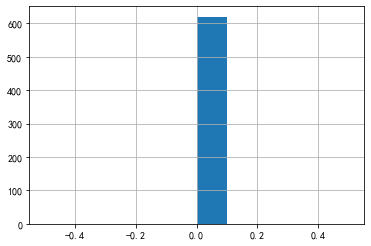

In [3398]:
check_stock = pd.DataFrame([Close_price_df.count(axis=1),Stock_price_df.count(axis=1)],index = ['Close','Stock']).T
(check_stock.Close - check_stock.Stock) .hist()

In [3399]:
%matplotlib inline

## （二）回测系统

In [3400]:
import matplotlib.gridspec as gridspec
def draw_real(return_df,fac_name='Factor'):
    IC,num = return_df['IC'],return_df['Num'].mean()
    pos_rat = (IC>0).sum()/len(IC)
    IR = IC.mean()/IC.std()
    index_port,long_port,short_port = return_df['Index'],return_df['Long'],return_df['Short']
    cum_df = (1+return_df.drop(columns = ['IC','Num'])).cumprod()-1
    color,c = ['royalblue','orangered','green'],0
    
    fig  = plt.figure(figsize=(15,7))
    gs = gridspec.GridSpec(64,3) 
    ax2 = fig.add_subplot(gs[:,:])
    for i in cum_df.columns:
        ax2.plot(cum_df[i],color = color[c])
        c += 1
    ax21 = ax2.twinx()
    ax21.bar(IC.index,list(IC),color = 'deepskyblue')
    ax21.hlines(y = 0,xmin = IC.index[0],xmax = IC.index[-1],color = 'blue')
    ax21.plot(IC.rolling(window=20,min_periods = 1).mean(),color = 'navy')#,linestyle = ':')
    ax2.legend(['Index: shp '+str(round(index_port.mean()/index_port.std()*np.sqrt(252),3)) + '; Fin '+str(round(((1+index_port).cumprod()-1).dropna().iloc[-1],3)) + '; Ret '+str(round(index_port.mean()*252,3))+ '; Vol '+str(round(index_port.std()*np.sqrt(252),3)),
                'Long_port: shp '+str(round(long_port.mean()/long_port.std()*np.sqrt(252),3)) + '; Fin '+str(round(((1+long_port).cumprod()-1).dropna().iloc[-1],3)) + '; Ret '+str(round(long_port.mean()*252,3))+ '; Vol '+str(round(long_port.std()*np.sqrt(252),3)),
                'Short_port: shp '+str(round(short_port.mean()/short_port.std()*np.sqrt(252),3)) + '; Fin '+str(round(((1+short_port).cumprod()-1).dropna().iloc[-1],3)) + '; Ret '+str(round(short_port.mean()*252,3))+ '; Vol '+str(round(short_port.std()*np.sqrt(252),3))
               ],fontsize=15,loc = 'upper left')
    ax21.legend(['IC-roll20 IR: '+str(round(IR,3))+' Port_num: '+str(round(num,3)),'IC IC-mean: '+str(round(IC.mean(),3))+' IC_posr: '+str(round(pos_rat*100,2))+'%']
               ,fontsize=15,loc = 'lower right')
    ax2.set_title(fac_name+' Real portfolio performance',fontsize=20,pad=10)
    ax2.set_xlabel('Date',fontsize=15)
    ax2.grid(True)

def draw_group(level_return_df,fac_name='Factor'):
    color_list = ['orangered','coral','gold','chocolate','limegreen','green','turquoise','dodgerblue','royalblue','darkviolet']
    step = level_return_df.shape[1]-1
    color_sel = color_list[:step]
    steps = np.arange(0,1,1/step)
    group_name = ['Group '+str(i+1) for i in range(0,step)]
    fig  = plt.figure(figsize=(15,7))
    gs = gridspec.GridSpec(64,3) 
    ax3 = fig.add_subplot(gs[:,:])
    ax3.plot((1+level_return_df['Index']).cumprod()-1,color = 'red',linewidth=3,linestyle='--')
    for i in range(0,len(steps)):
        if i==len(steps)-1:
            ax3.plot((1+level_return_df[group_name[i]]).cumprod()-1,color = color_sel[-1])
        else:
            ax3.plot((1+level_return_df[group_name[i]]).cumprod()-1,color = color_sel[i])
    ax3.legend(['Index']+group_name,loc = 'upper left',fontsize=15)
    ax3.set_title(fac_name+' Group performance',fontsize=20,pad=10)
    t = [str(i)[:10] for i in level_return_df.index[::int(len(level_return_df.index)/5)]]
    ax3.set_xticks(t)
    ax3.set_xticklabels(labels = t,rotation=20)
    ax3.set_xlabel('Date',fontsize=15)
    ax3.grid()
    
def draw_group_rank(level_rank_df,fac_name='Factor'):
    color_list = ['orangered','coral','gold','chocolate','limegreen','green','turquoise','dodgerblue','royalblue','darkviolet']
    level_rank_df = level_rank_df.drop(columns='Index')
    step = level_rank_df.shape[1]-1
    color_sel = color_list[:step]
    steps = np.arange(0,1,1/step)
    group_name = ['Group '+str(i+1) for i in range(0,step)]
    fig  = plt.figure(figsize=(15,3))
    gs = gridspec.GridSpec(64,3) 
    ax4 = fig.add_subplot(gs[:,:])
    for i in range(0,len(level_rank_df.columns)):
        col_name = level_rank_df.columns[i]
        if col_name=='Cor':
            ax42 = ax4.twinx()
            ax42.plot(level_rank_df.Cor,color = 'red',linewidth = 5,linestyle=':')
            ax42.hlines(y = 0,xmin = level_rank_df.index[0],xmax = level_rank_df.index[-1]
                       ,color = 'red',linewidth = 2,linestyle = ':')
        elif i==0 or i==len(level_rank_df.columns)-2 or i==int((len(level_rank_df.columns)-2)/2):
            ax4.plot(level_rank_df[col_name],color_sel[i],linewidth = 2)
        else:
            ax4.plot(level_rank_df[col_name],color_sel[i],linewidth = 0.7)
    ax4.legend(level_rank_df.columns,loc='center left',fontsize=10)
    ax42.legend(['Cor: '+str(round(level_rank_df.Cor.mean(),3))],loc = 'lower right',fontsize=15)
    ax4.set_title(fac_name+' Rank performance',fontsize=20,pad=10)
    ax4.set_xlabel('Date',fontsize=15)
    ax4.grid()


In [3401]:
def uni(factor):
    return (factor-factor.min())/(factor.max()-factor.min())
def uni_rank(factor):
    factor = factor.rank(axis=0, pct = True)
    return factor

def get_mask(Signal,limit):
    Signal_cum = Signal.fillna(axis=1,method='ffill',limit=limit-1).cumsum(axis=1)
    Signal_cum_fill = (Signal*Signal_cum).fillna(axis=1,method='ffill',limit=limit-1)
    mask_count = Signal_cum - Signal_cum_fill + 1
    mask = (~mask_count.isna()).replace([True,False],[1,np.nan])
    return mask,mask_count


def backtest_cdb(factor,ret_df_t, quantile = 0.02,limit = 5,
                 date_range=['20180101','20200101'],fac_name='Factor',
                             cal = ['Count','Real','Group','Rank'],draw=True):
    #三 截取日期区间
    start_date,end_date = datetime.strptime(str(date_range[0]),'%Y%m%d'),datetime.strptime(str(date_range[1]),'%Y%m%d')
    factor = factor.loc[:,start_date:end_date].copy()
    ret_df_t = ret_df_t.loc[:,start_date:end_date].copy()
    #四 计算
    return_dict = {}
    #（1）实盘组合统计：
    if 'Real' in cal:
        index_port = ret_df_t.mean()
        IC = (factor).corrwith((ret_df_t),method = 'spearman')
        factor = factor.rank(axis=0, pct = True,na_option='keep',ascending=True)
        factor = factor - factor.min()/2
        long_signal = (((factor>=1-quantile).replace([True,False],[1,np.nan])))
        short_signal = (factor<=(quantile)).replace([True,False],[1,np.nan])

        if limit != 0 and limit != 1:
            long_mask, long_mask_count = get_mask(long_signal,limit)
            short_mask, short_mask_count = get_mask(short_signal,limit)
        else:
            long_mask,long_mask_count,short_mask,short_mask_count = long_signal,long_signal,short_signal,short_signal
            
        long_port_df = (ret_df_t*long_mask)
        long_port = long_port_df.mean()
        short_port = (ret_df_t*short_mask).mean()
        return_df = pd.DataFrame([index_port,long_port,short_port],index = ['Index','Long','Short']).T
        return_df['IC'] = list(IC)
        return_df['Num'] = list(long_mask.count())
        return_dict['Real'] = return_df
        return_dict['Mask']= long_mask_count
        if draw:
            draw_real(return_dict['Real'],fac_name)
    #（2）分组统计：
    if 'Group' in cal or 'Rank' in cal:
        steps = np.arange(0,1,0.1)
        group_name = ['Index'] + ['Group '+str(i+1) for i in range(0,10)]
        level_return_list = []
        for i in range(0,len(steps)):
            if i==len(steps)-1:
                sel_mask = (factor>=factor.quantile(steps[i]))
            else:
                sel_mask = ((factor>=factor.quantile(steps[i])) & (factor<factor.quantile(steps[i+1])))
            ret_temp = ret_df_t[sel_mask]
            fac_temp = factor[sel_mask]
            level_return_list.append(ret_temp.mean())
        level_return_list.append(ret_df_t.mean())
        level_return_list.reverse()
        level_return_df = pd.DataFrame(level_return_list,index = group_name)
        return_dict['Group'] = level_return_df.T
        if draw and 'Group' in cal:
            draw_group(return_dict['Group'],fac_name)
    #（3）分组rank统计：
    if 'Rank' in cal:
        level_rank_df = level_return_df.T.resample('3M').mean().rank(axis=1,pct = True)#-(level_return_df.min()/2).T#.plot(figsize=(15,3))
        level_rank_df = level_rank_df-level_rank_df.min()/2
        cor_mat = pd.DataFrame(np.array([-np.arange(level_rank_df.shape[1])]
                             ).repeat(level_rank_df.shape[0],axis=0),index = level_rank_df.index
                    ,columns = level_rank_df.columns)
        cor_series = (level_rank_df.corrwith(cor_mat,axis=1,method = 'spearman'))
        level_rank_df['Cor'] = cor_series
        return_dict['Rank'] = level_rank_df
        if draw:
            draw_group_rank(return_dict['Rank'],fac_name)
    
    return return_dict


In [3402]:
return_dict = backtest_cdb(factor,ret_df_t, quantile = 0.02,limit = 5,
                 date_range=['20180101','20200101'],fac_name='Factor',
                             cal = ['Real'],draw=True)

NameError: name 'ret_df_t' is not defined

In [ ]:
return_dict['Mask'].max().plot()

# 反转策略

In [ ]:
main_fac_5_20 = (Close_price_df.rolling(axis=1,window=5,min_periods = 1).mean())/(Close_price_df.rolling(axis=1,window=20,min_periods = 1).mean())
fac_5_20 = -uni(main_fac_5_20)
f,r,n = (fac_5_20*clean_mask).shift(1,axis=1),change_pct_long/100,'MA5_MA20'
rdf_5_20 = backtest_cdb(f,r, quantile = 0.02,limit = 5,
                 date_range=['20180101','20230101'],fac_name=n,
                             cal = ['Real','Group','Rank'],draw=True)

In [ ]:
main_fac_stock = (Stock_price_df.rolling(axis=1,window=20,min_periods = 1).mean())/(Stock_price_df.rolling(axis=1,window=40,min_periods = 1).mean())
fac_stock = uni(main_fac_stock)
f,r,n = ((fac_stock)*clean_mask).shift(1,axis=1),change_pct_long/100,'ROE'
rdf_5_20 = backtest_cdb(f,r, quantile = 0.02,limit = 5,
                 date_range=['20180101','20230101'],fac_name=n,
                             cal = ['Real','Group','Rank'],draw=True)

In [ ]:
main_fac_5_20 = (Close_price_df.rolling(axis=1,window=5,min_periods = 1).mean())/(Close_price_df.rolling(axis=1,window=20,min_periods = 1).mean())
main_fac_stock = (Stock_price_df.rolling(axis=1,window=20,min_periods = 1).mean())/(Stock_price_df.rolling(axis=1,window=40,min_periods = 1).mean())
fac_stock = uni(main_fac_stock)+uni(-main_fac_5_20)
f,r,n = ((fac_stock)*clean_mask).shift(1,axis=1),change_pct_long/100,'ROE'
rdf_5_20 = backtest_cdb(f,r, quantile = 0.02,limit = 5,
                 date_range=['20180101','20230101'],fac_name=n,
                             cal = ['Real','Group','Rank'],draw=True)

In [ ]:
roe_mask = (main_fac_stock>1)
new_fac = (uni(main_fac_stock)+uni(-main_fac_5_20)) * (roe_mask.replace(False,np.nan))
fac_stock = (new_fac)
f,r,n = ((fac_stock)*clean_mask).shift(1,axis=1),change_pct_long/100,'ROE'
rdf_5_20 = backtest_cdb(f,r, quantile = 0.05,limit = 5,
                 date_range=['20180101','20230101'],fac_name=n,
                             cal = ['Real'],draw=True)

In [ ]:
import os
os.getcwd()

# 行业轮动研究

In [3146]:
ht_sec_old = pd.read_excel('/home/aifi/script/jupyter_projects/hjc/cb/bond_code_海通分类_基础信息-快照127940.xlsx',sheet_name='Sheet1')

In [3147]:
ht_sec = pd.read_excel('/home/aifi/script/jupyter_projects/hjc/cb/bond_code_海通分类_基础信息_更新补.xlsx',sheet_name='Sheet4_更新')

In [3148]:
ht_sec = ht_sec[ht_sec.配售方式!='定向'][['代码','证券简称','行业分类','行业分类一级']]
ht_sec.loc[486,'行业分类一级']='TMT'

<AxesSubplot:xlabel='行业分类一级'>

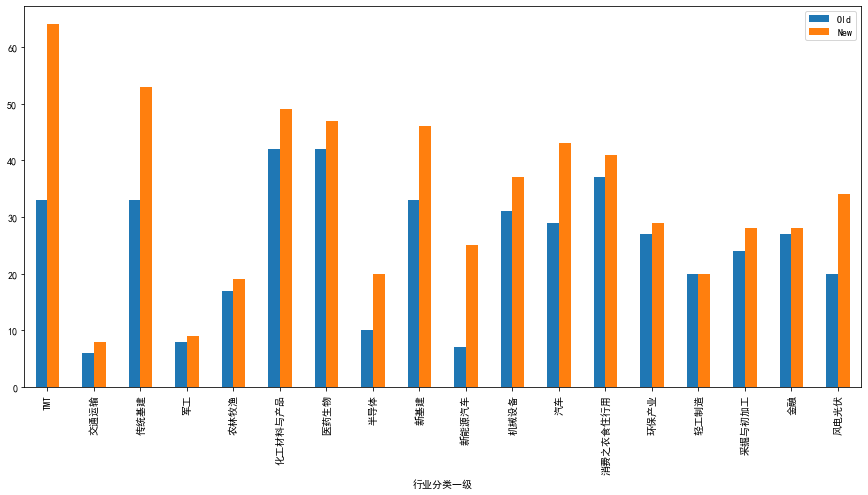

In [3149]:
#一级行业分类统计
pd.DataFrame([ht_sec_old.groupby(['行业分类一级']).count().代码,ht_sec.groupby(['行业分类一级']).count().代码],index=['Old','New']).T.plot(figsize=(15,7),kind='bar')

In [3150]:
print(ht_sec.shape)
print(len(ht_sec.代码.unique()))

(600, 4)
482


In [3151]:
ht_set = set(ht_sec.代码)
#取2021年至今的数据进行探索
code_set_2021 = set(jy2wind(list(data[(data.tday>=datetime(2021,1,1)) & (data.tday<=datetime(2023,9,1))].InnerCode.unique())).WindCode)
#32支可转债没有
#31支可转债没有
print('data有但是行业没有的：{}'.format(len(code_set_2021 - ht_set)))
print('行业有但是data没有的：{}'.format(len(ht_set - code_set_2021)))

data有但是行业没有的：105
行业有但是data没有的：62


In [3153]:
merge_code = jy2wind(list(data.InnerCode))
data_part = (cdata[(cdata.tday>=datetime(2021,1,1)) & (cdata.tday<=datetime(2023,1,20))]
       ).merge(merge_code,left_on='InnerCode',right_index=True,how='left').merge(
    ht_sec,left_on = 'WindCode',right_on='代码',how='outer').drop(columns=['代码','证券简称','行业分类']).dropna(
    subset={'行业分类一级'})
data_part = data_part.dropna(subset={'InnerCode'})

In [3154]:
data_part_dirty = (data[(data.tday>=datetime(2021,1,1)) & (data.tday<=datetime(2023,1,20))]
       ).merge(merge_code,left_on='InnerCode',right_index=True,how='left').merge(
    ht_sec,left_on = 'WindCode',right_on='代码',how='outer').drop(columns=['代码','证券简称','行业分类']).dropna(
    subset={'行业分类一级'})
data_part_dirty = data_part_dirty.dropna(subset={'InnerCode'})

In [3156]:
data[(data.tday>=datetime(2021,1,1)) & (data.tday<=datetime(2023,1,20))].shape

(162685, 37)

In [3157]:
#计算股票收益, 用行业和股票代码这两个键进行筛选，计算每只股票的收益。不能只用股票代码进行筛选，因为存在一股两行业的问题
data_part['Stock_return'] = data_part.groupby(['行业分类一级','InnerCode']).BackwardPrice.pct_change()
data_part_dirty['Stock_return'] = data_part_dirty.groupby(['行业分类一级','InnerCode']).BackwardPrice.pct_change()
def f(x):
    if abs(x)>=1:
        return 0
    else:
        return x
data_part['Stock_return'] = data_part['Stock_return'].apply(f).fillna(0)
data_part_dirty['Stock_return'] = data_part_dirty['Stock_return'].apply(f).fillna(0)

<AxesSubplot:xlabel='tday'>

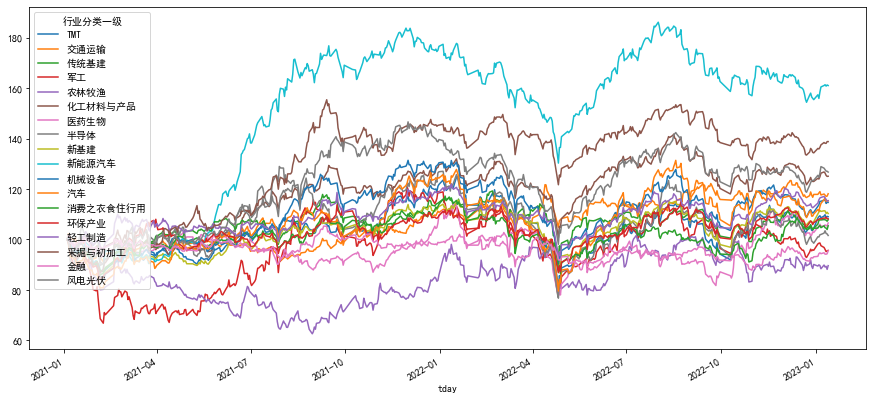

In [3158]:
#用股票收益对应的股票构建指数
indus_ret = data_part.groupby(['行业分类一级','tday']).mean().Stock_return.reset_index()#.groupby('行业分类一级').cumsum()#.cumsum().reset_index().pivot(columns='tday',index='行业分类一级'                                                                         #).T.plot(figsize=(15,7))
indus_ret['Stock_return'] = indus_ret.Stock_return.apply(f)#groupby('行业分类一级').cumsum()
indus_ret['Stock_cum_ret'] = 100*(1+indus_ret.groupby('行业分类一级').cumsum())
indus_ret.pivot(columns='tday',index='行业分类一级',values = 'Stock_cum_ret').T.plot(figsize=(15,7))


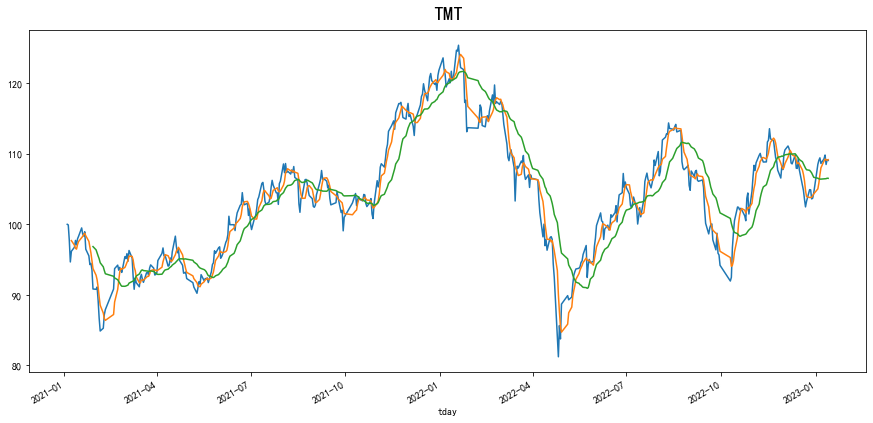

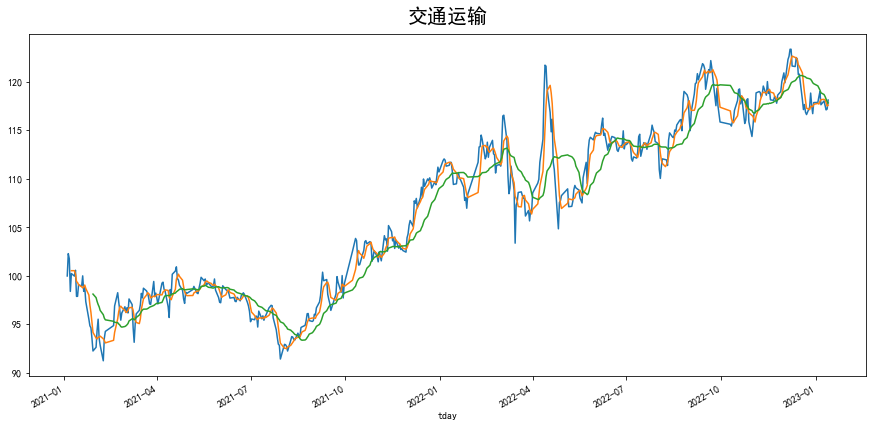

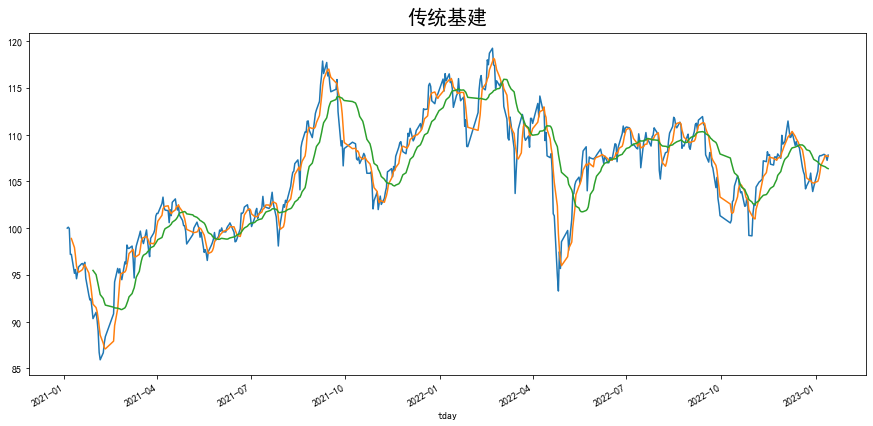

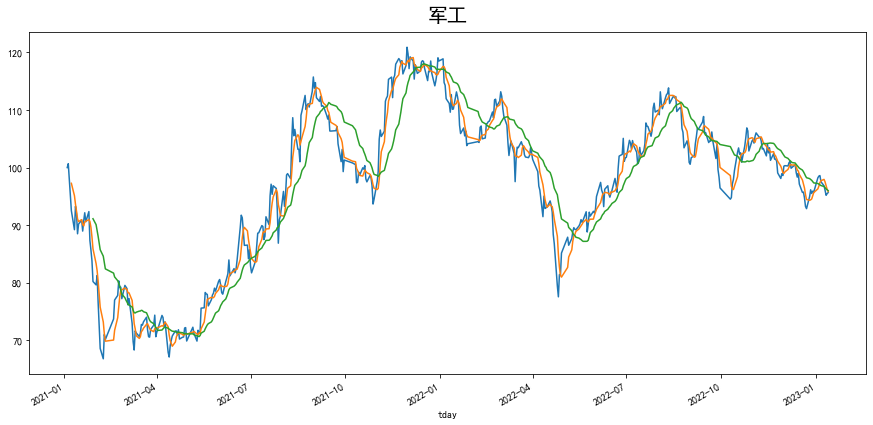

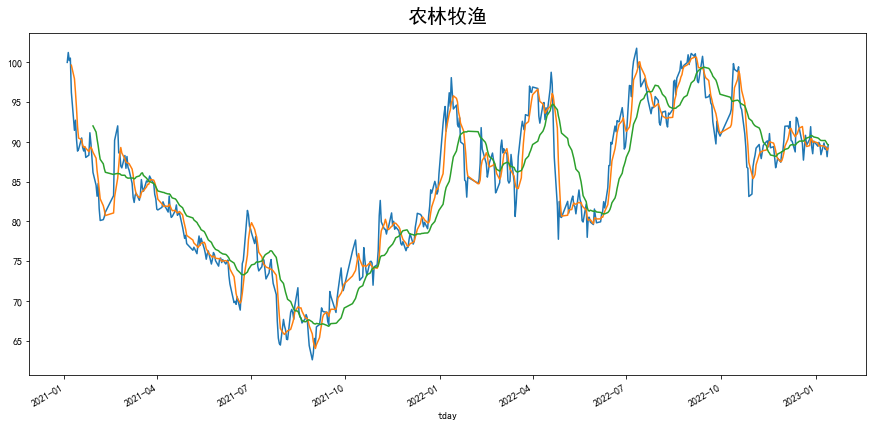

...

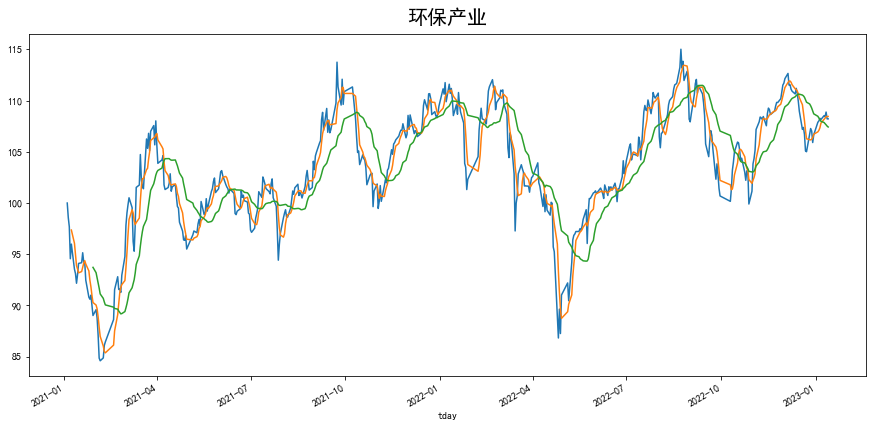

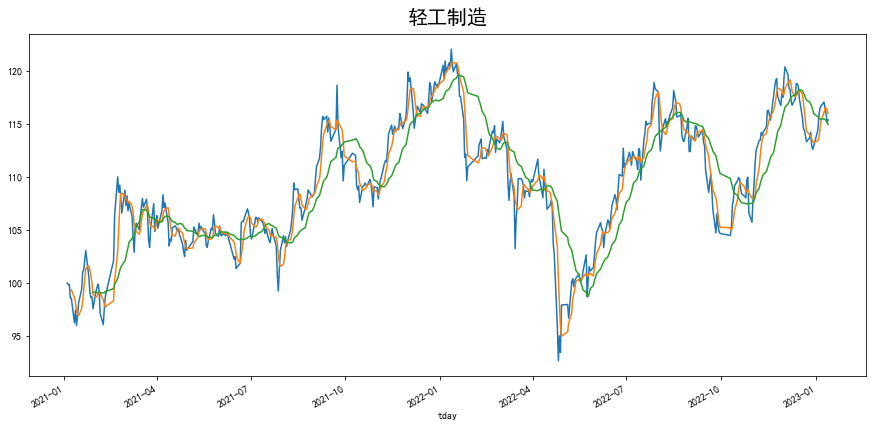

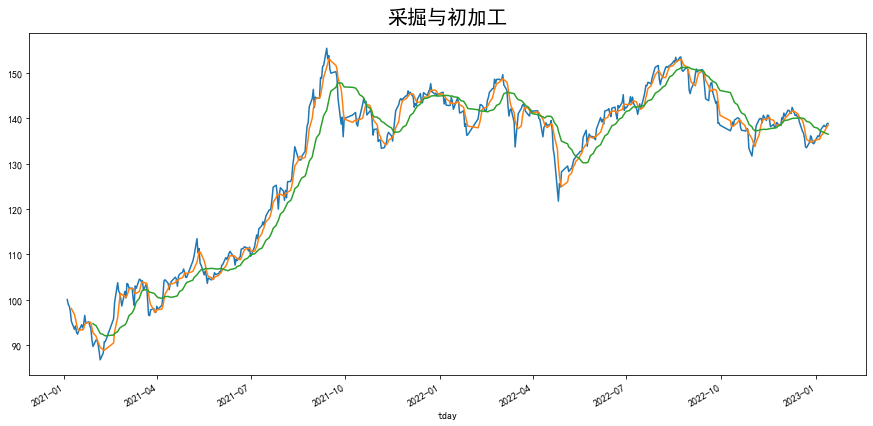

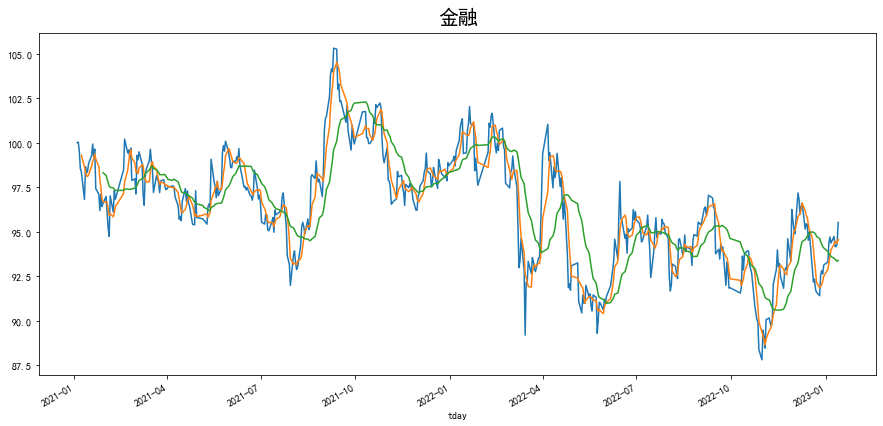

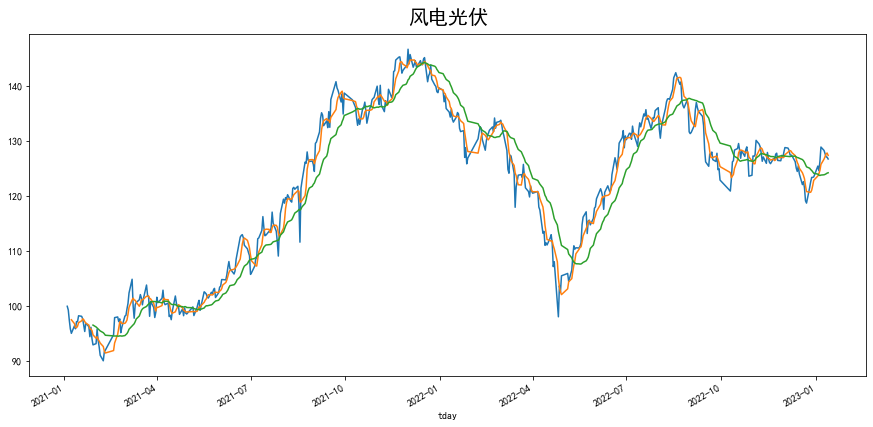

In [3159]:
#分析每个行业的指数变化情况
for i in indus_ret.行业分类一级.unique():
    Search_med = indus_ret[indus_ret['行业分类一级']==i].set_index('tday')['Stock_cum_ret']
    plt.title(i,fontsize=20,pad=10)
    Search_med.plot(figsize=(15,7))
    Search_med.rolling(window=5).mean().plot()
    Search_med.rolling(window=20).mean().plot()
    plt.show()

<AxesSubplot:xlabel='tday'>

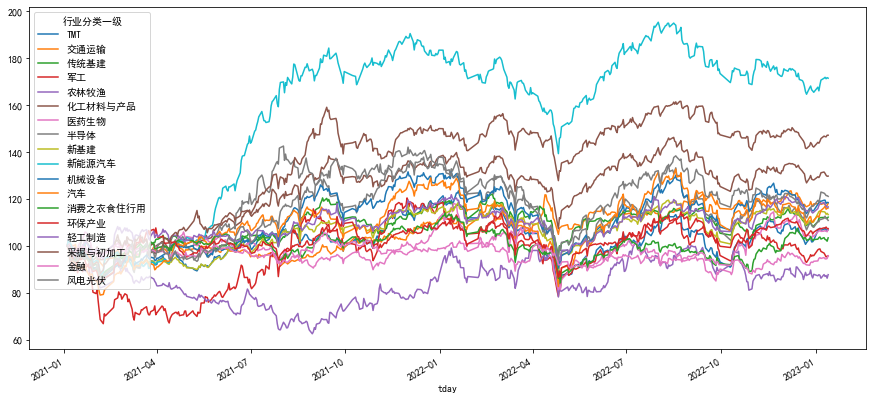

In [3160]:
#用dirty的数据覆盖clean的数据，最后用dirty来进行分析
indus_ret = data_part_dirty.groupby(['行业分类一级','tday']).mean().Stock_return.reset_index()#.groupby('行业分类一级').cumsum()#.cumsum().reset_index().pivot(columns='tday',index='行业分类一级'                                                                         #).T.plot(figsize=(15,7))
indus_ret['Stock_return'] = indus_ret.Stock_return.apply(f)#groupby('行业分类一级').cumsum()
indus_ret['Stock_cum_ret'] = 100*(1+indus_ret.groupby('行业分类一级').cumsum()).values
indus_ret['Bond_cum_ret'] = (1+data_part_dirty.groupby(['行业分类一级','tday']).mean().ChangePCT.reset_index().groupby('行业分类一级').cumsum())
indus_ret.pivot(columns='tday',index='行业分类一级',values = 'Stock_cum_ret').T.plot(figsize=(15,7))


In [3162]:
#可以画出指标的行业轮动
def draw_indus(indus_ret,factor_name,resample_period = '2M'):
    indus_ret.pivot(columns='tday',index='行业分类一级',values = factor_name).T.plot(figsize=(15,7))
    def f(x):
        return pd.Series(x.sort_values().index)
        return x
    return indus_ret.pivot(columns='tday',index='行业分类一级',values = factor_name).rank(pct=True).T.resample(resample_period).mean().apply(f,axis=1)


In [3164]:
a = pd.DataFrame([['1','2','3'],[2,3,1]]).T
b = pd.DataFrame([['1','2','3','1','8'],[2,3,1,4,5]]).T
a.merge(b,on=0,how='outer')

,0,1_x,1_y
0,1,2,2
1,1,2,4
2,2,3,3
3,3,1,1
4,8,NaN,5


array([[<AxesSubplot:title={'center':'count'}>]], dtype=object)

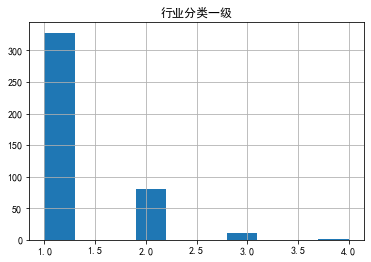

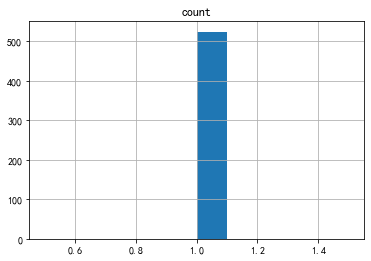

In [3194]:
#很明显，存在一个债券对应多个行业的情况
data_part_dirty[['行业分类一级','InnerCode']].drop_duplicates().groupby('InnerCode').count().hist()
#用行业债券两个键，这个问题就不存在了
temp = data_part_dirty[['行业分类一级','InnerCode','InnerCode']]
temp.columns = ['行业分类一级','InnerCode','count']
temp.drop_duplicates().groupby(['行业分类一级','InnerCode']).count().hist()

In [3166]:
#用另一种方式计算指数，先计算指标再平均
data_for_cal = data_part_dirty[['行业分类一级','InnerCode','tday','BackwardPrice']]
data_for_cal['MA_5'] = data_for_cal.groupby(['行业分类一级','InnerCode']).BackwardPrice.rolling(window=5,min_periods=1).mean().values
data_for_cal['MA_20'] = data_for_cal.groupby(['行业分类一级','InnerCode']).BackwardPrice.rolling(window=20,min_periods=1).mean().values
data_for_cal['MA_60'] = data_for_cal.groupby(['行业分类一级','InnerCode']).BackwardPrice.rolling(window=60,min_periods=1).mean().values
data_for_cal['MA_80'] = data_for_cal.groupby(['行业分类一级','InnerCode']).BackwardPrice.rolling(window=80,min_periods=1).mean().values
data_for_cal['MA5_20'] = data_for_cal['MA_5']/data_for_cal['MA_20']
data_for_cal['MA20_80'] = data_for_cal['MA_20']/data_for_cal['MA_80']
data_for_cal['MA20_60'] = data_for_cal['MA_20']/data_for_cal['MA_60']
data_for_cal['Bull_signal'] = (data_for_cal['MA_5']>data_for_cal['MA_20']).replace(False,np.nan)
data_for_cal['DIFF_20_80'] = data_for_cal['MA_20'] - data_for_cal['MA_80']
data_for_cal['DEA_20'] = data_for_cal.groupby(['行业分类一级']).DIFF_20_80.rolling(window=20,min_periods = 1).mean().values
data_for_cal['MACD'] = data_for_cal['DIFF_20_80'] - data_for_cal['DEA_20']
indus_ret2 = data_for_cal.groupby(['行业分类一级','tday']).mean()[['MA5_20','MA20_80','MA20_60','MACD']].reset_index()#.groupby('行业分类一级').cumsum()#.cumsum().reset_index().pivot(columns='tday',index='行业分类一级'


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
tday,,,,,,,,,,,,,,,,,,
2021-01-31,金融,交通运输,TMT,新能源汽车,采掘与初加工,机械设备,新基建,风电光伏,汽车,环保产业,传统基建,消费之衣食住行用,轻工制造,半导体,化工材料与产品,医药生物,农林牧渔,军工
2021-03-31,交通运输,医药生物,金融,机械设备,采掘与初加工,军工,环保产业,风电光伏,消费之衣食住行用,汽车,新基建,传统基建,新能源汽车,农林牧渔,TMT,化工材料与产品,轻工制造,半导体
2021-05-31,采掘与初加工,新基建,传统基建,环保产业,新能源汽车,交通运输,风电光伏,机械设备,金融,军工,医药生物,化工材料与产品,轻工制造,TMT,半导体,汽车,农林牧渔,消费之衣食住行用
2021-07-31,采掘与初加工,半导体,轻工制造,医药生物,化工材料与产品,新能源汽车,传统基建,交通运输,TMT,新基建,金融,机械设备,消费之衣食住行用,军工,汽车,环保产业,风电光伏,农林牧渔
2021-09-30,机械设备,交通运输,军工,新能源汽车,传统基建,汽车,金融,农林牧渔,环保产业,风电光伏,化工材料与产品,消费之衣食住行用,新基建,半导体,轻工制造,采掘与初加工,TMT,医药生物
2021-11-30,风电光伏,轻工制造,金融,新基建,化工材料与产品,交通运输,机械设备,新能源汽车,环保产业,半导体,农林牧渔,采掘与初加工,传统基建,消费之衣食住行用,医药生物,TMT,汽车,军工
2022-01-31,采掘与初加工,新能源汽车,半导体,轻工制造,化工材料与产品,传统基建,TMT,环保产业,新基建,农林牧渔,医药生物,汽车,风电光伏,消费之衣食住行用,金融,机械设备,军工,交通运输
2022-03-31,环保产业,传统基建,风电光伏,新基建,消费之衣食住行用,汽车,机械设备,TMT,农林牧渔,医药生物,采掘与初加工,半导体,军工,新能源汽车,化工材料与产品,金融,轻工制造,交通运输
2022-05-31,新能源汽车,化工材料与产品,消费之衣食住行用,半导体,新基建,医药生物,风电光伏,传统基建,采掘与初加工,TMT,交通运输,金融,机械设备,汽车,农林牧渔,环保产业,轻工制造,军工


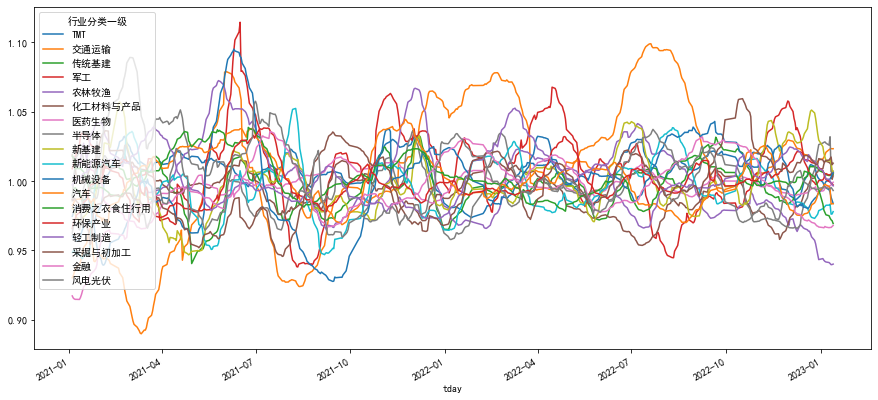

In [3167]:
draw_indus(indus_ret2,'MA20_80','2M')

In [3218]:
merge_code = jy2wind(list(data.InnerCode))

data_part = (cdata[(cdata.tday>=datetime(2021,1,1)) & (cdata.tday<=datetime(2023,1,20))]
       ).merge(merge_code,left_on='InnerCode',right_index=True,how='left').merge(
    ht_sec,left_on = 'WindCode',right_on='代码',how='outer').drop(columns=['代码','证券简称','行业分类']).dropna(
    subset={'行业分类一级'})
data_part = data_part.dropna(subset={'InnerCode'})
data_part['ChangePCT_shift'] = data_part.groupby(['行业分类一级','InnerCode']).ChangePCT.shift(-1).values
print(data_part.shape)

(175524, 49)


In [3316]:
#计算收益
def cal_performance(data_for_bt,fac_name,quantile=0.02):
    data_temp = data_for_bt[['行业分类一级','InnerCode','WindCode','ChiName','ChangePCT','tday',fac_name]]
    data_temp[fac_name] = data_temp.groupby('tday')[fac_name].rank(pct=True,method='dense')
    data_temp['sig_ma'] = (data_temp[fac_name] < quantile).replace(False,np.nan)
    data_temp['shift_sig'] = data_temp.groupby('InnerCode')['sig_ma'].shift(1)
    data_temp['hld_sig'] = data_temp.groupby('InnerCode')['shift_sig'].ffill(limit=4)
    data_temp['ChangePCT'] = data_temp['ChangePCT']/100
    data_temp['hld_ret'] = data_temp['hld_sig']*data_temp['ChangePCT']
    
    data_temp.groupby('tday')['ChangePCT'].mean().cumsum().plot()
    data_temp.groupby('tday')['hld_ret'].mean().cumsum().plot()
    shp  = np.sqrt(252)*data_temp.groupby('tday')['hld_ret'].mean().mean()/data_temp.groupby('tday')['hld_ret'].mean().std()
    plt.title(fac_name,fontsize=15,pad=10)
    plt.legend(['Index','Strategy'])
    plt.show()

    return data_temp,shp

def filter_indus(x,args):
    thres,direction = args[0],args[1]
    if direction == -1:
        try:
            thres = x.sort_values().unique()[-3]
        except:
            thres=x.max()
        return (x<=thres).replace(False,np.nan)
    else:
        try:
            thres = x.sort_values().unique()[3]
        except:
            thres=x.min()
        return (x>=thres).replace(False,np.nan)


In [3317]:
bond_arg,indus_arg,bond_direction,ind_direction,out_indus_num = [1,5],[5,20],1,1,3

In [3368]:
def brutal_search(bond_arg,indus_arg,bond_direction,ind_direction,out_indus_num=3,wb=0.5,wi=0.5):
    print(bond_arg,indus_arg,bond_direction,ind_direction,out_indus_num)
    #加入债市因子
    data['fac_bond'] = - bond_direction * data.ClosePrice.rolling(window=bond_arg[0],min_periods=1).mean()/data.ClosePrice.rolling(window=bond_arg[1],min_periods=1).mean()
    data_part = (cdata[(cdata.tday>=datetime(2021,1,1)) & (cdata.tday<=datetime(2023,1,20))]
           ).merge(merge_code,left_on='InnerCode',right_index=True,how='left').merge(
        ht_sec,left_on = 'WindCode',right_on='代码',how='outer').drop(columns=['代码','证券简称','行业分类']).dropna(
        subset={'行业分类一级'})
    data_part = data_part.dropna(subset={'InnerCode'})
    data_part['ChangePCT_shift'] = data_part.groupby(['行业分类一级','InnerCode']).ChangePCT.shift(-1).values
    data_part = data_part.merge(data[['InnerCode','tday','fac_bond']],how='left')
    #print(data_part.shape)

    #获得行业的指数
    indus_ret = data_part_dirty.groupby(['行业分类一级','tday']).mean().Stock_return.reset_index()#.groupby('行业分类一级').cumsum()#.cumsum().reset_index().pivot(columns='tday',index='行业分类一级'                                                                         #).T.plot(figsize=(15,7))
    def f(x):
        if abs(x)>=1:
            return 0
        else:
            return x
    indus_ret['Stock_return'] = indus_ret.Stock_return.apply(f)#groupby('行业分类一级').cumsum()
    indus_ret['Stock_cum_ret'] = 100*(1+indus_ret.groupby('行业分类一级').cumsum()).values
    indus_ret['Bond_cum_ret'] = (1+data_part_dirty.groupby(['行业分类一级','tday']).mean().ChangePCT.reset_index().groupby('行业分类一级').cumsum())
    #计算相应的行业指数指标，方法为利用行业净值曲线直接进行MA指标的构建
    indus_ret['MA_a'] = indus_ret.groupby(['行业分类一级']).Stock_cum_ret.rolling(window=indus_arg[0],min_periods = 1).mean().values
    indus_ret['MA_b'] = indus_ret.groupby(['行业分类一级']).Stock_cum_ret.rolling(window=indus_arg[1],min_periods = 1).mean().values
    indus_ret['fac_indus'] = - ind_direction * indus_ret['MA_a']/indus_ret['MA_b']
    #indus_ret['MA_60'] = indus_ret.groupby(['行业分类一级']).Stock_cum_ret.rolling(window=60,min_periods = 1).mean().values
    #indus_ret['MA_80'] = indus_ret.groupby(['行业分类一级']).Stock_cum_ret.rolling(window=80,min_periods = 1).mean().values
    #indus_ret['MA5_20'] = indus_ret['MA_5']/indus_ret['MA_20']
    #indus_ret['MA20_80'] = indus_ret['MA_20']/indus_ret['MA_80']
    #indus_ret['MA20_60'] = indus_ret['MA_20']/indus_ret['MA_60']
    #indus_ret['DIFF_20_80'] = indus_ret['MA_20'] - indus_ret['MA_80']
    #indus_ret['DEA_20'] = indus_ret.groupby(['行业分类一级']).DIFF_20_80.rolling(window=20,min_periods = 1).mean().values
    #indus_ret['MACD'] = indus_ret['DIFF_20_80'] - indus_ret['DEA_20']
    #indus_ret['Bull_signal'] = (indus_ret.groupby(['行业分类一级']).Bond_cum_ret.rolling(window=20,min_periods = 1).mean()
    #                            >indus_ret.groupby(['行业分类一级']).Bond_cum_ret.rolling(window=40,min_periods = 1).mean()).replace(False,np.nan).values

    #draw_indus(indus_ret,'MA20_60','2M')
    #将行业指数merge到原来的数据上
    data_for_bt = data_part[['fac_bond','InnerCode','ChiName','WindCode','ChangePCT','ChangePCT_shift','行业分类一级','tday']].merge(
        indus_ret.drop(columns = ['Stock_return','Stock_cum_ret']),on=['行业分类一级','tday'],how='left')
    #对于对应多个行业的债券，计算指标的平均
    data_for_bt_pro = data_for_bt.groupby(['InnerCode','tday']).mean().reset_index()
    #上一步会忽略行业，因此这里再进行匹配，将对应多个行业的债券的行业串联作为其行业标签
    def get_indus(x):
        ret_df = x[['InnerCode','tday']]
        ret_df['ChiName'] = x.ChiName.unique()[0]
        ret_df['WindCode'] = x.WindCode.unique()[0]
        ret_df['行业分类一级'] = ' '.join(x.行业分类一级.value_counts().index)#) for i in range(ret_df.shape[0])]
        ret_df['行业分类简洁'] = (x.行业分类一级.value_counts().sort_values().index[-1])# for i in range(ret_df.shape[0])]
        #return ret_df.drop_duplicates()
        return ret_df
    data_industry = data_for_bt.groupby('InnerCode').apply(get_indus)#.drop_duplicates(subset={'InnerCode','tday'})
    data_industry = data_industry.drop_duplicates()
    #加上行业标签
    data_for_bt_pro = data_for_bt_pro.merge(data_industry,on=['InnerCode','tday'])

    #构造因子
    data_for_bt_pro['New_fac'] = wb*data_for_bt_pro.groupby('tday')['fac_bond'].rank(pct=True)+\
                            wi*data_for_bt_pro.groupby('tday')['fac_indus'].rank(pct=True)
    #回测
    dt_rev,shp_rev = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)
    #回测
    data_for_bt_pro['Ind_mask'] = data_for_bt_pro.groupby('tday')['fac_indus'].apply(filter_indus,(out_indus_num,ind_direction))
    data_for_bt_pro['New_fac'] = data_for_bt_pro['Ind_mask']*data_for_bt_pro['fac_bond']
    dt_rev_filter,shp_rev_fil = cal_performance(data_for_bt_pro,'New_fac',quantile=0.05)
    return shp_rev,shp_rev_fil

[1, 5] [1, 5] -1 -1 3


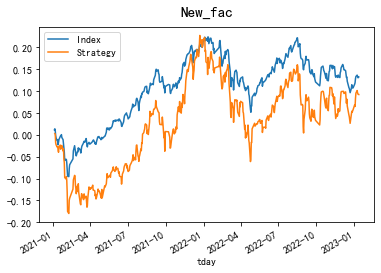

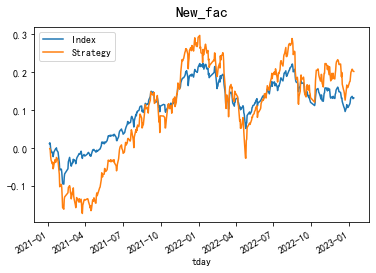

0.2160508939496097 0.45203497091104455
[1, 5] [1, 5] -1 1 3


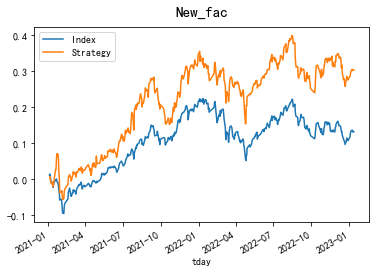

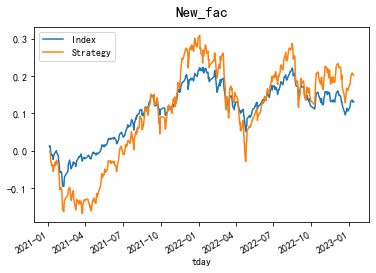

0.8104695144316841 0.4508574079093625
[1, 5] [1, 5] 1 -1 3


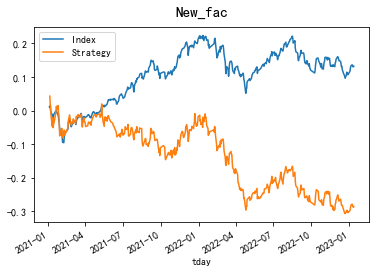

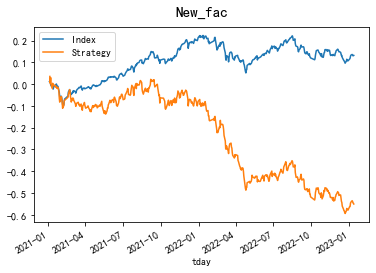

-0.806377066227506 -1.3679311329642947
[1, 5] [1, 5] 1 1 3


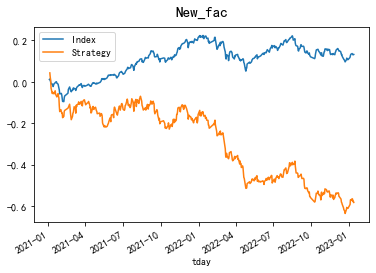

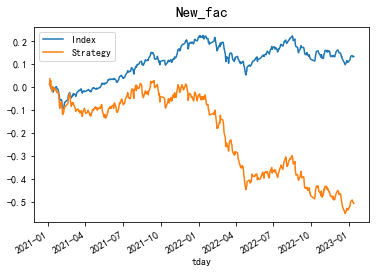

-1.4043331240001908 -1.2664930770499596
[1, 5] [1, 10] -1 -1 3


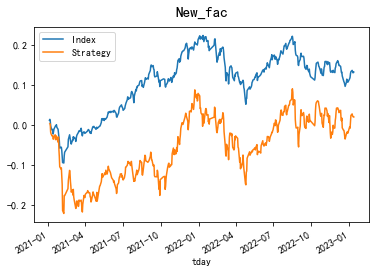

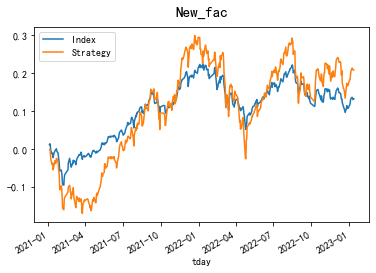

0.04654484290162161 0.4647884110917727
[1, 5] [1, 10] -1 1 3


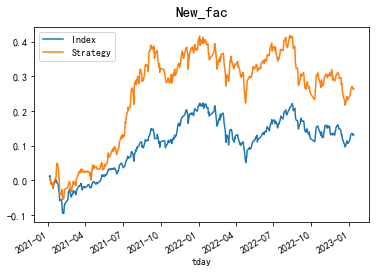

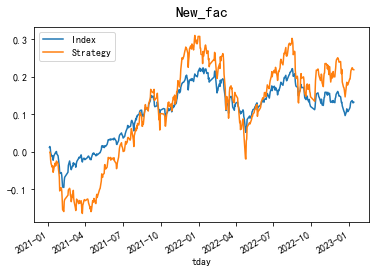

0.7038905063301195 0.48575753765407526
[1, 5] [1, 10] 1 -1 3


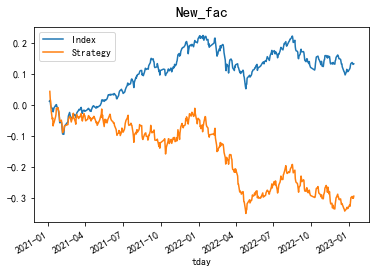

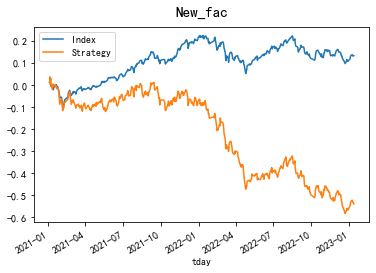

-0.8832792800409046 -1.3513711757221756
[1, 5] [1, 10] 1 1 3


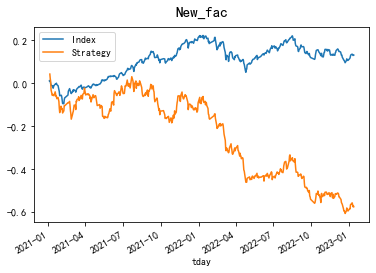

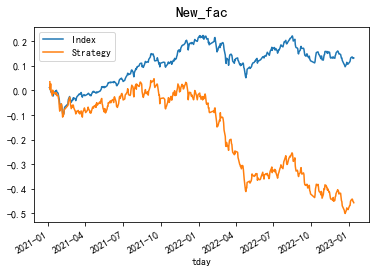

-1.3112198885115736 -1.1627025194317337
[1, 5] [5, 10] -1 -1 3


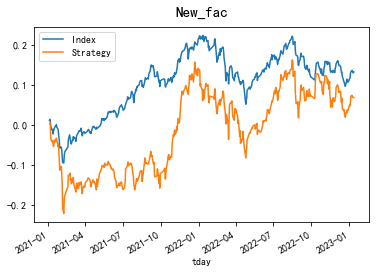

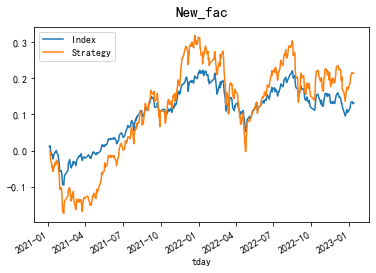

0.16208312210831397 0.48132530281478264
[1, 5] [5, 10] -1 1 3


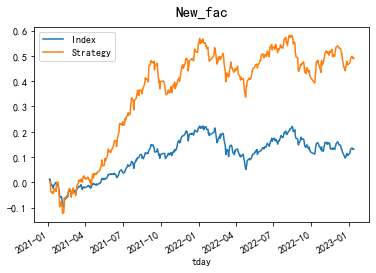

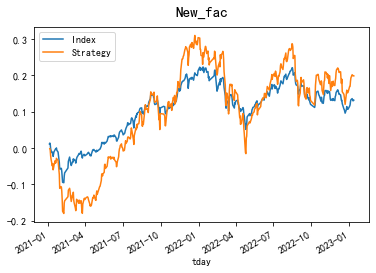

1.1550212177444286 0.4454940999208307
[1, 5] [5, 10] 1 -1 3


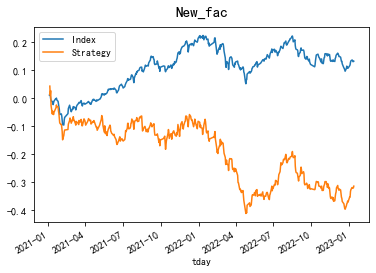

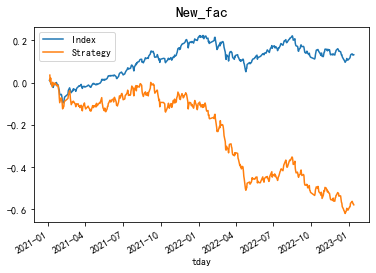

-0.8429020728560448 -1.4550983205489756
[1, 5] [5, 10] 1 1 3


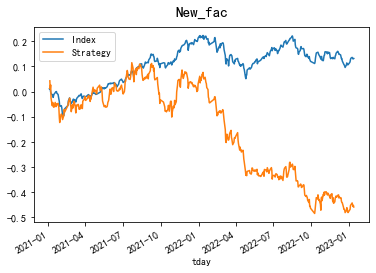

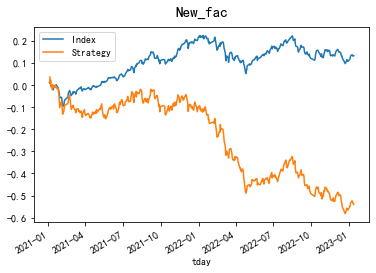

-0.9846671807803186 -1.356519208435278
[1, 5] [5, 20] -1 -1 3


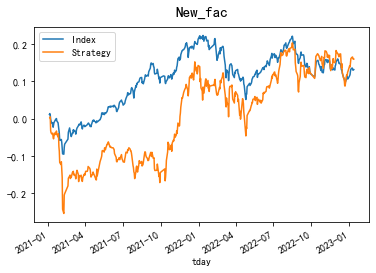

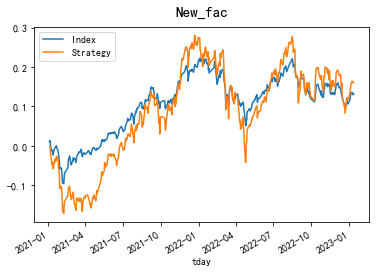

0.38832475246195347 0.3589361656252853
[1, 5] [5, 20] -1 1 3


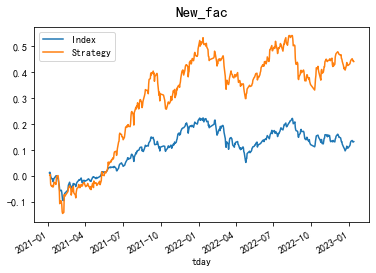

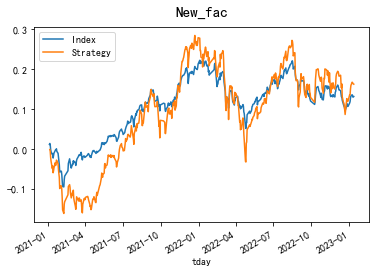

1.0131704215606832 0.3637776878284181
[1, 5] [5, 20] 1 -1 3


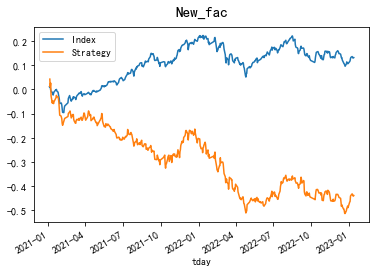

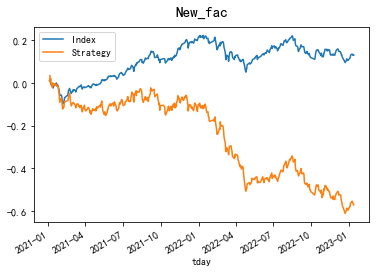

-1.2013344106511772 -1.4412919857071398
[1, 5] [5, 20] 1 1 3


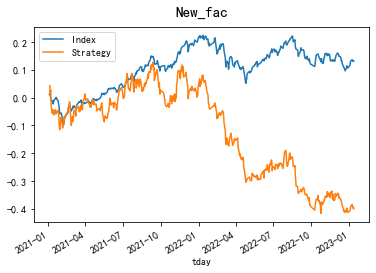

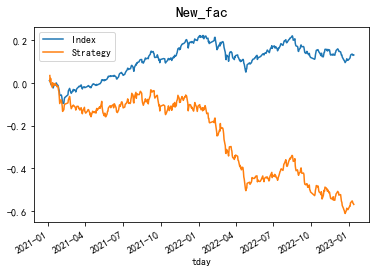

-0.8407887138059837 -1.4342169144442811
[1, 5] [20, 40] -1 -1 3


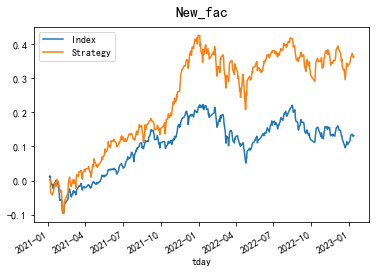

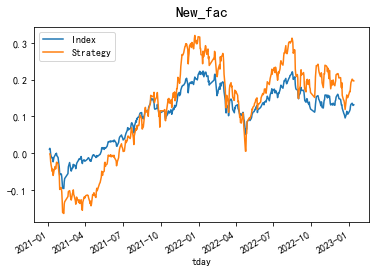

0.9414702638187451 0.4440501217044218
[1, 5] [20, 40] -1 1 3


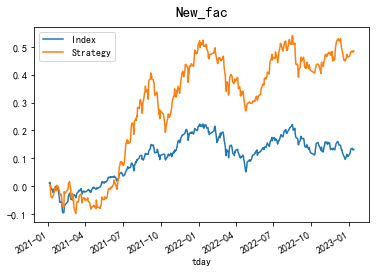

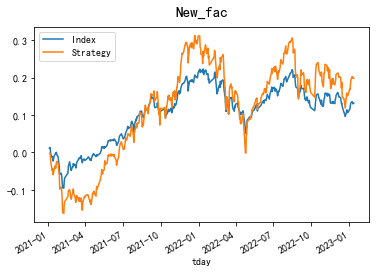

1.0875052563738228 0.44447438513028975
[1, 5] [20, 40] 1 -1 3


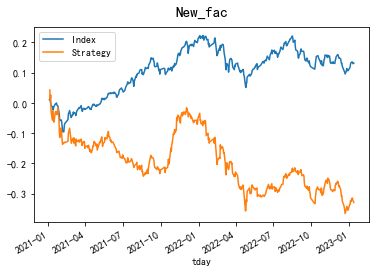

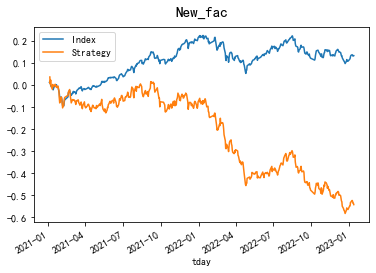

-0.8625978423286721 -1.351560374556689
[1, 5] [20, 40] 1 1 3


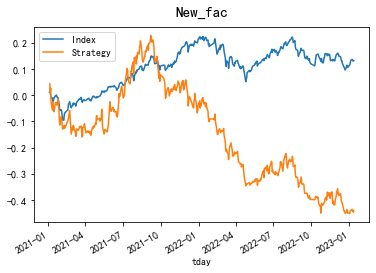

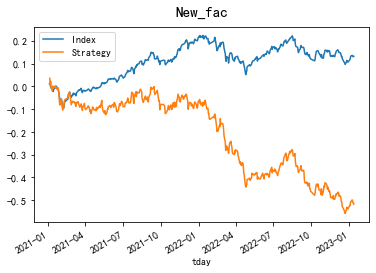

-0.8787627990251908 -1.293442803688627
[1, 5] [20, 60] -1 -1 3


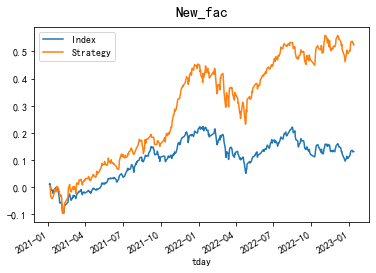

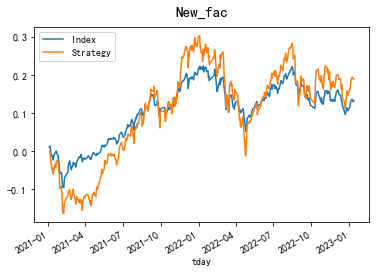

1.3533886915179596 0.4276024051639725
[1, 5] [20, 60] -1 1 3


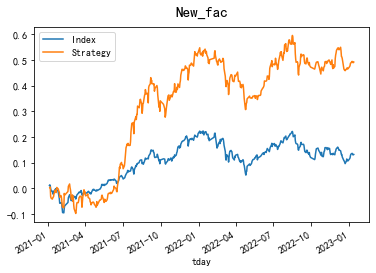

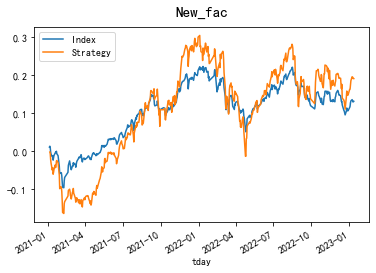

1.0772718035694933 0.4325423325717165
[1, 5] [20, 60] 1 -1 3


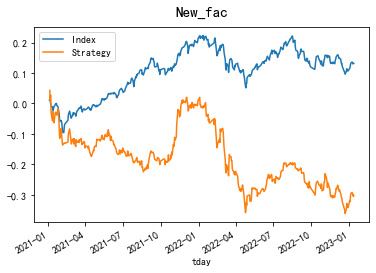

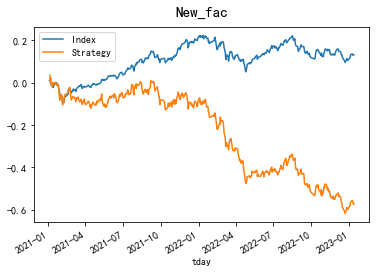

-0.7742378471823322 -1.4299664953411066
[1, 5] [20, 60] 1 1 3


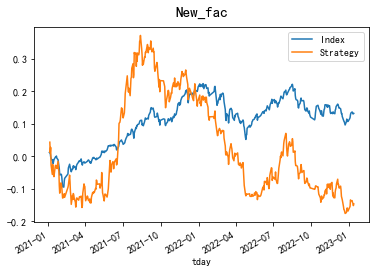

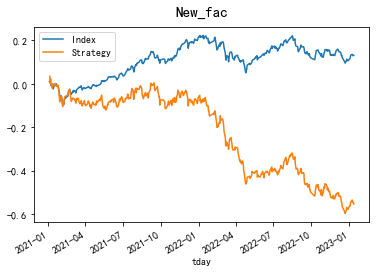

-0.2821161681849593 -1.3787611776650035
[1, 5] [40, 80] -1 -1 3


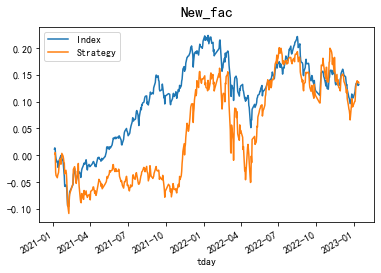

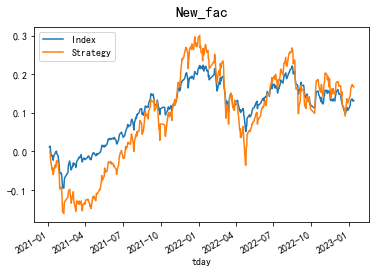

0.3440436083718983 0.3813012572522233
[1, 5] [40, 80] -1 1 3


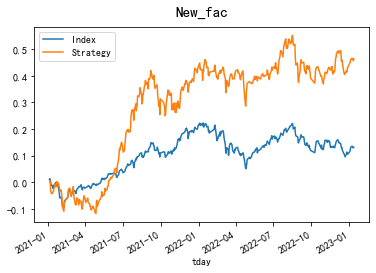

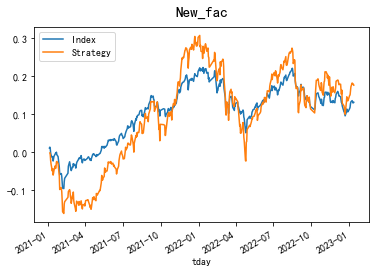

0.9597488693394085 0.4027311281330461
[1, 5] [40, 80] 1 -1 3


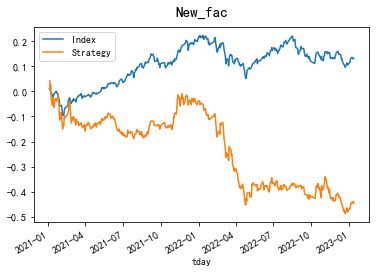

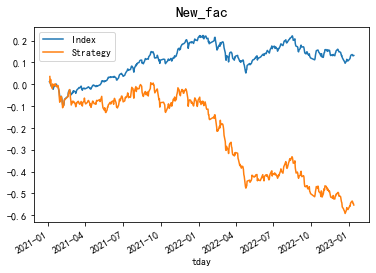

-1.1081180998536646 -1.3884001674992688
[1, 5] [40, 80] 1 1 3


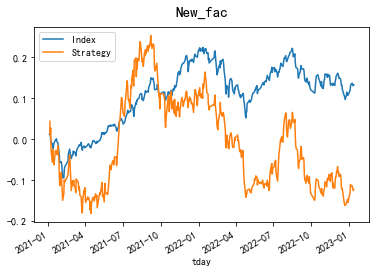

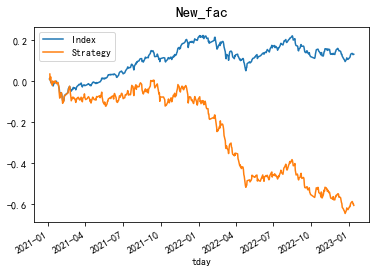

-0.23374164870627084 -1.5183822272971204
[1, 5] [60, 120] -1 -1 3


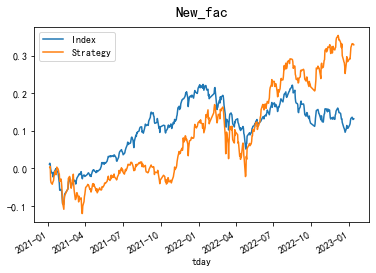

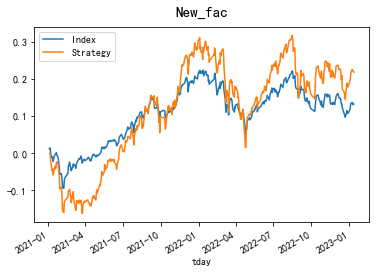

0.8790650184436134 0.4980273786702023
[1, 5] [60, 120] -1 1 3


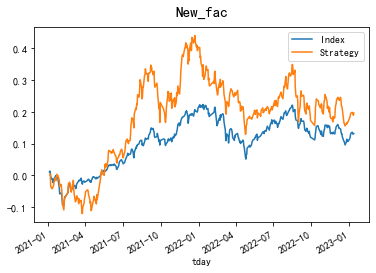

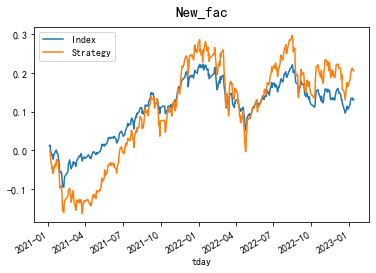

0.3931122182326038 0.4732006053437087
[1, 5] [60, 120] 1 -1 3


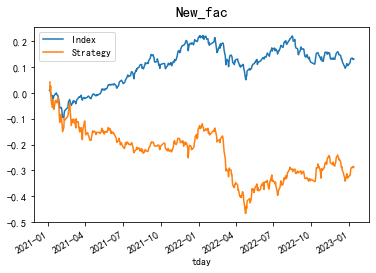

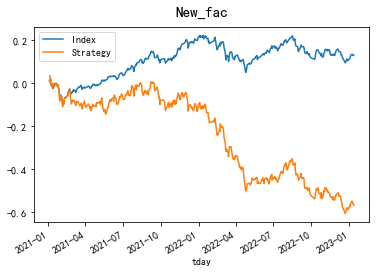

-0.7398921677321754 -1.4082866929425442
[1, 5] [60, 120] 1 1 3


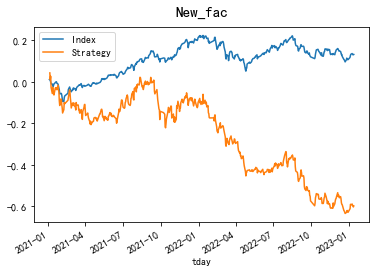

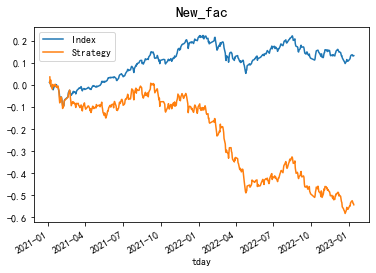

-1.1361678484370015 -1.3626574564702107
[1, 10] [1, 5] -1 -1 3


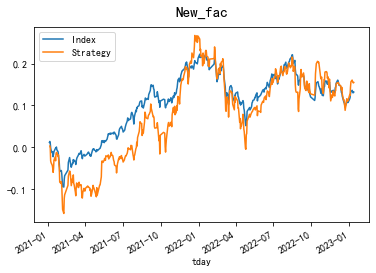

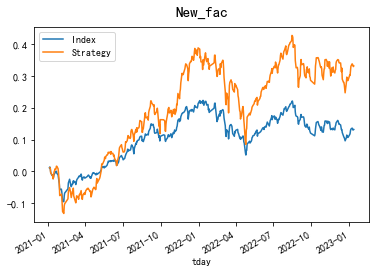

0.369060724554028 0.7392639112033886
[1, 10] [1, 5] -1 1 3


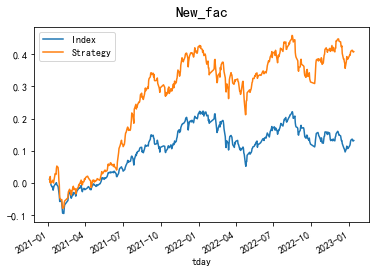

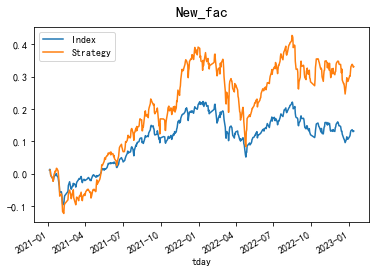

1.154028165467636 0.7379684533839914
[1, 10] [1, 5] 1 -1 3


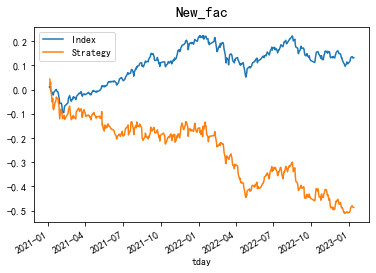

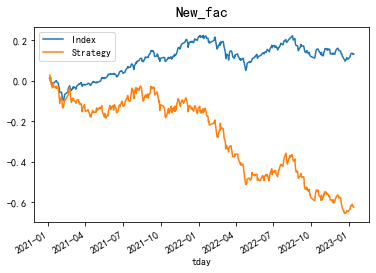

-1.2255065775067917 -1.4472413118442655
[1, 10] [1, 5] 1 1 3


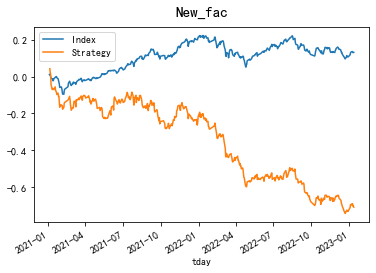

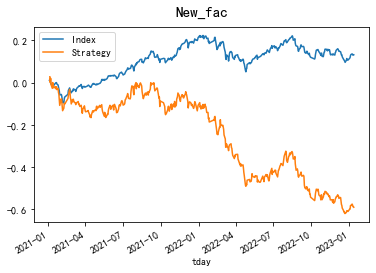

-1.642458224693575 -1.3701113381027312
[1, 10] [1, 10] -1 -1 3


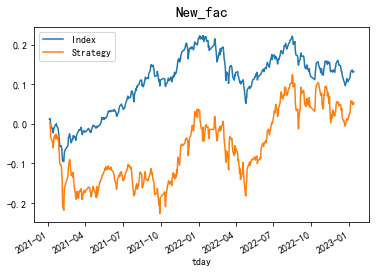

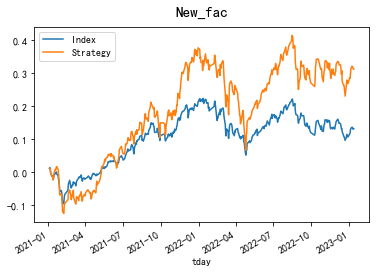

0.12098041849569702 0.7005212920554905
[1, 10] [1, 10] -1 1 3


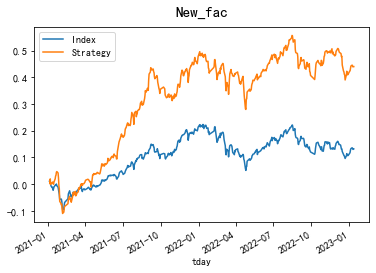

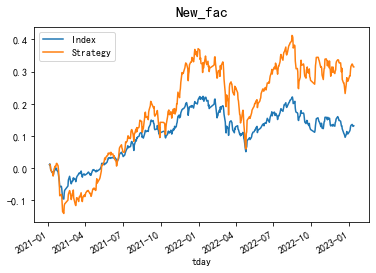

1.1687503747021584 0.6989314932846955
[1, 10] [1, 10] 1 -1 3


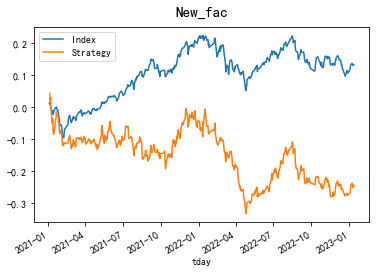

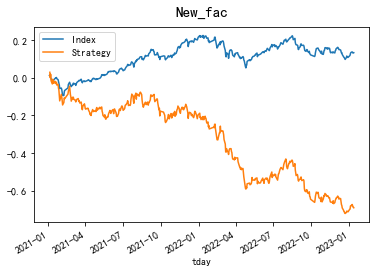

-0.6268096146624489 -1.6237232248057722
[1, 10] [1, 10] 1 1 3


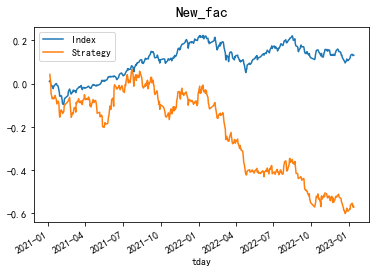

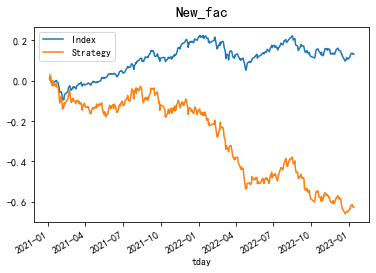

-1.1872529327891586 -1.4957281547453969
[1, 10] [5, 10] -1 -1 3


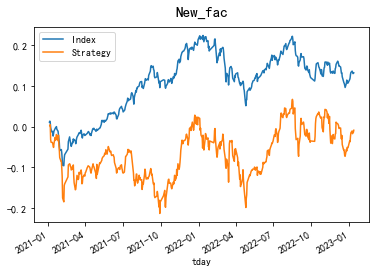

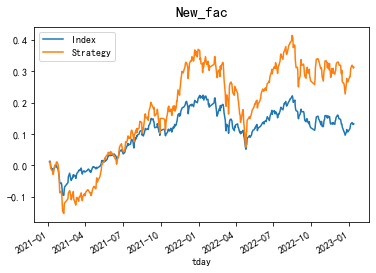

-0.020880042628473698 0.6974121475406007
[1, 10] [5, 10] -1 1 3


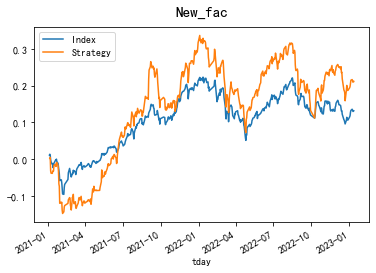

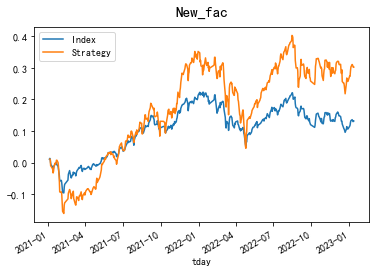

0.5342344333998575 0.6724577078297861
[1, 10] [5, 10] 1 -1 3


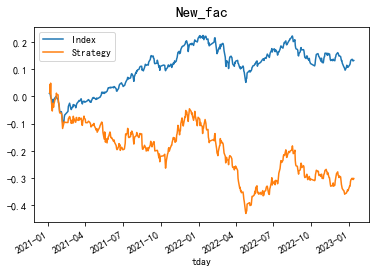

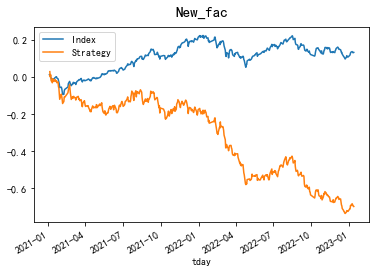

-0.7518032248636966 -1.6553380266327649
[1, 10] [5, 10] 1 1 3


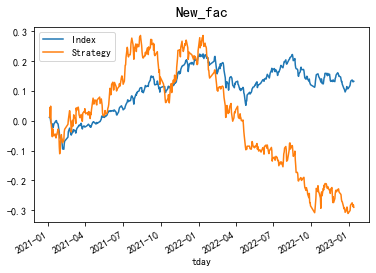

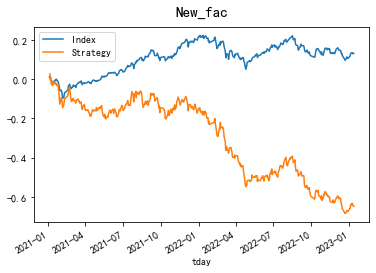

-0.5644955658365669 -1.5250670480068678
[1, 10] [5, 20] -1 -1 3


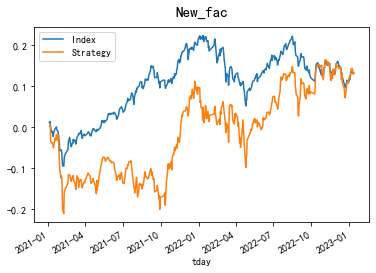

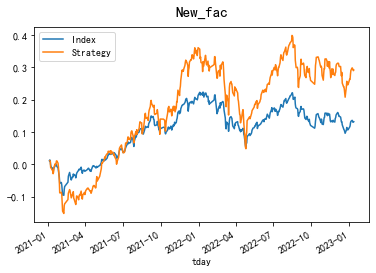

0.31590362460098365 0.6532895852456846
[1, 10] [5, 20] -1 1 3


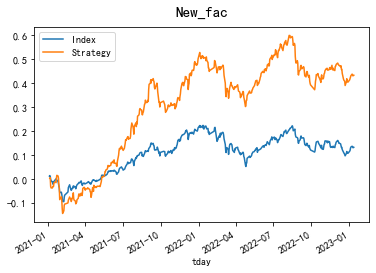

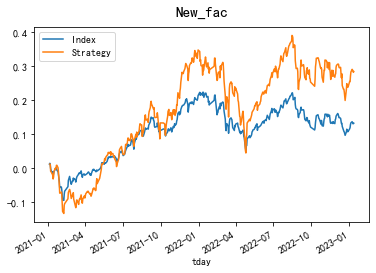

1.0688410263542383 0.6375749208682564
[1, 10] [5, 20] 1 -1 3


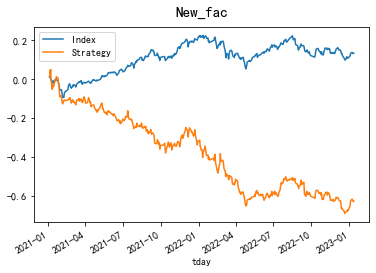

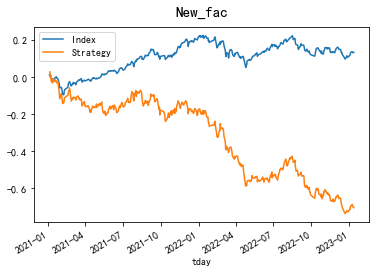

-1.5477760896255892 -1.6706089426835744
[1, 10] [5, 20] 1 1 3


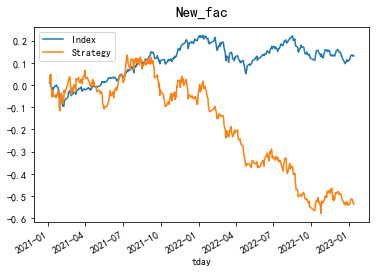

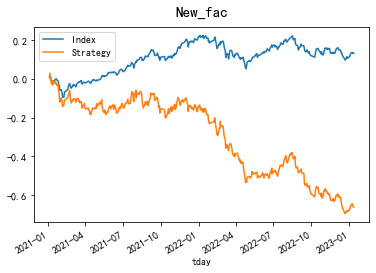

-1.0245694379231012 -1.5839030980708213
[1, 10] [20, 40] -1 -1 3


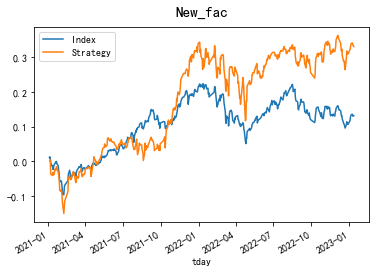

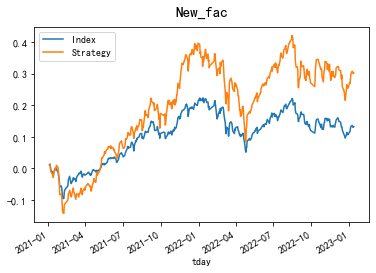

0.8137595985786065 0.6708868924508959
[1, 10] [20, 40] -1 1 3


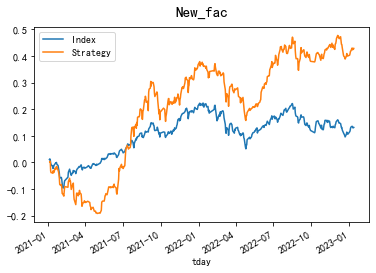

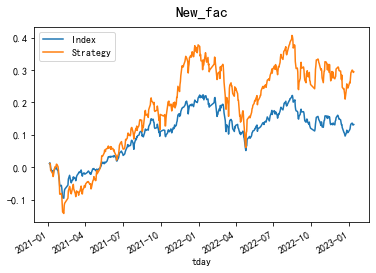

1.0000241696252923 0.6492636225295927
[1, 10] [20, 40] 1 -1 3


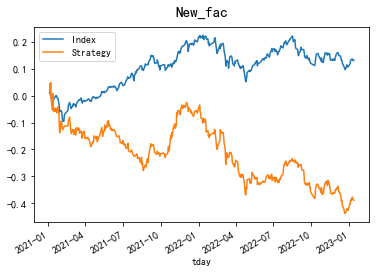

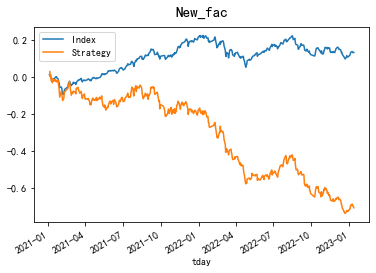

-0.9249876780804681 -1.6561049444903602
[1, 10] [20, 40] 1 1 3


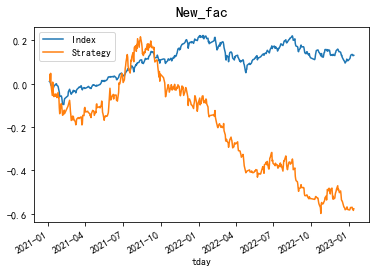

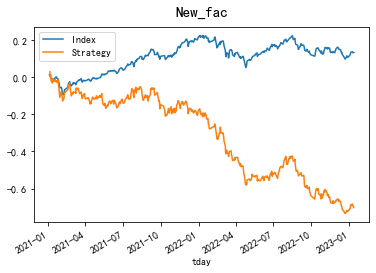

-1.0278369753889192 -1.643712900233616
[1, 10] [20, 60] -1 -1 3


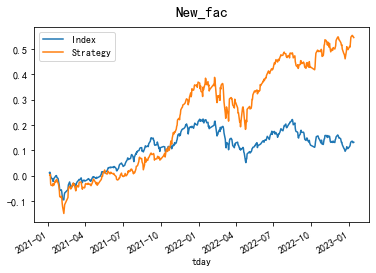

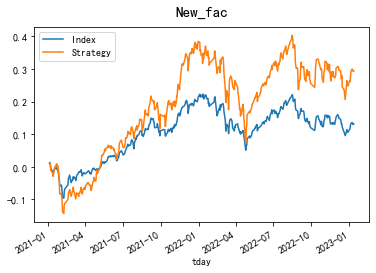

1.3842315652008133 0.6527925644385444
[1, 10] [20, 60] -1 1 3


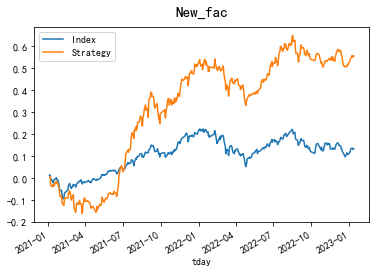

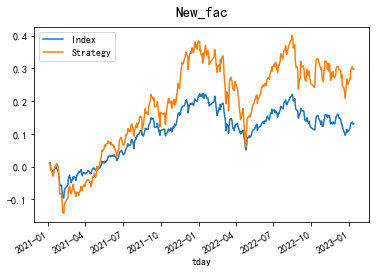

1.2591660704864887 0.657220607630284
[1, 10] [20, 60] 1 -1 3


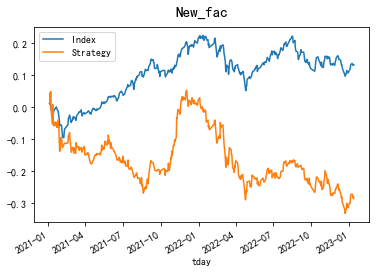

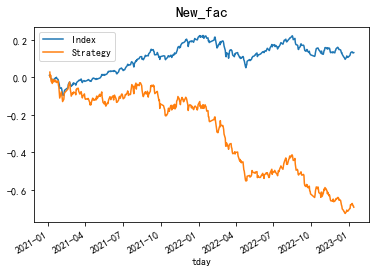

-0.6811430564809247 -1.6236508839206314
[1, 10] [20, 60] 1 1 3


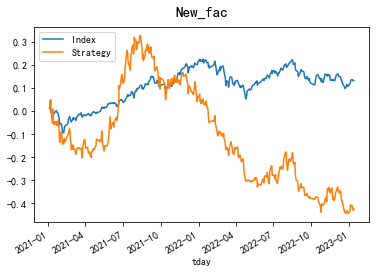

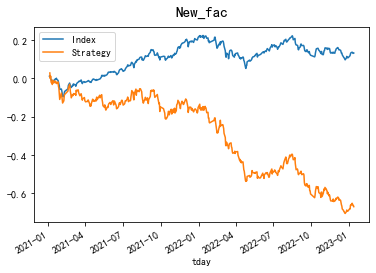

-0.7152039915515698 -1.5825268999548021
[1, 10] [40, 80] -1 -1 3


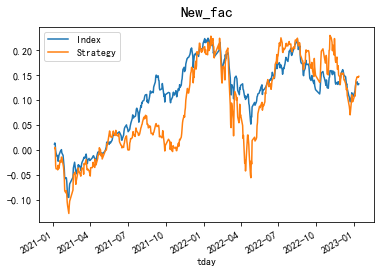

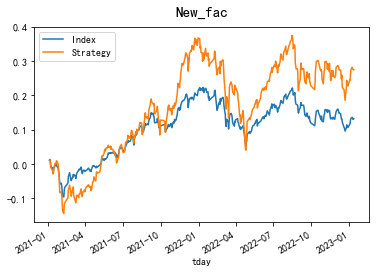

0.3720680131105994 0.6168148427807998
[1, 10] [40, 80] -1 1 3


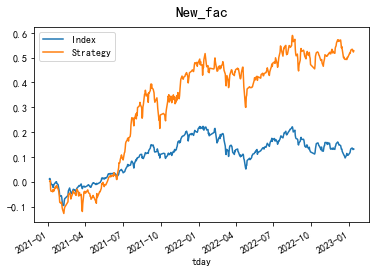

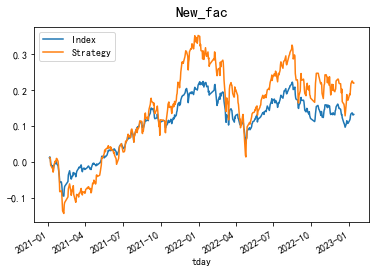

1.1124963394794876 0.4914500646065011
[1, 10] [40, 80] 1 -1 3


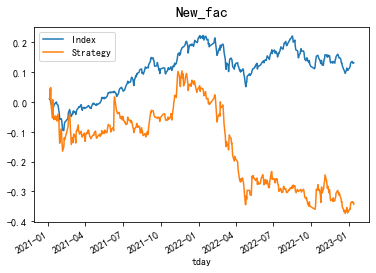

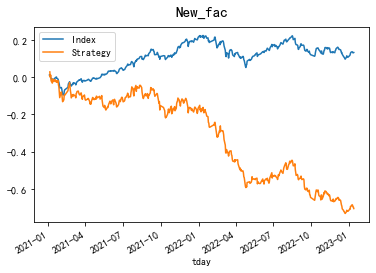

-0.7288955598899193 -1.6611639397439113
[1, 10] [40, 80] 1 1 3


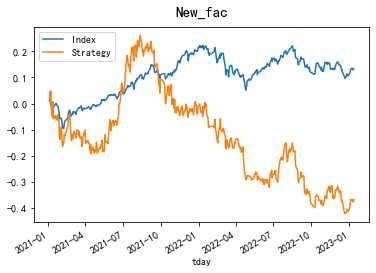

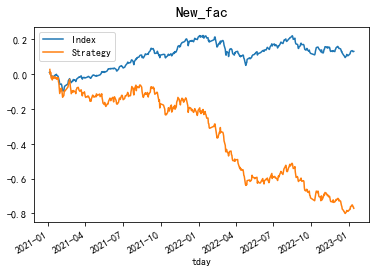

-0.6144057555685212 -1.816352330857303
[1, 10] [60, 120] -1 -1 3


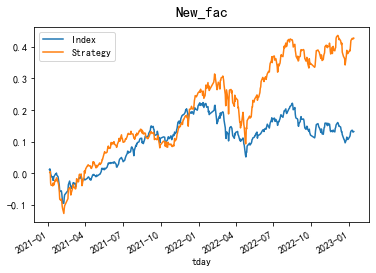

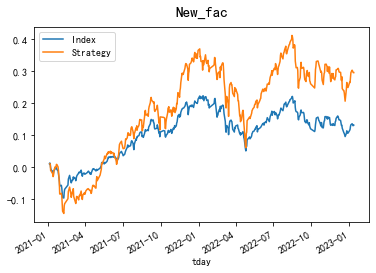

1.1750789257120493 0.6623389807832376
[1, 10] [60, 120] -1 1 3


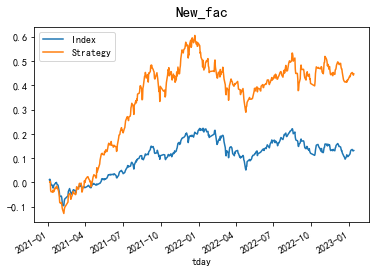

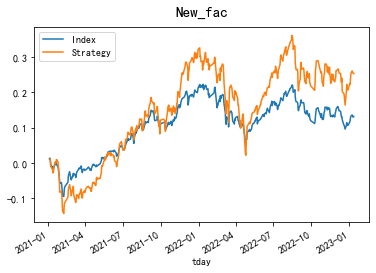

0.9150086845427065 0.5732687646940506
[1, 10] [60, 120] 1 -1 3


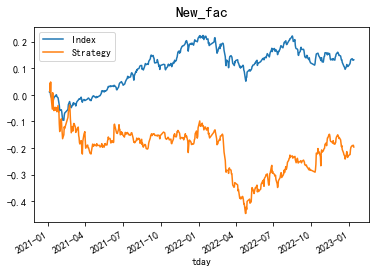

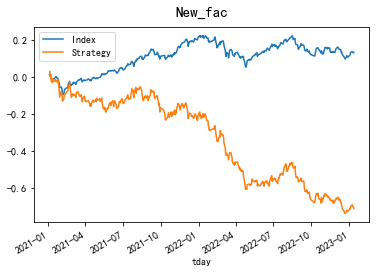

-0.439335306679356 -1.6764765200225693
[1, 10] [60, 120] 1 1 3


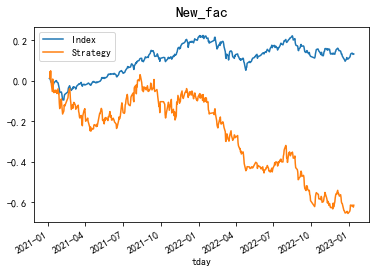

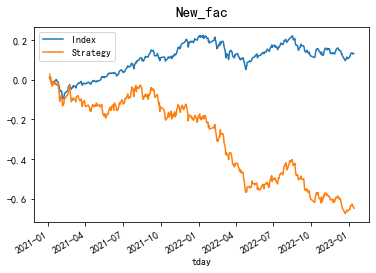

-1.040050462572069 -1.5298853338874638
[5, 10] [1, 5] -1 -1 3


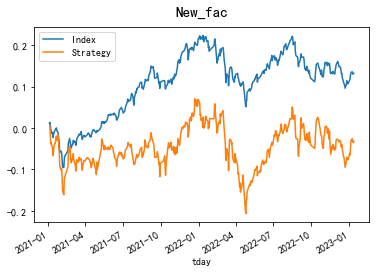

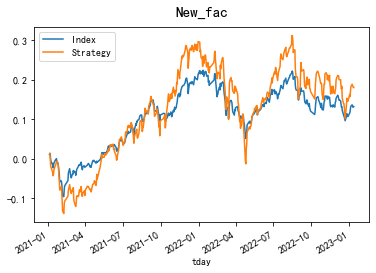

-0.08143673378201123 0.41709828147409916
[5, 10] [1, 5] -1 1 3


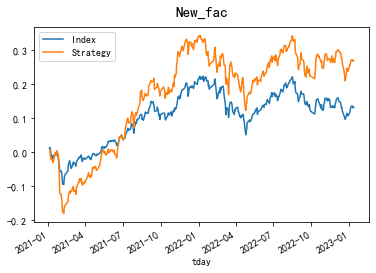

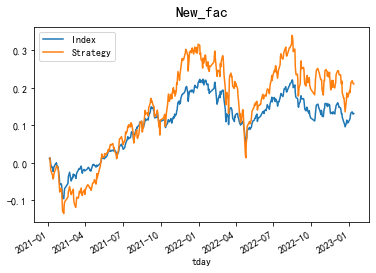

0.7584509935095748 0.48567319088371025
[5, 10] [1, 5] 1 -1 3


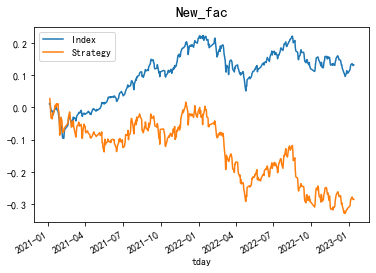

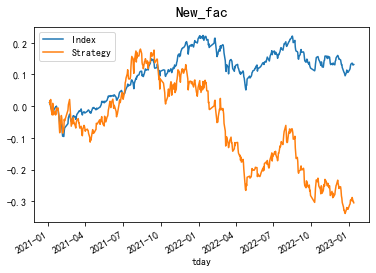

-0.6987335886166297 -0.6550635108857339
[5, 10] [1, 5] 1 1 3


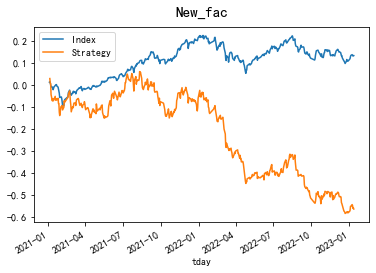

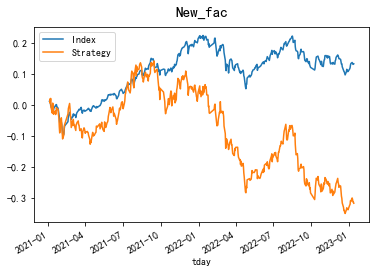

-1.2391536409093002 -0.6841481217015348
[5, 10] [1, 10] -1 -1 3


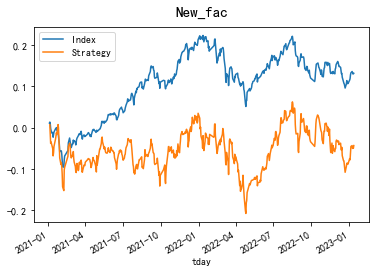

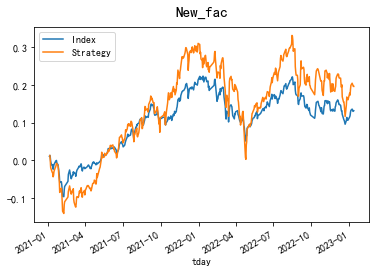

-0.10331399956909607 0.45099354135044845
[5, 10] [1, 10] -1 1 3


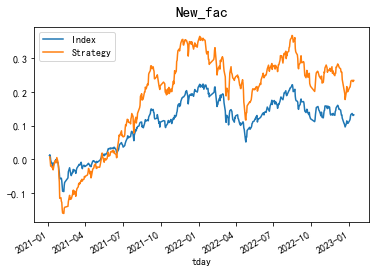

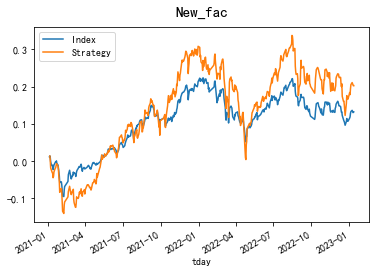

0.6498736204764838 0.4615984221634199
[5, 10] [1, 10] 1 -1 3


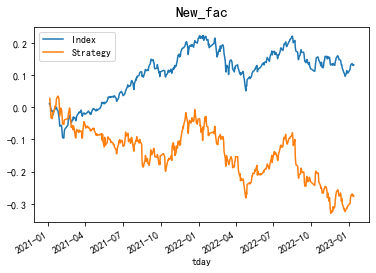

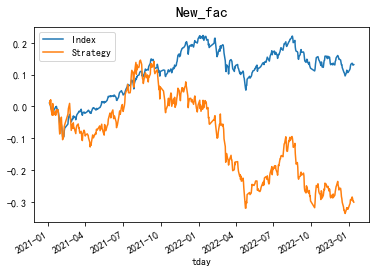

-0.6930372075690113 -0.6504518986739091
[5, 10] [1, 10] 1 1 3


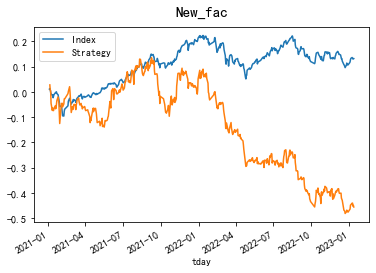

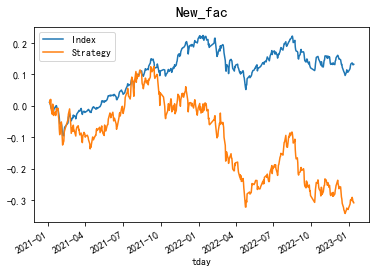

-0.9276248018707075 -0.6741012636182628
[5, 10] [5, 10] -1 -1 3


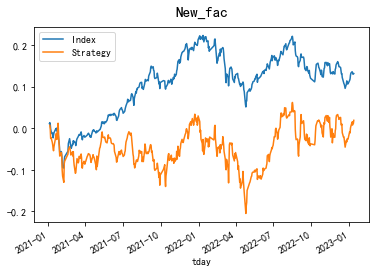

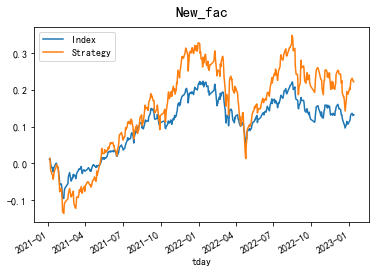

0.046228538304354 0.5104190336983193
[5, 10] [5, 10] -1 1 3


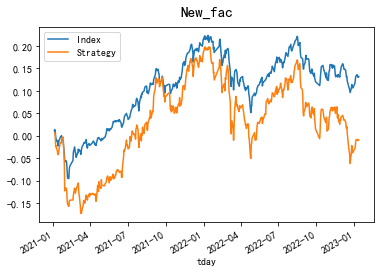

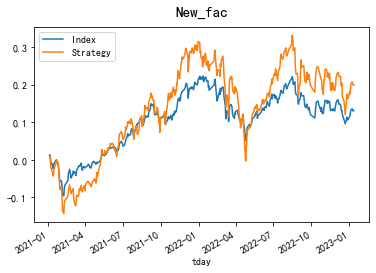

-0.026052409151431668 0.4520860942783515
[5, 10] [5, 10] 1 -1 3


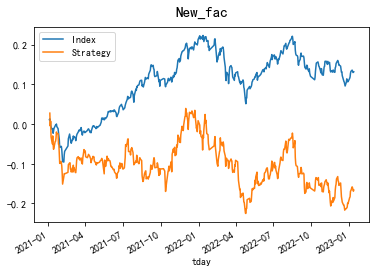

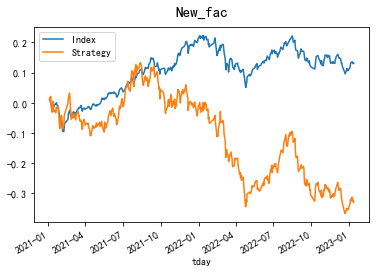

-0.4240016840551996 -0.7132508858884954
[5, 10] [5, 10] 1 1 3


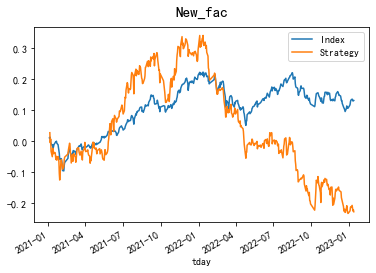

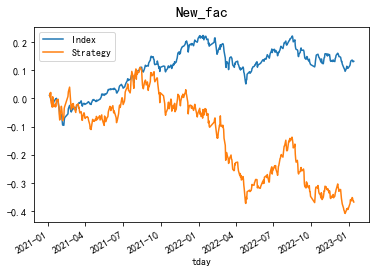

-0.4474449662393421 -0.8027887018373401
[5, 10] [5, 20] -1 -1 3


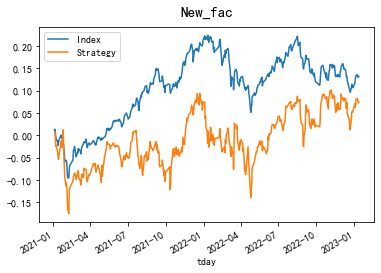

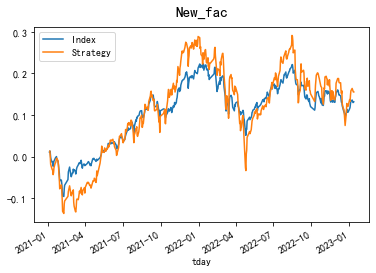

0.17608706354363207 0.3572211698609219
[5, 10] [5, 20] -1 1 3


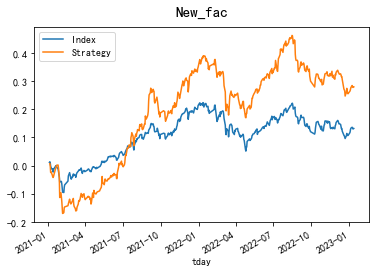

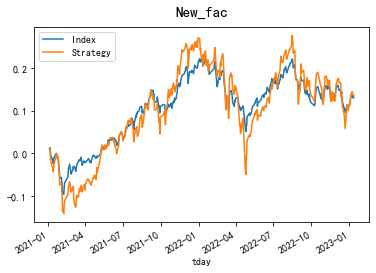

0.7283953078428359 0.3123511579019748
[5, 10] [5, 20] 1 -1 3


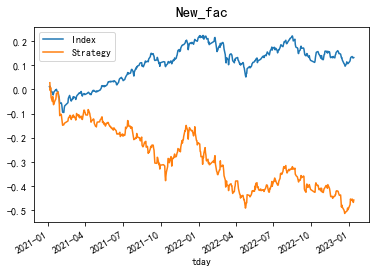

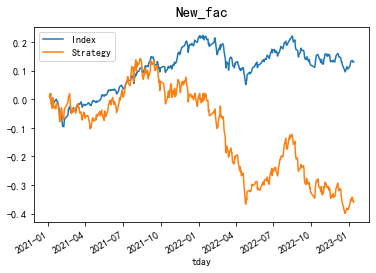

-1.1438205030265955 -0.7763612361964805
[5, 10] [5, 20] 1 1 3


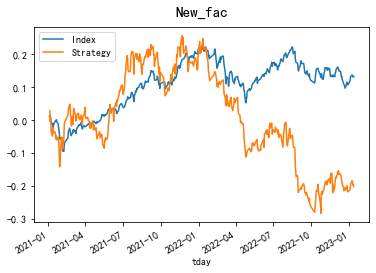

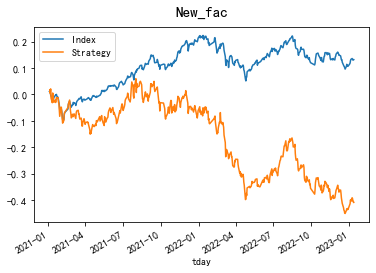

-0.38405584776499224 -0.880170177691223
[5, 10] [20, 40] -1 -1 3


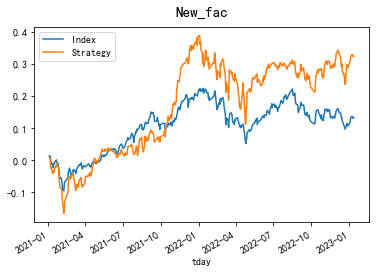

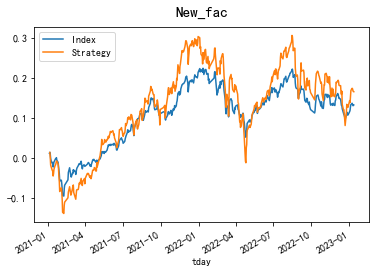

0.7780262726391831 0.3819787866619032
[5, 10] [20, 40] -1 1 3


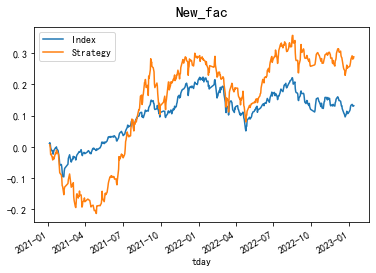

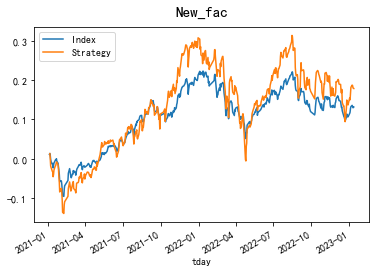

0.6824487647152085 0.41358066764250095
[5, 10] [20, 40] 1 -1 3


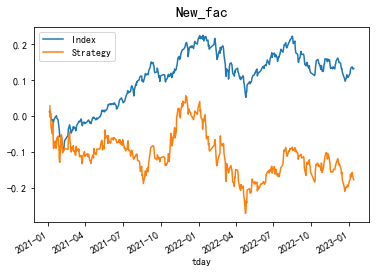

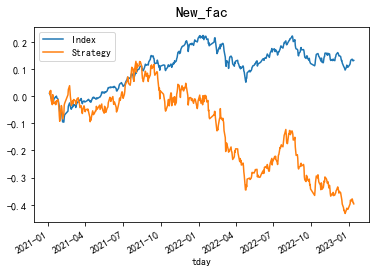

-0.41407307269984966 -0.8410115600505013
[5, 10] [20, 40] 1 1 3


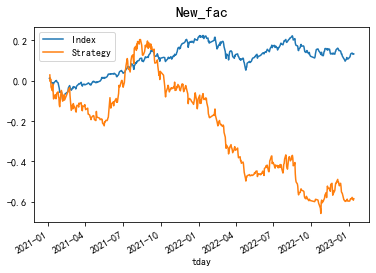

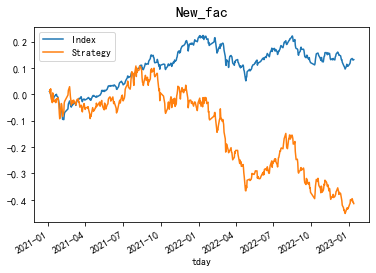

-1.0306629249361101 -0.8758125591323017
[5, 10] [20, 60] -1 -1 3


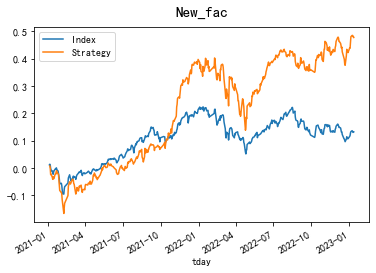

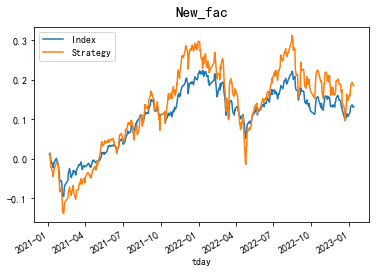

1.157319068625513 0.42742101609204386
[5, 10] [20, 60] -1 1 3


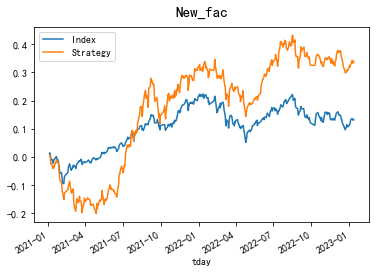

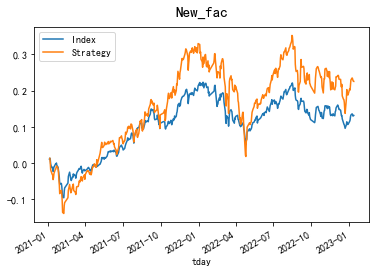

0.7837511252173865 0.5216025193460823
[5, 10] [20, 60] 1 -1 3


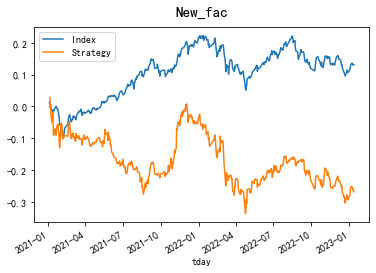

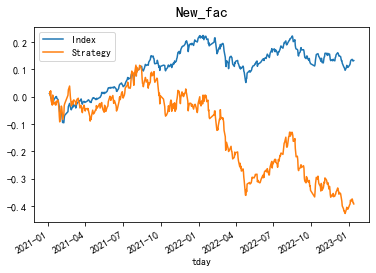

-0.6492494704883301 -0.843972760044643
[5, 10] [20, 60] 1 1 3


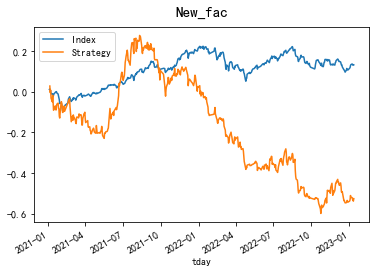

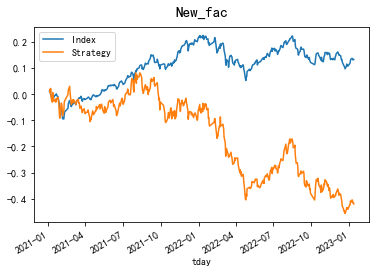

-0.8815645323938505 -0.9018186931630977
[5, 10] [40, 80] -1 -1 3


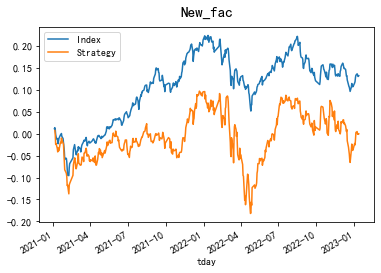

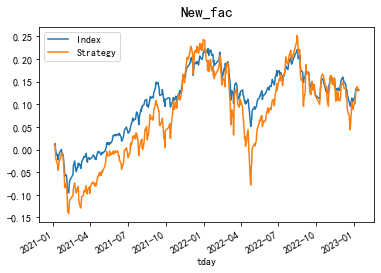

-0.0015658621235082487 0.3096565575233032
[5, 10] [40, 80] -1 1 3


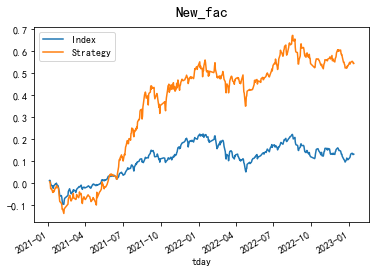

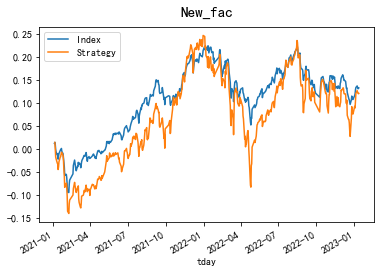

1.1560406770557818 0.27917741108043803
[5, 10] [40, 80] 1 -1 3


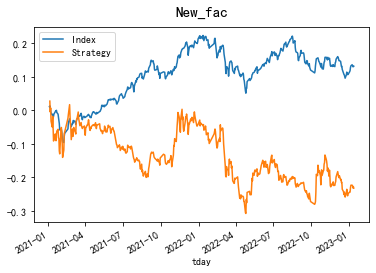

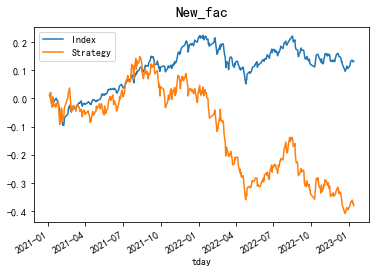

-0.5080471515495137 -0.8198833448059331
[5, 10] [40, 80] 1 1 3


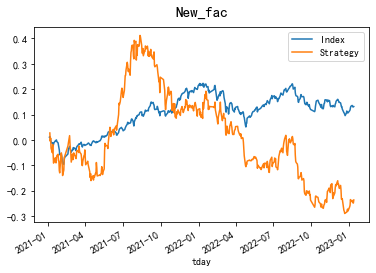

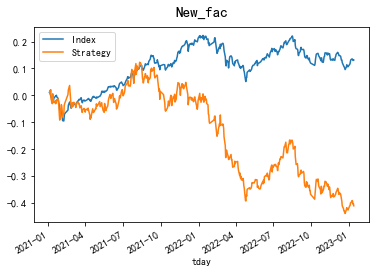

-0.37511881067233116 -0.8961643830473909
[5, 10] [60, 120] -1 -1 3


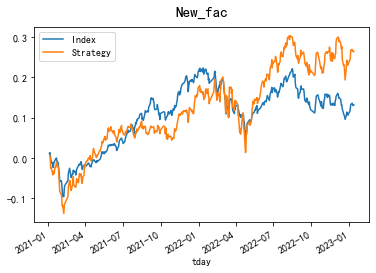

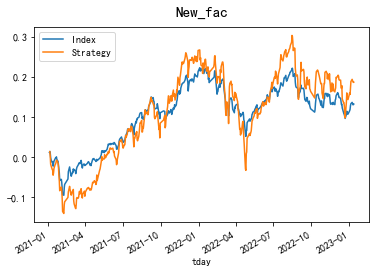

0.75143327607722 0.4304275703997315
[5, 10] [60, 120] -1 1 3


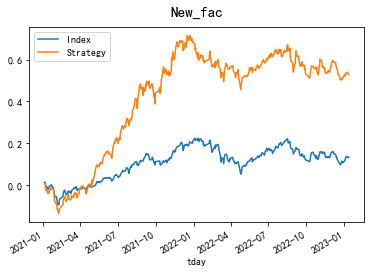

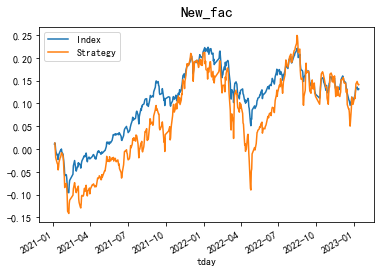

1.123339326834096 0.3296805655375671
[5, 10] [60, 120] 1 -1 3


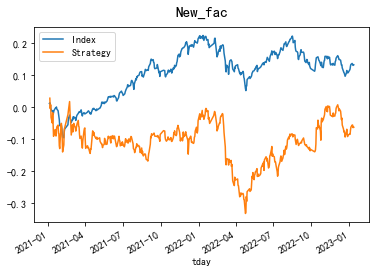

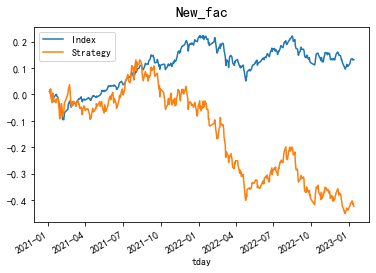

-0.13840229121556777 -0.906459812176353
[5, 10] [60, 120] 1 1 3


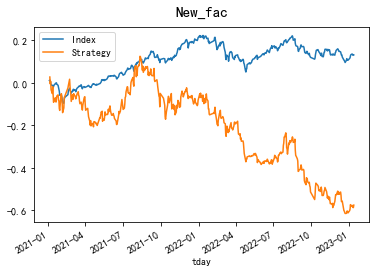

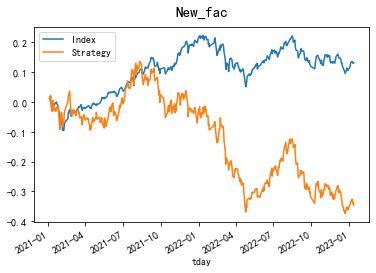

-0.9613069621334841 -0.7470209327491443
[5, 20] [1, 5] -1 -1 3


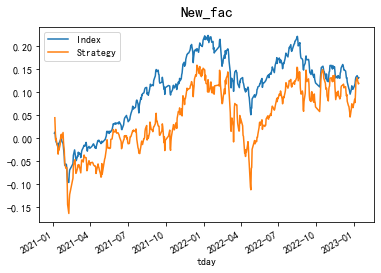

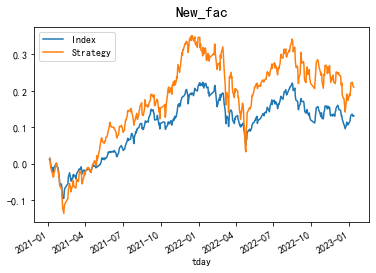

0.28681658270691673 0.481060641331475
[5, 20] [1, 5] -1 1 3


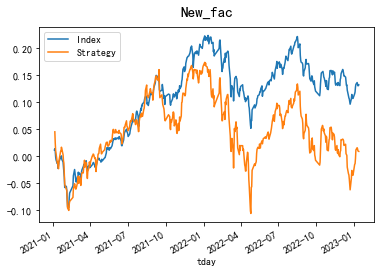

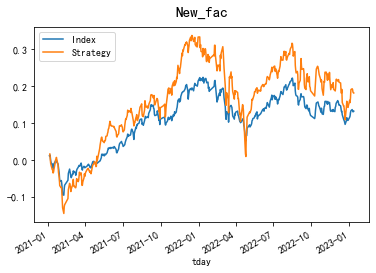

0.024253701978116864 0.41169043269480377
[5, 20] [1, 5] 1 -1 3


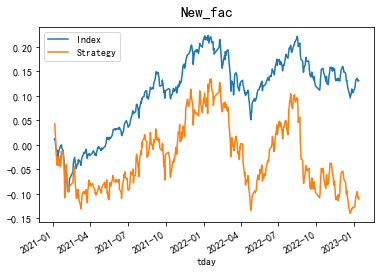

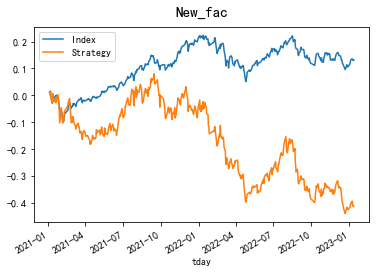

-0.25205206151466686 -0.841158891368875
[5, 20] [1, 5] 1 1 3


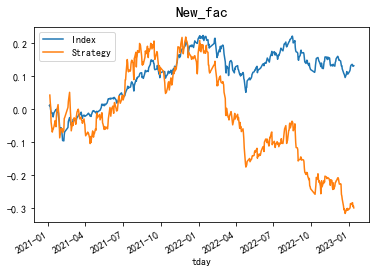

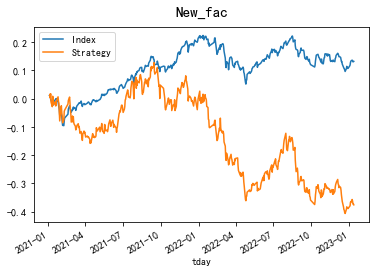

-0.6088525525534377 -0.7649926687614115
[5, 20] [1, 10] -1 -1 3


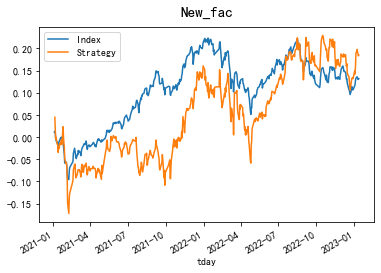

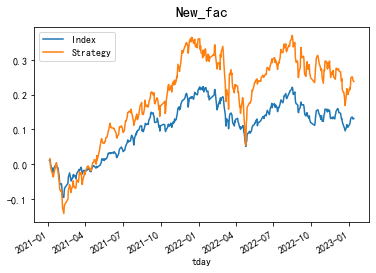

0.42360128631306804 0.5399179551368121
[5, 20] [1, 10] -1 1 3


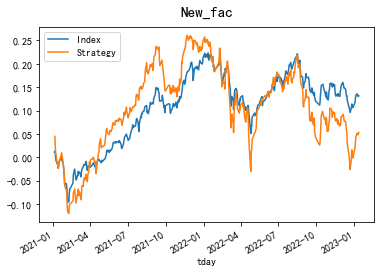

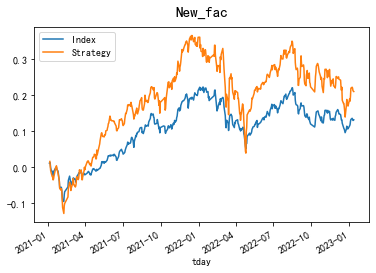

0.14688348917923416 0.47597231941281765
[5, 20] [1, 10] 1 -1 3


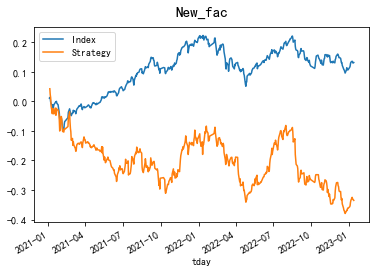

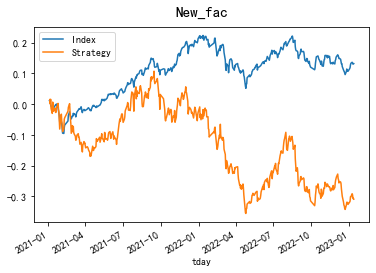

-0.7784251186074898 -0.6410786966056711
[5, 20] [1, 10] 1 1 3


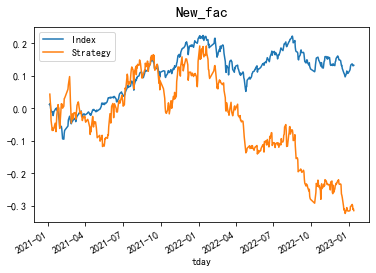

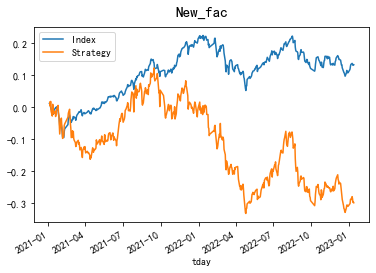

-0.6078658294284861 -0.6204716141629176
[5, 20] [5, 10] -1 -1 3


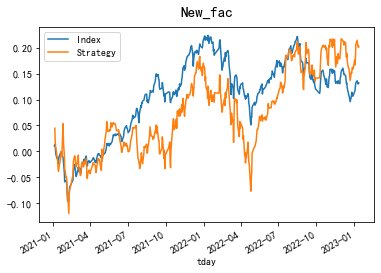

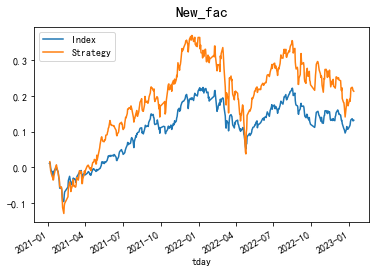

0.4701419860521319 0.4812280868694619
[5, 20] [5, 10] -1 1 3


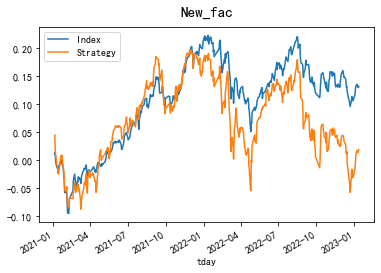

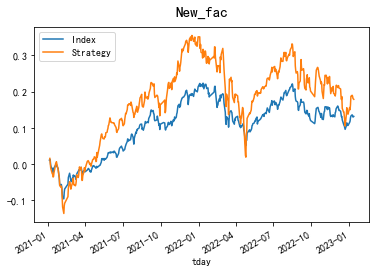

0.05158489613617412 0.4033146089200879
[5, 20] [5, 10] 1 -1 3


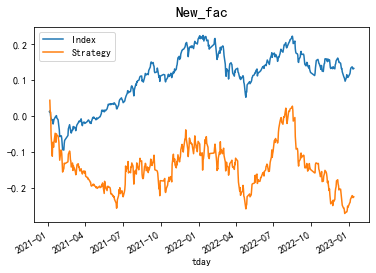

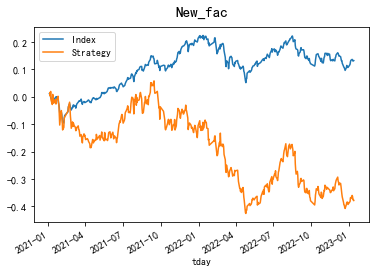

-0.495701989723471 -0.7783952778425344
[5, 20] [5, 10] 1 1 3


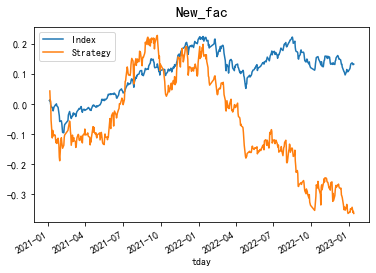

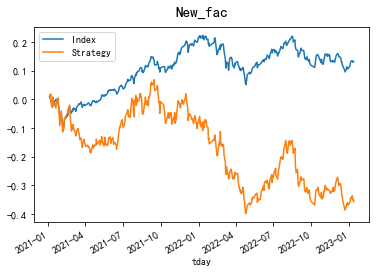

-0.6672152846665774 -0.7391338850619203
[5, 20] [5, 20] -1 -1 3


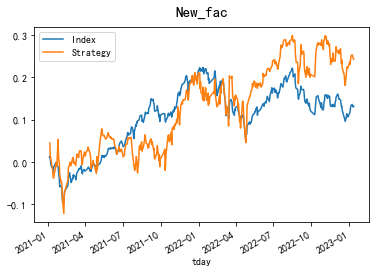

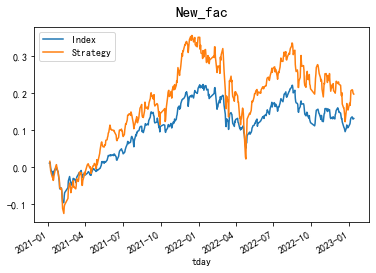

0.5309478712428366 0.44608517964328737
[5, 20] [5, 20] -1 1 3


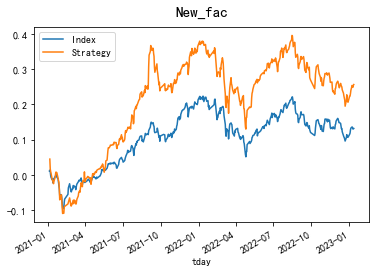

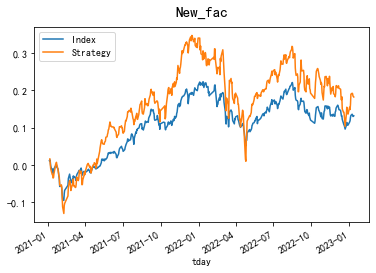

0.6851103153160045 0.40936452212447716
[5, 20] [5, 20] 1 -1 3


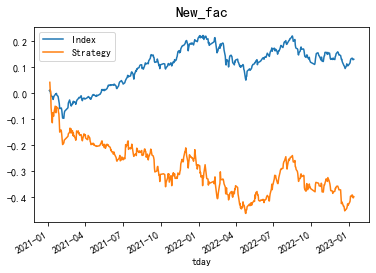

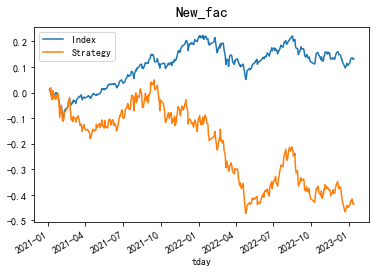

-0.9185793579213333 -0.900232025914205
[5, 20] [5, 20] 1 1 3


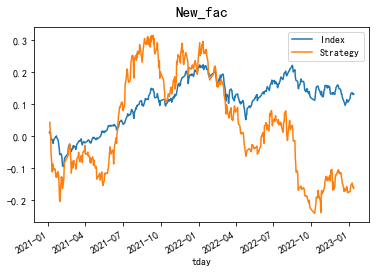

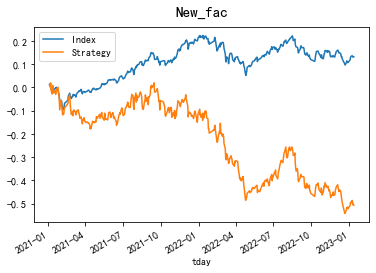

-0.28095430929344406 -1.0566290084892307
[5, 20] [20, 40] -1 -1 3


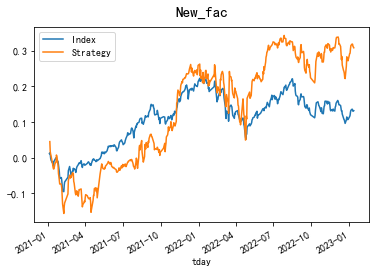

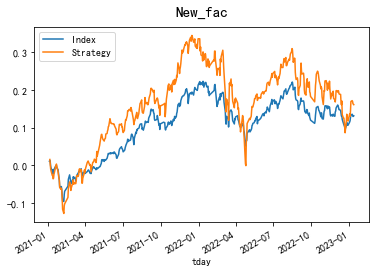

0.6814144674673775 0.36528499831816513
[5, 20] [20, 40] -1 1 3


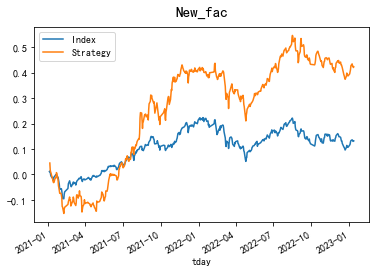

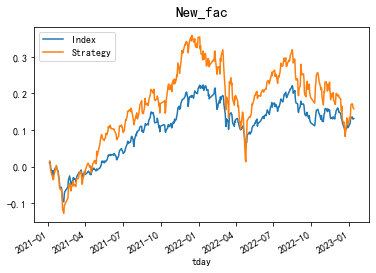

0.9740373576114066 0.3563375834532077
[5, 20] [20, 40] 1 -1 3


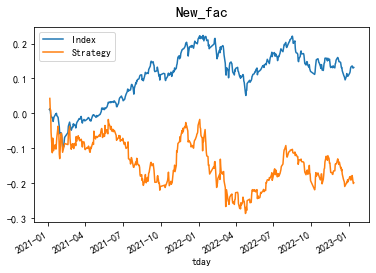

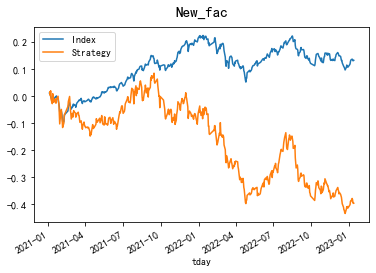

-0.44095104651047384 -0.7999539770874827
[5, 20] [20, 40] 1 1 3


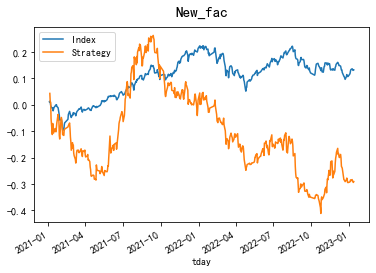

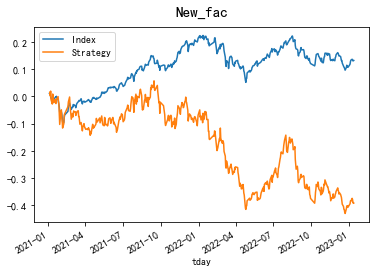

-0.4702475647387062 -0.7923997619463947
[5, 20] [20, 60] -1 -1 3


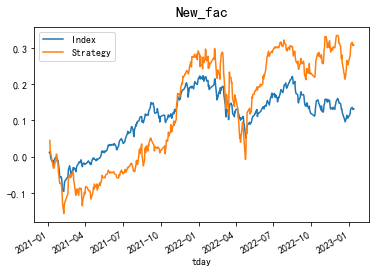

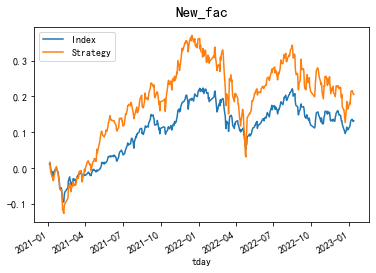

0.6890522300953095 0.4661800948816154
[5, 20] [20, 60] -1 1 3


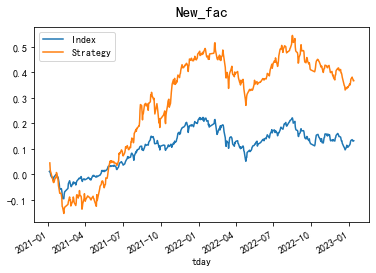

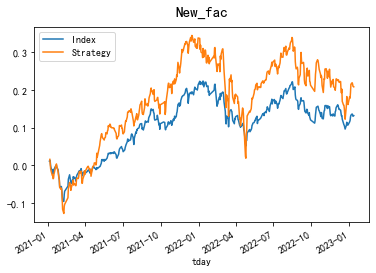

0.8479894486876705 0.47083034620397013
[5, 20] [20, 60] 1 -1 3


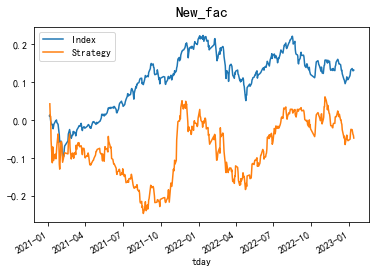

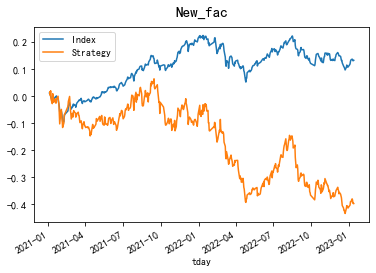

-0.10882021964098354 -0.8103887392570954
[5, 20] [20, 60] 1 1 3


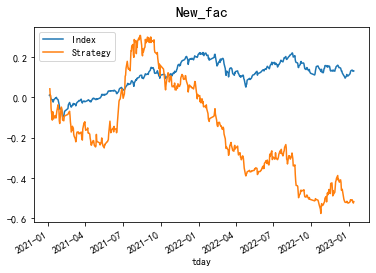

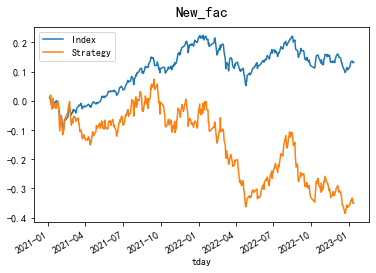

-0.8060963996019561 -0.7077713514763193
[5, 20] [40, 80] -1 -1 3


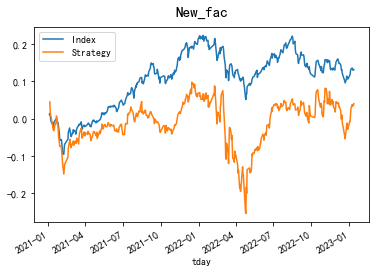

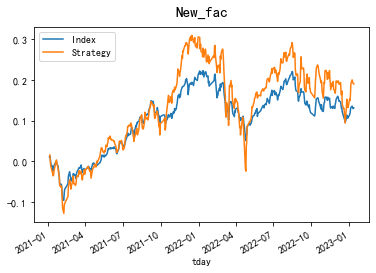

0.09231152611640017 0.44103805225034426
[5, 20] [40, 80] -1 1 3


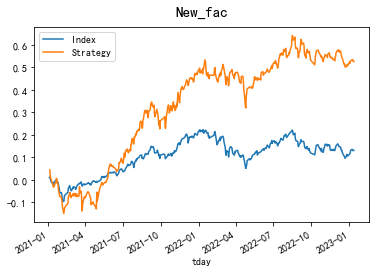

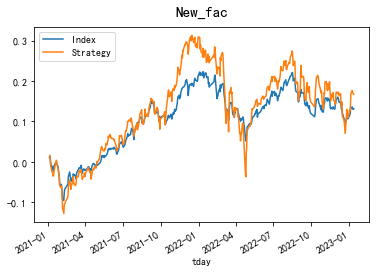

1.067356732111857 0.38441020854347446
[5, 20] [40, 80] 1 -1 3


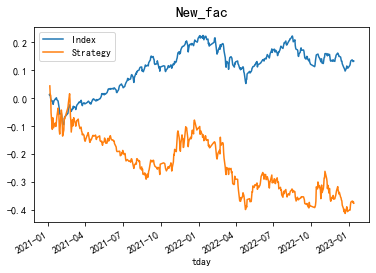

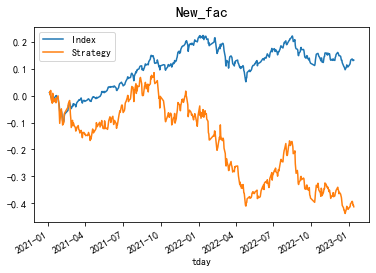

-0.781355188399032 -0.8452899209166654
[5, 20] [40, 80] 1 1 3


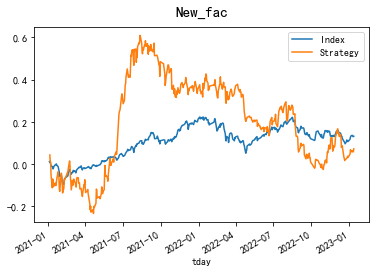

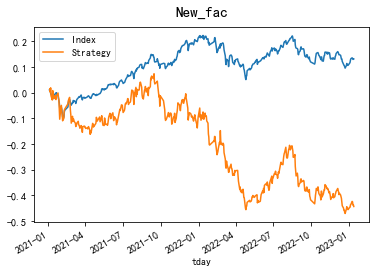

0.09742705259554331 -0.9062894123937418
[5, 20] [60, 120] -1 -1 3


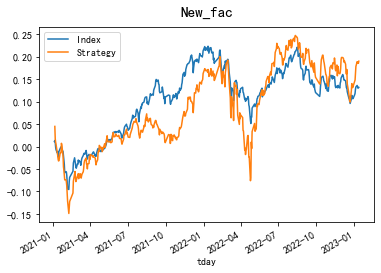

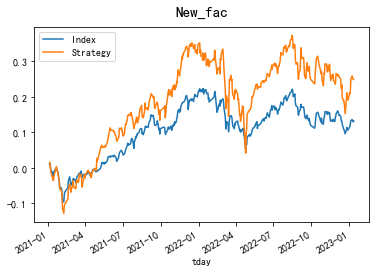

0.49455526999981436 0.5668808631165597
[5, 20] [60, 120] -1 1 3


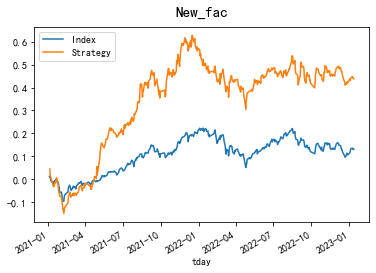

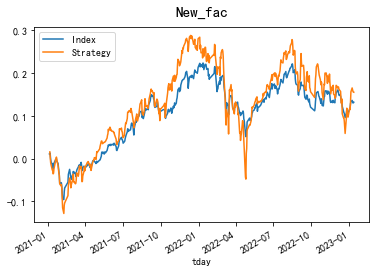

0.9006688241430505 0.3558671705156027
[5, 20] [60, 120] 1 -1 3


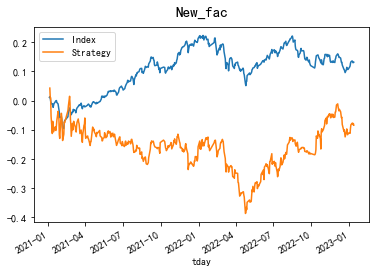

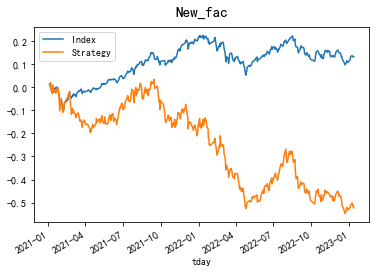

-0.17055876658346752 -1.06322117392747
[5, 20] [60, 120] 1 1 3


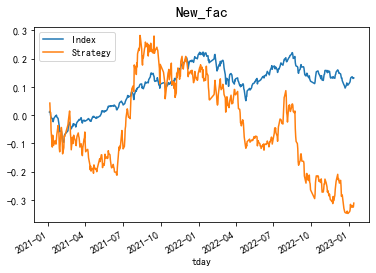

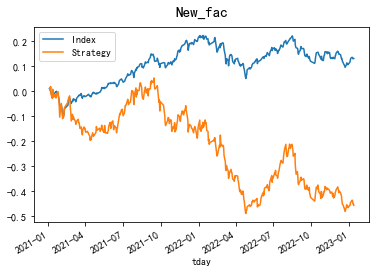

-0.4543803941406731 -0.9412071750576572
[20, 40] [1, 5] -1 -1 3


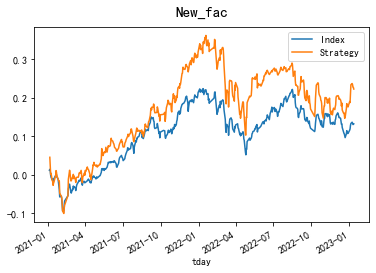

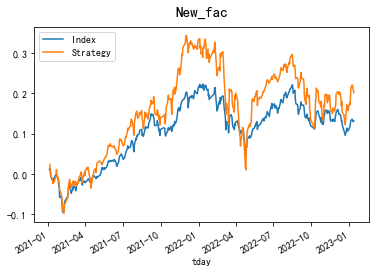

0.5811568760852568 0.4744922511115325
[20, 40] [1, 5] -1 1 3


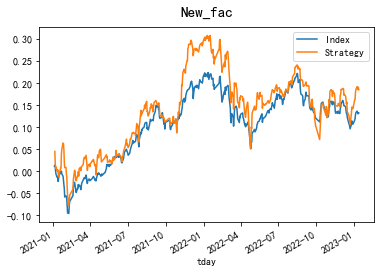

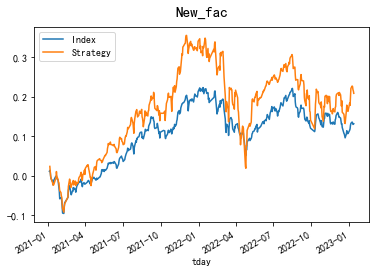

0.5117843866767622 0.4893021583170808
[20, 40] [1, 5] 1 -1 3


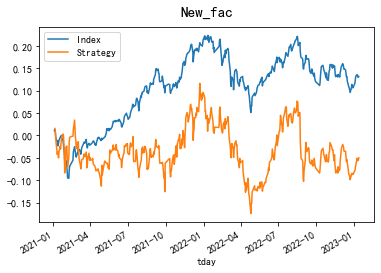

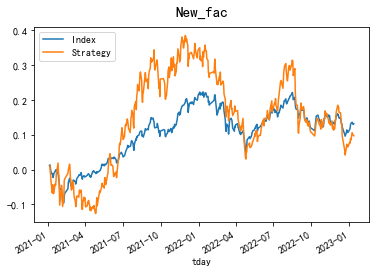

-0.10950416312911578 0.1749206053559212
[20, 40] [1, 5] 1 1 3


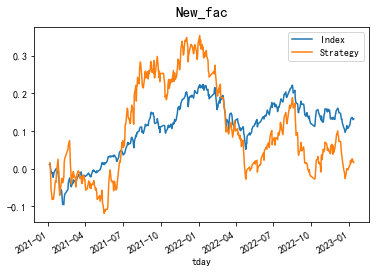

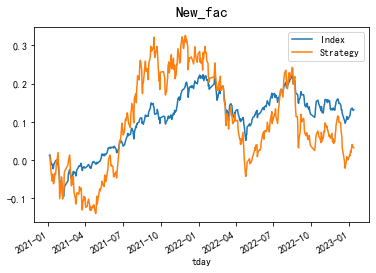

0.03202268124032626 0.05809097079952226
[20, 40] [1, 10] -1 -1 3


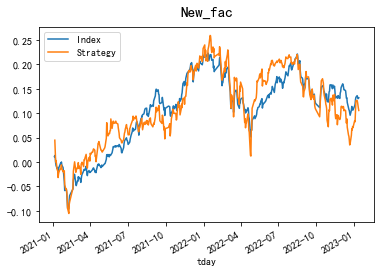

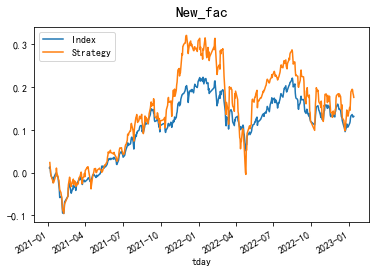

0.2763477910915976 0.4112314870495458
[20, 40] [1, 10] -1 1 3


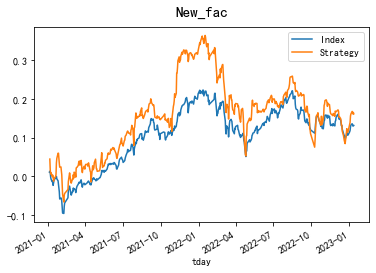

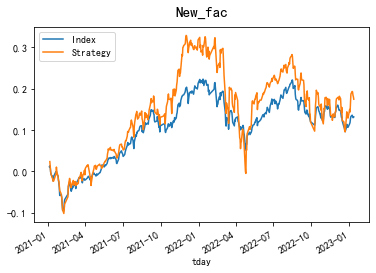

0.425339929452056 0.40804602963369285
[20, 40] [1, 10] 1 -1 3


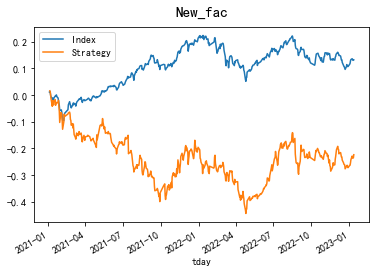

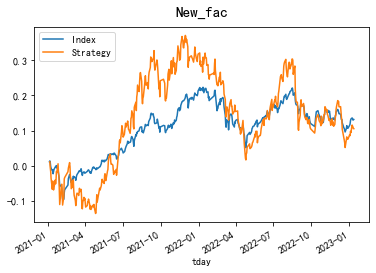

-0.48733825540064335 0.19130951565168028
[20, 40] [1, 10] 1 1 3


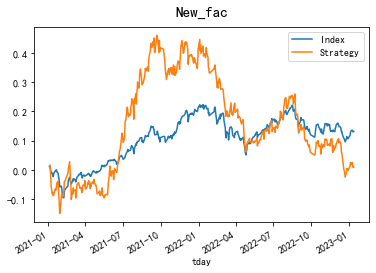

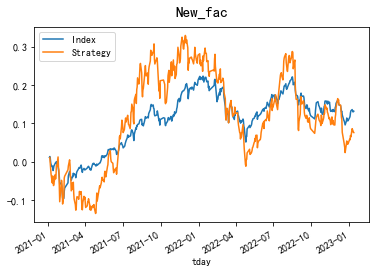

0.017508794221148552 0.13940665120499263
[20, 40] [5, 10] -1 -1 3


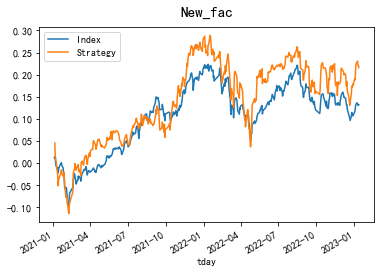

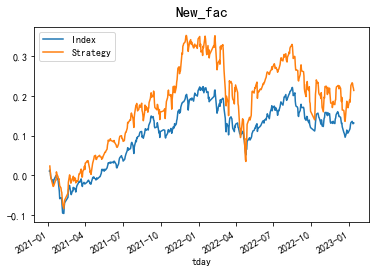

0.5634169006016886 0.5011531103501836
[20, 40] [5, 10] -1 1 3


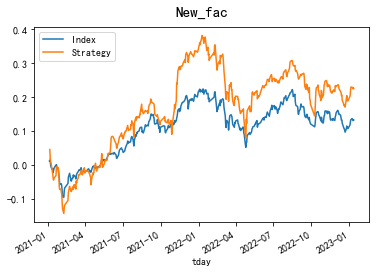

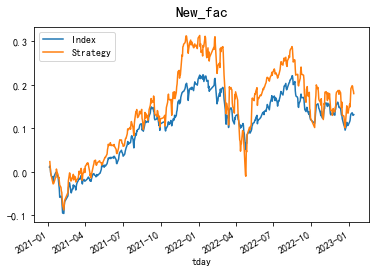

0.5909211389645971 0.4206720214705073
[20, 40] [5, 10] 1 -1 3


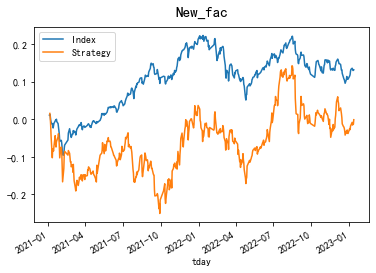

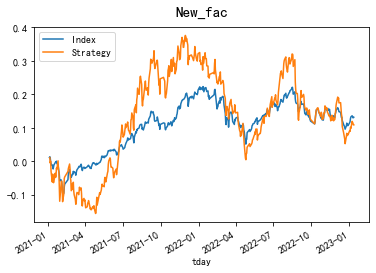

-0.00233174547526218 0.1989771876830629
[20, 40] [5, 10] 1 1 3


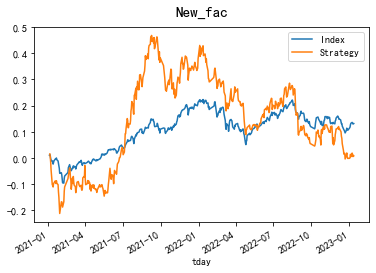

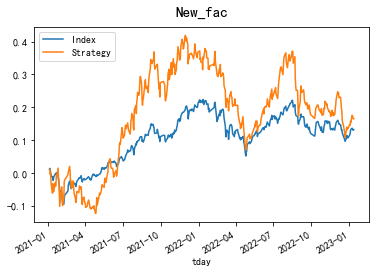

0.013666847032354422 0.3045589887051551
[20, 40] [5, 20] -1 -1 3


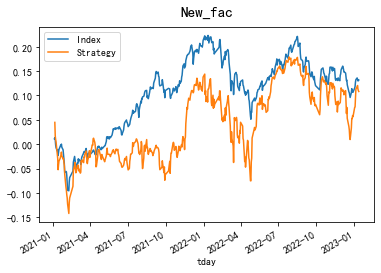

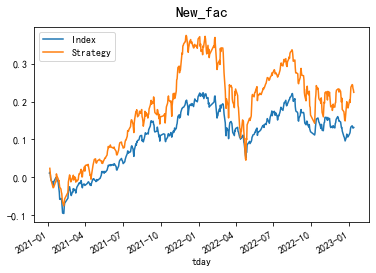

0.27161373342926337 0.523160211910686
[20, 40] [5, 20] -1 1 3


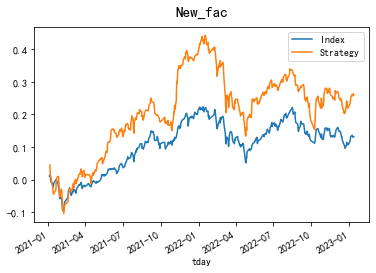

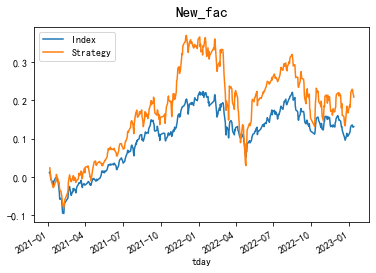

0.6848359082669367 0.48387537340856374
[20, 40] [5, 20] 1 -1 3


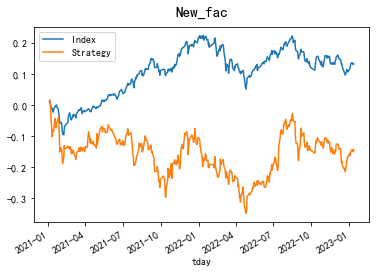

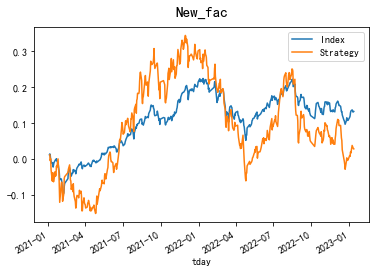

-0.30981251530972004 0.050314208599029395
[20, 40] [5, 20] 1 1 3


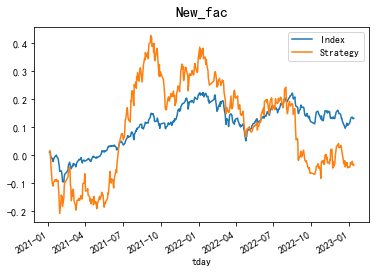

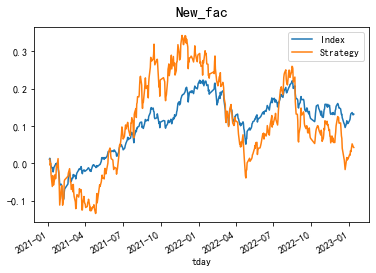

-0.058217879609013534 0.07858910659503184
[20, 40] [20, 40] -1 -1 3


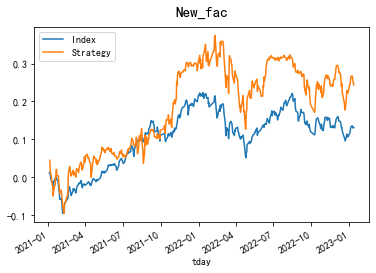

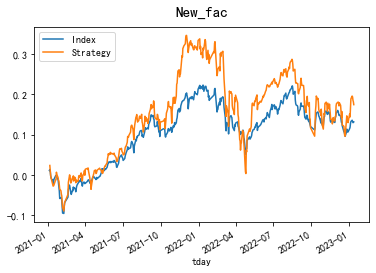

0.5606242826232303 0.4023500146334574
[20, 40] [20, 40] -1 1 3


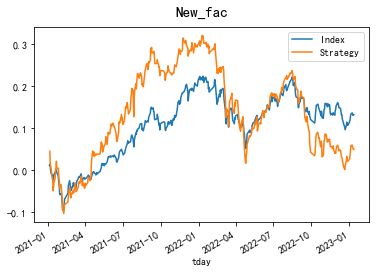

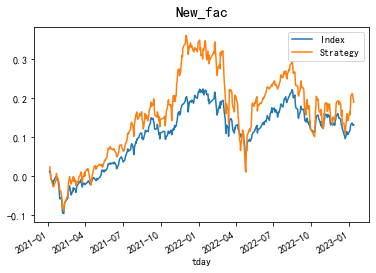

0.13723019483235865 0.4323593090935571
[20, 40] [20, 40] 1 -1 3


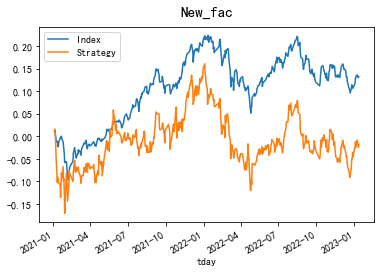

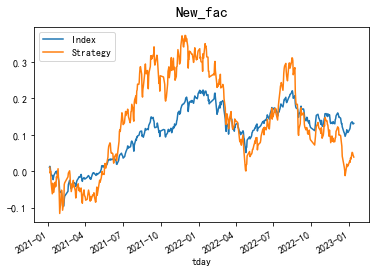

-0.03857003306101325 0.07169199451962027
[20, 40] [20, 40] 1 1 3


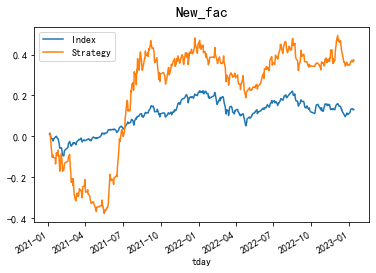

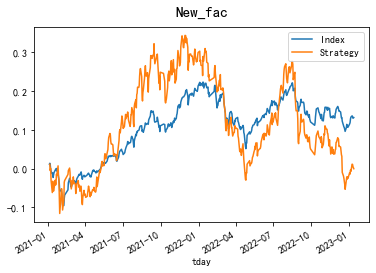

0.5562088093027743 -0.000969066067959164
[20, 40] [20, 60] -1 -1 3


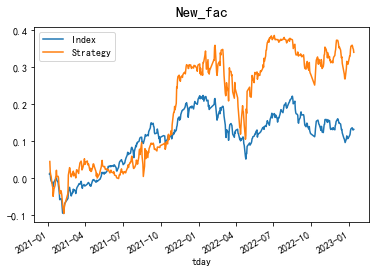

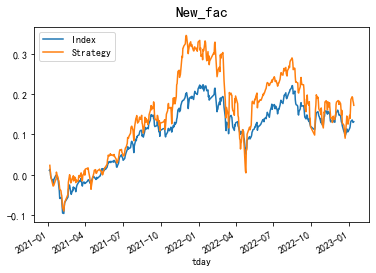

0.777071347521201 0.3966864094181389
[20, 40] [20, 60] -1 1 3


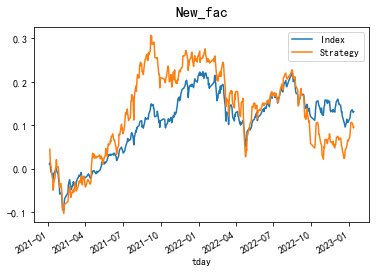

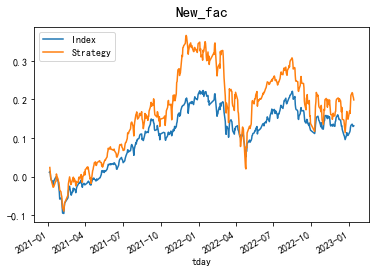

0.252036716953886 0.45377821764579335
[20, 40] [20, 60] 1 -1 3


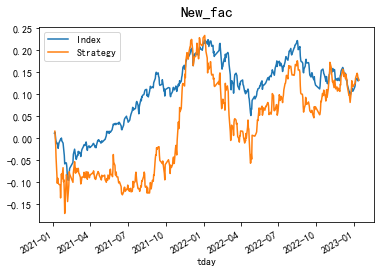

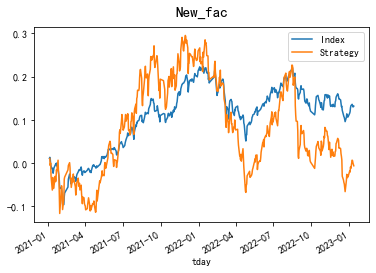

0.28855658285523045 -0.010987266362998715
[20, 40] [20, 60] 1 1 3


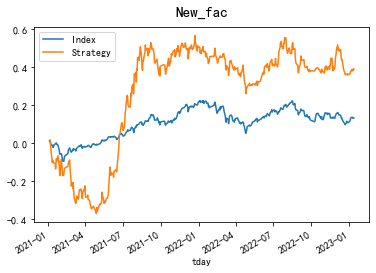

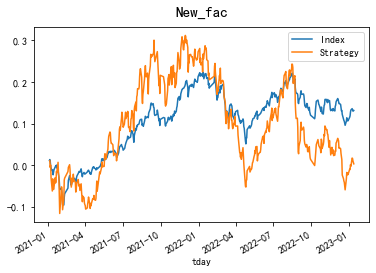

0.572532307167684 0.0059720519956705815
[20, 40] [40, 80] -1 -1 3


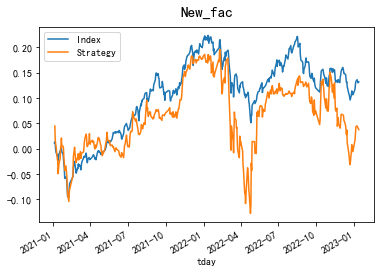

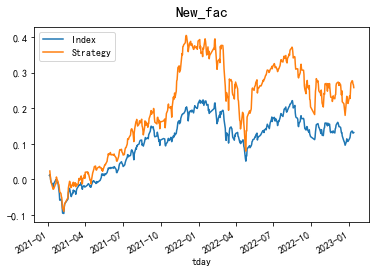

0.08700108359580831 0.6019232510833136
[20, 40] [40, 80] -1 1 3


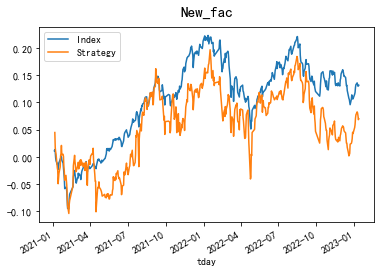

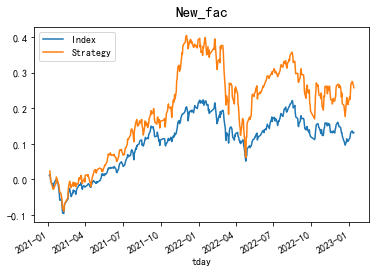

0.16470547885577133 0.600683713402845
[20, 40] [40, 80] 1 -1 3


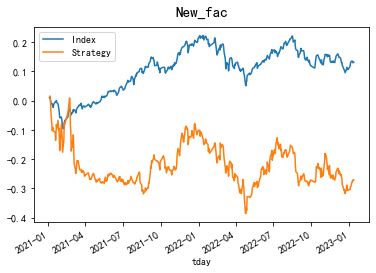

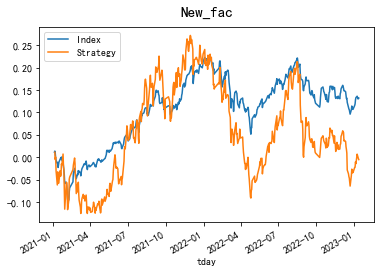

-0.5344895209497207 -0.010312847698015312
[20, 40] [40, 80] 1 1 3


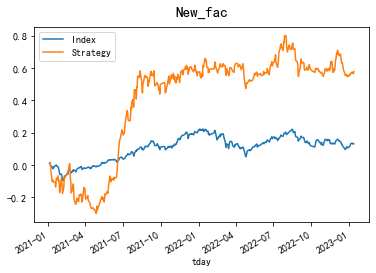

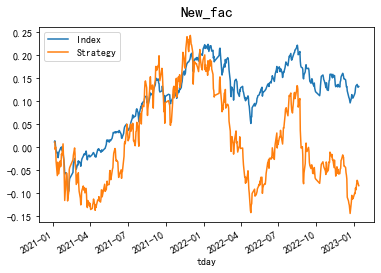

0.7870620200493359 -0.15549137631485557
[20, 40] [60, 120] -1 -1 3


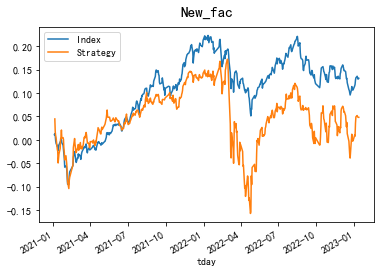

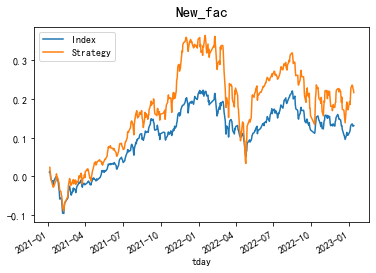

0.11669666293078519 0.5092366555696264
[20, 40] [60, 120] -1 1 3


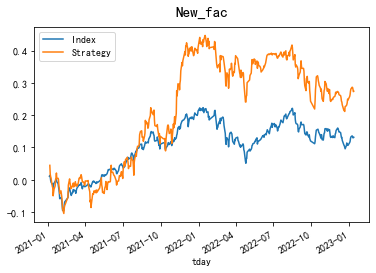

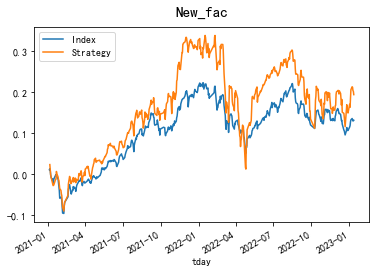

0.5934570982392947 0.4537181918289908
[20, 40] [60, 120] 1 -1 3


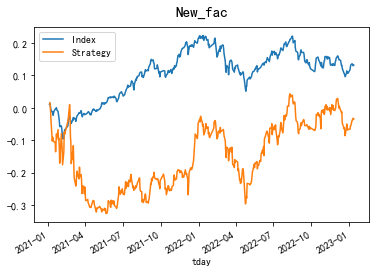

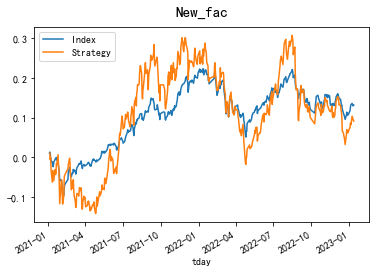

-0.06392566112742792 0.1669669647363577
[20, 40] [60, 120] 1 1 3


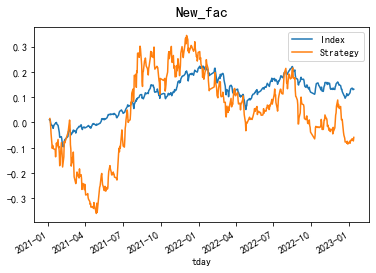

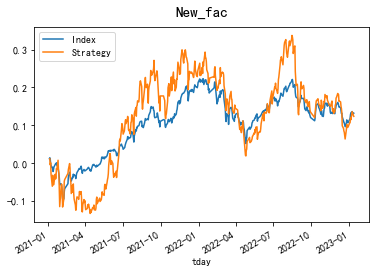

-0.07728655084556935 0.22848470854947225
[20, 60] [1, 5] -1 -1 3


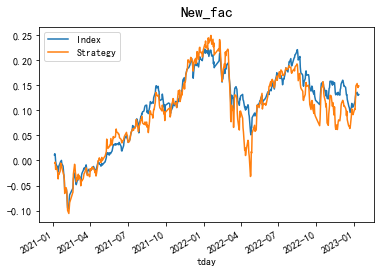

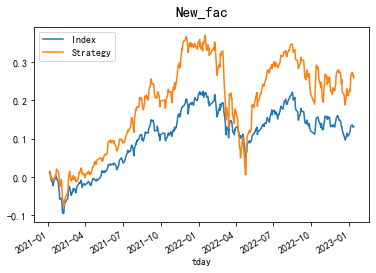

0.41466118715100964 0.6289921883936148
[20, 60] [1, 5] -1 1 3


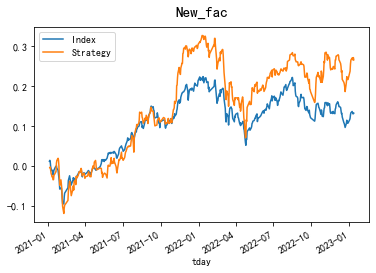

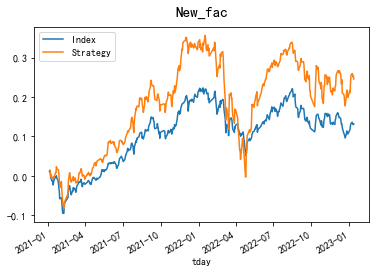

0.7777738782902457 0.5976960025097663
[20, 60] [1, 5] 1 -1 3


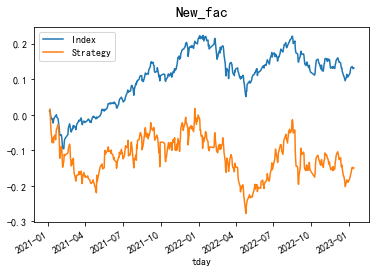

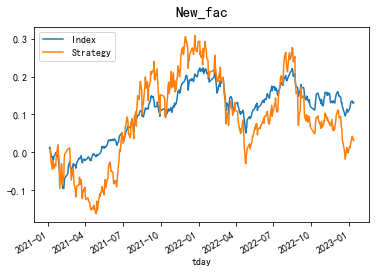

-0.3223916411926494 0.055897914222352345
[20, 60] [1, 5] 1 1 3


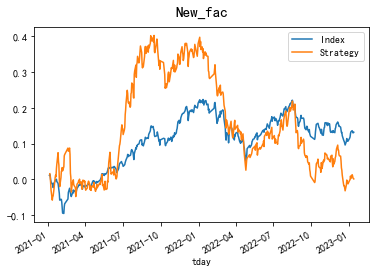

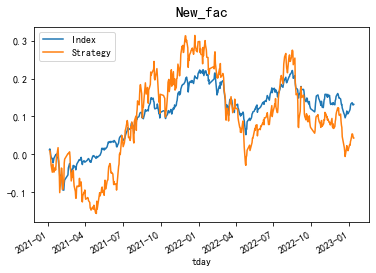

0.002015435439734947 0.07539664402830473
[20, 60] [1, 10] -1 -1 3


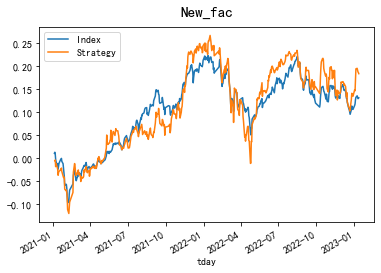

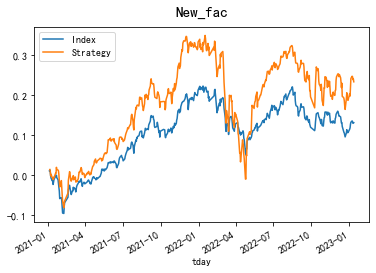

0.5124474329920707 0.5685094474903227
[20, 60] [1, 10] -1 1 3


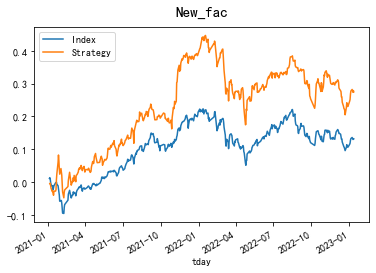

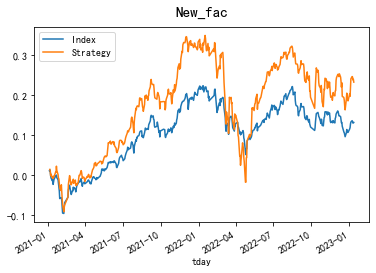

0.749958903081729 0.5617470631975604
[20, 60] [1, 10] 1 -1 3


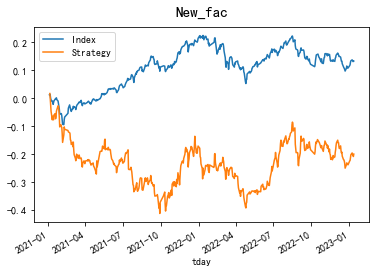

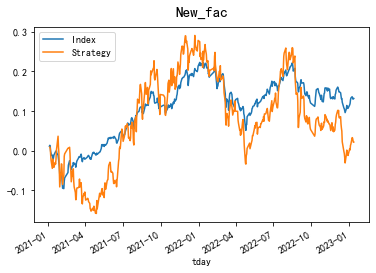

-0.42459354673402233 0.03878210683663652
[20, 60] [1, 10] 1 1 3


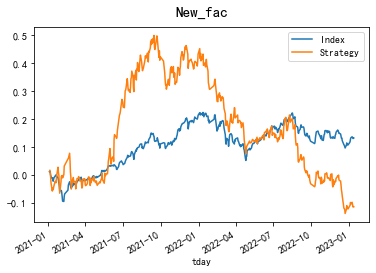

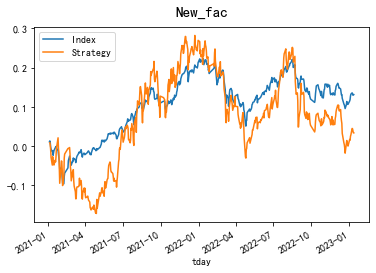

-0.20989024443287133 0.060691040061471996
[20, 60] [5, 10] -1 -1 3


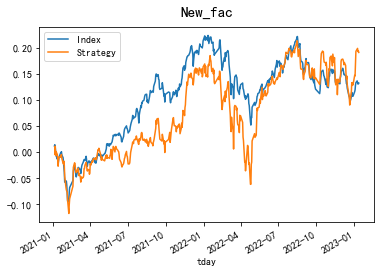

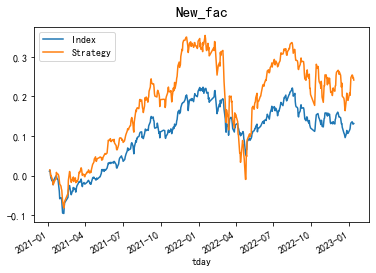

0.5363581067613078 0.5896263294025113
[20, 60] [5, 10] -1 1 3


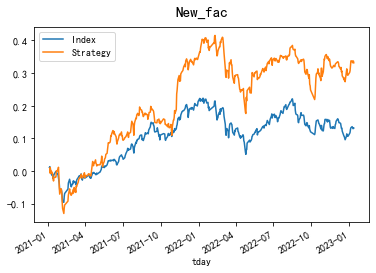

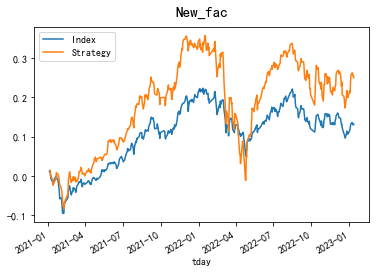

0.9206298546195026 0.6078284360059009
[20, 60] [5, 10] 1 -1 3


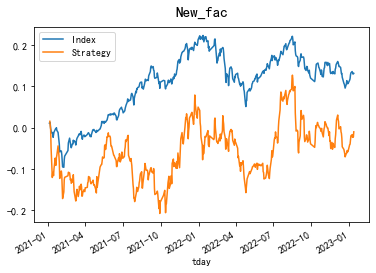

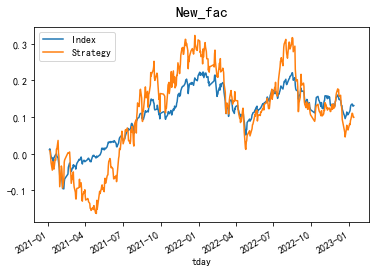

-0.020166519102268916 0.17889537326304977
[20, 60] [5, 10] 1 1 3


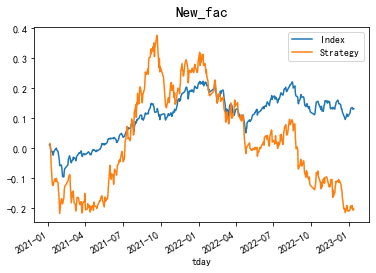

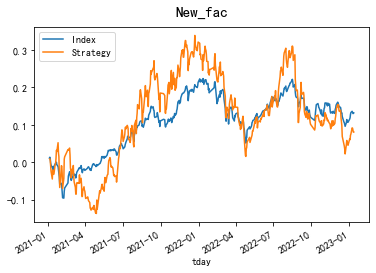

-0.34786411360335784 0.14391286549702859
[20, 60] [5, 20] -1 -1 3


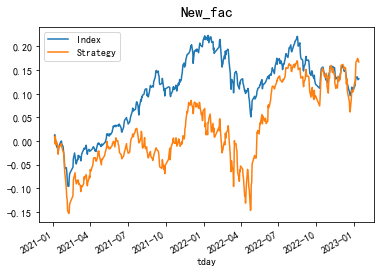

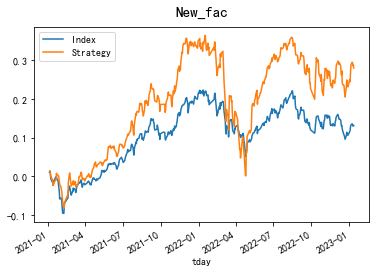

0.45239668062942695 0.6778877313710411
[20, 60] [5, 20] -1 1 3


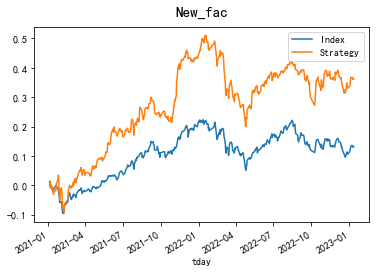

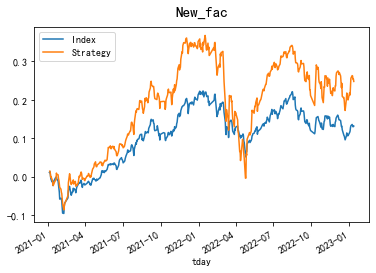

0.9491133623582843 0.5979364312228413
[20, 60] [5, 20] 1 -1 3


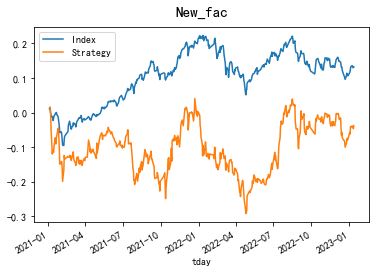

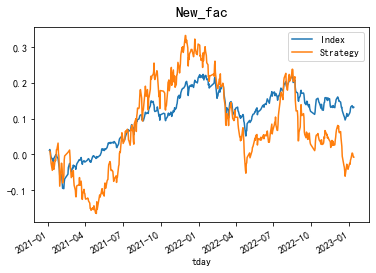

-0.07730126931501888 -0.014215323360067148
[20, 60] [5, 20] 1 1 3


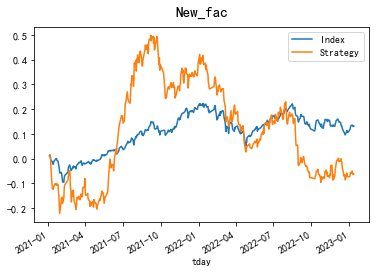

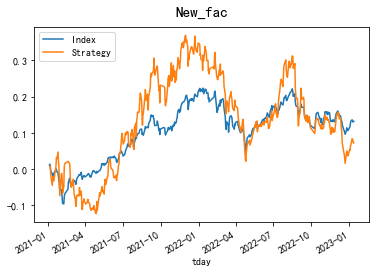

-0.0993209811041283 0.13013662459952086
[20, 60] [20, 40] -1 -1 3


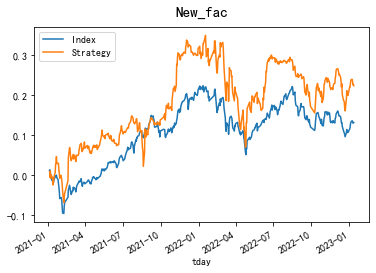

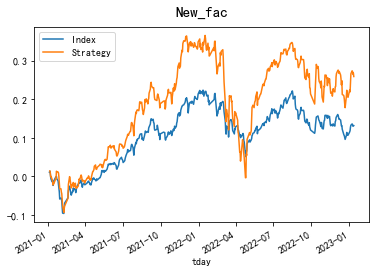

0.5330275568759503 0.6223345299582747
[20, 60] [20, 40] -1 1 3


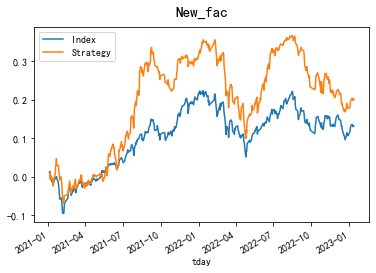

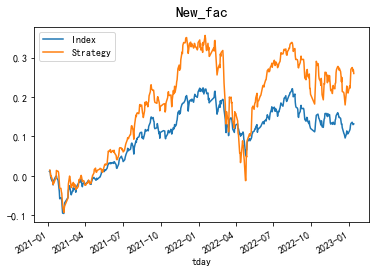

0.5757621867805778 0.6206286973760932
[20, 60] [20, 40] 1 -1 3


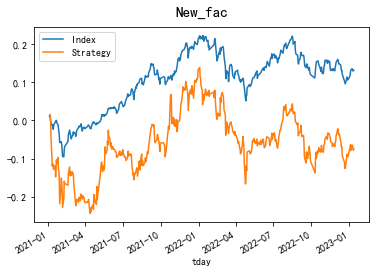

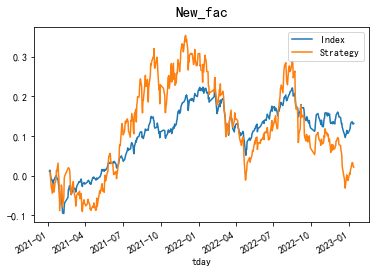

-0.14639415317018822 0.03847952738784437
[20, 60] [20, 40] 1 1 3


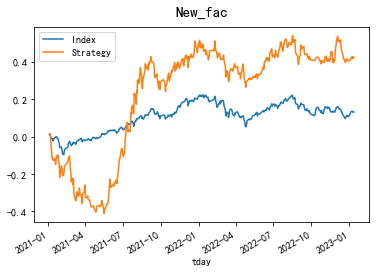

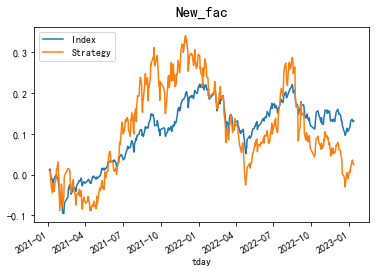

0.6186615844385781 0.04327790345317016
[20, 60] [20, 60] -1 -1 3


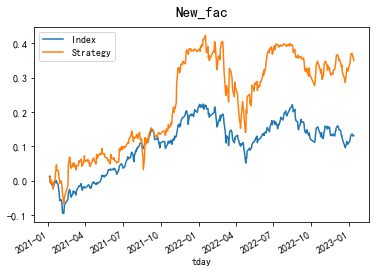

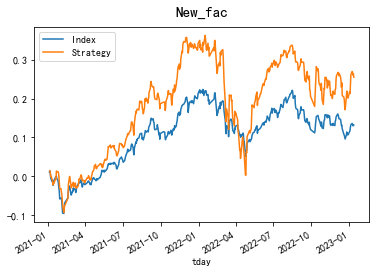

0.8195847843978198 0.6140202096417255
[20, 60] [20, 60] -1 1 3


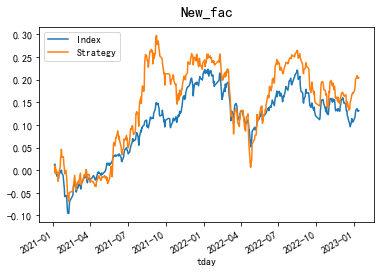

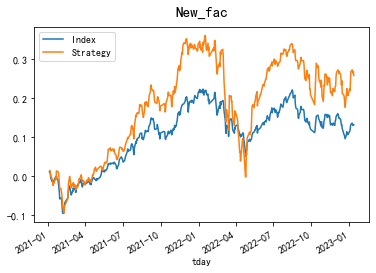

0.5696585719110019 0.6189373333623519
[20, 60] [20, 60] 1 -1 3


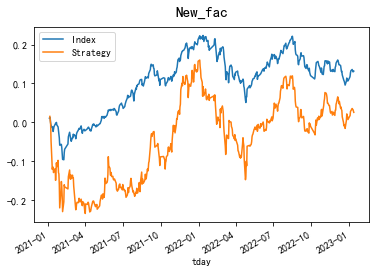

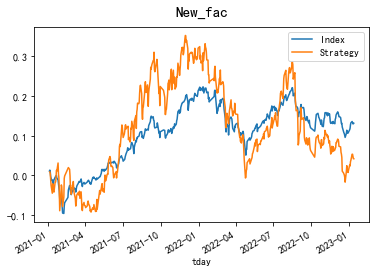

0.0560505607927528 0.07621878723465382
[20, 60] [20, 60] 1 1 3


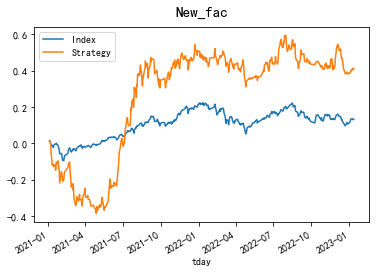

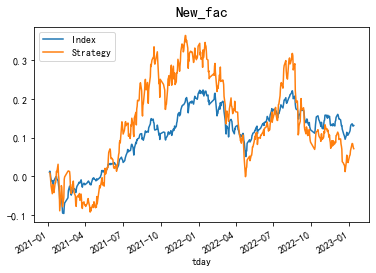

0.5931409716260904 0.12963104239855183
[20, 60] [40, 80] -1 -1 3


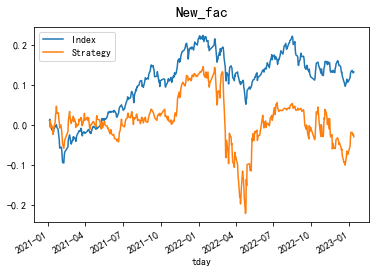

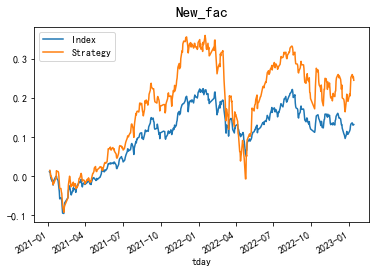

-0.07108576672729887 0.5976122670986846
[20, 60] [40, 80] -1 1 3


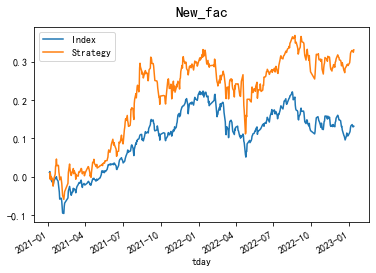

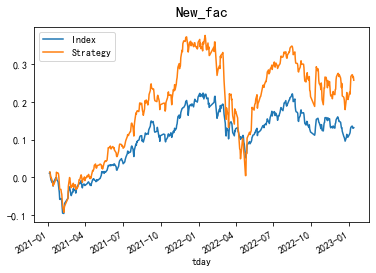

0.8739089383331299 0.6199500929248142
[20, 60] [40, 80] 1 -1 3


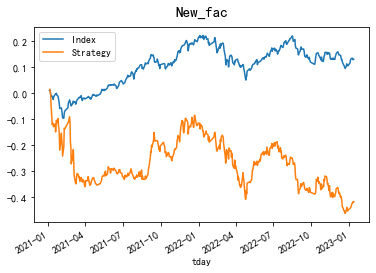

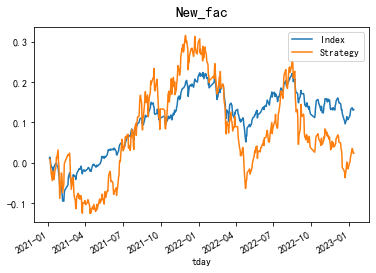

-0.8124378037866229 0.04214799705300031
[20, 60] [40, 80] 1 1 3


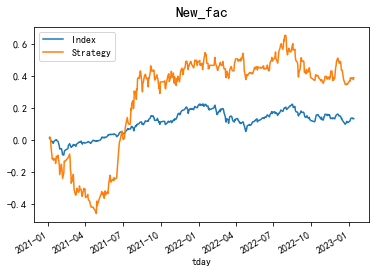

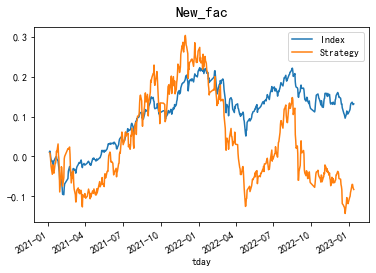

0.5105940522661258 -0.1511222141689971
[20, 60] [60, 120] -1 -1 3


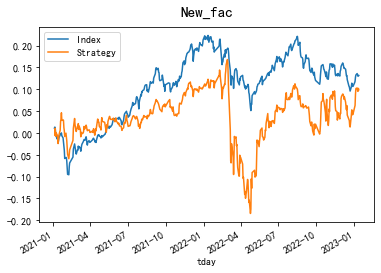

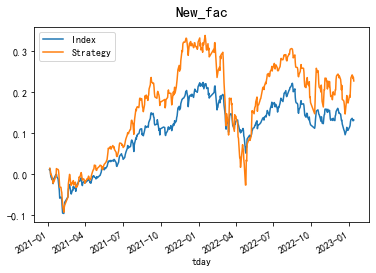

0.2436600035251524 0.5521929340615582
[20, 60] [60, 120] -1 1 3


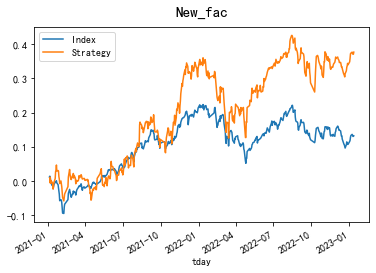

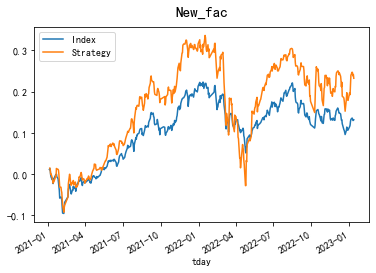

0.8565793130418213 0.5638970944888319
[20, 60] [60, 120] 1 -1 3


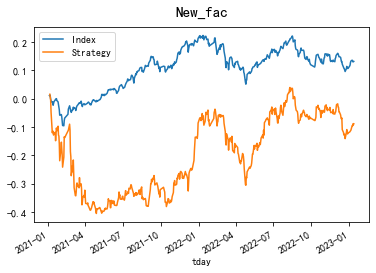

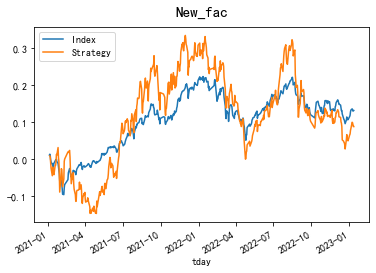

-0.16676830373195012 0.1573621294540533
[20, 60] [60, 120] 1 1 3


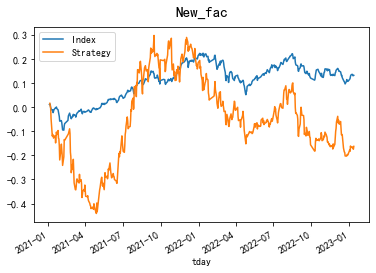

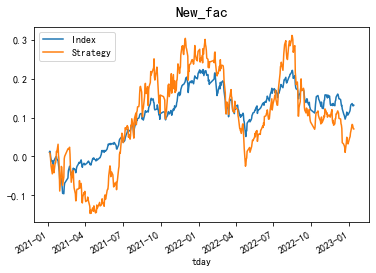

-0.20761590278153294 0.12933851217969944
[40, 80] [1, 5] -1 -1 3


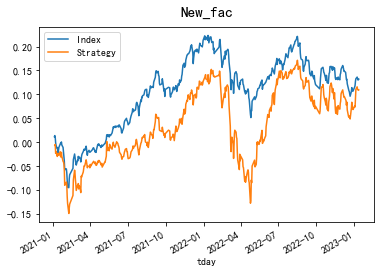

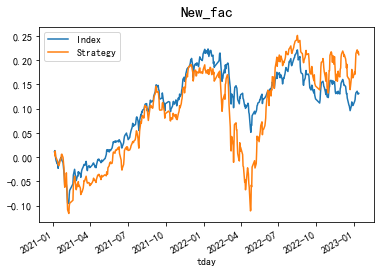

0.3241363394263153 0.5590016760710925
[40, 80] [1, 5] -1 1 3


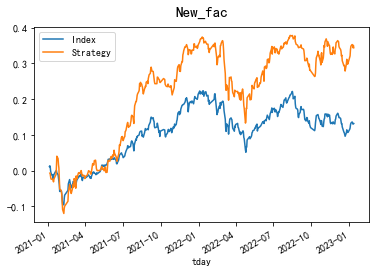

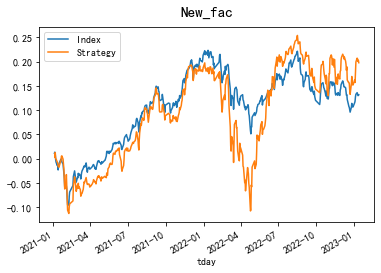

1.0015305257229503 0.5223857924915275
[40, 80] [1, 5] 1 -1 3


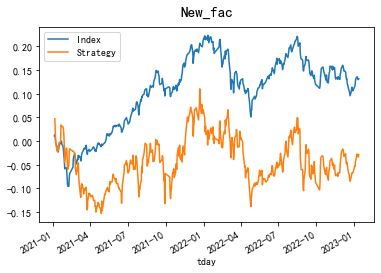

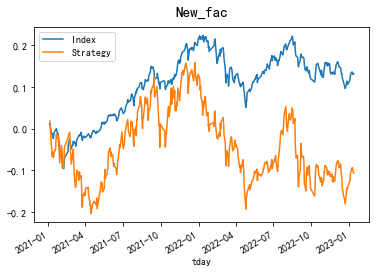

-0.062084023153359334 -0.19572031310380075
[40, 80] [1, 5] 1 1 3


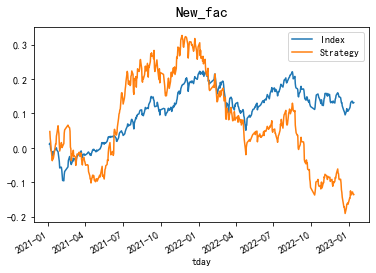

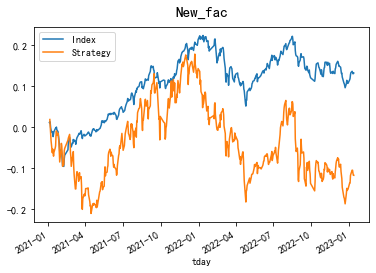

-0.28119087149718697 -0.21777768341993378
[40, 80] [1, 10] -1 -1 3


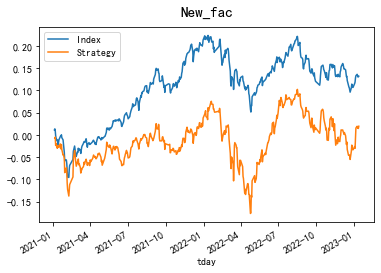

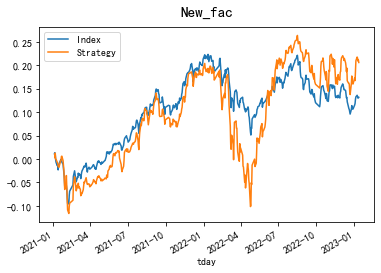

0.0585358602620523 0.5373787473669039
[40, 80] [1, 10] -1 1 3


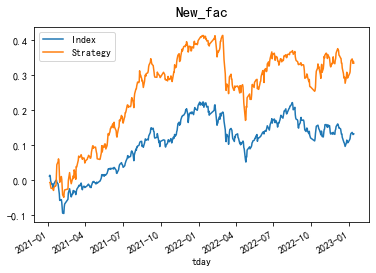

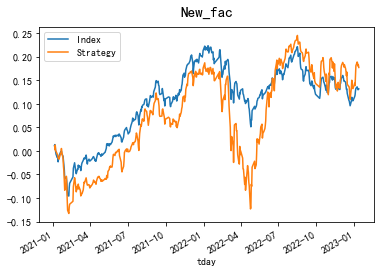

0.9613065535822655 0.4602300516652017
[40, 80] [1, 10] 1 -1 3


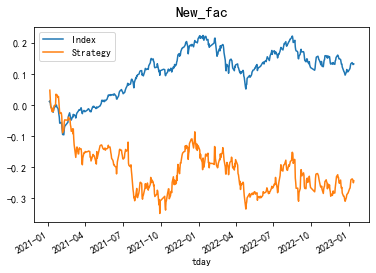

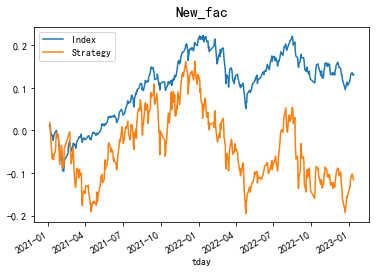

-0.5142826926049822 -0.21268364853638919
[40, 80] [1, 10] 1 1 3


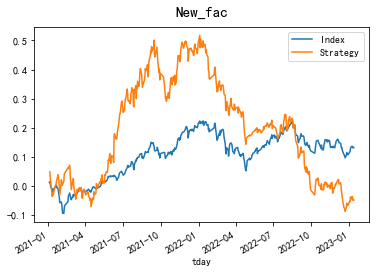

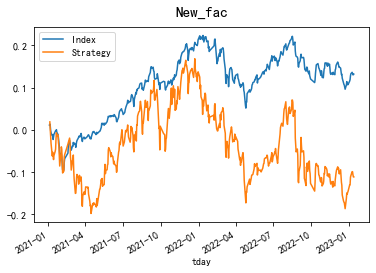

-0.09369835362837942 -0.20737273606427542
[40, 80] [5, 10] -1 -1 3


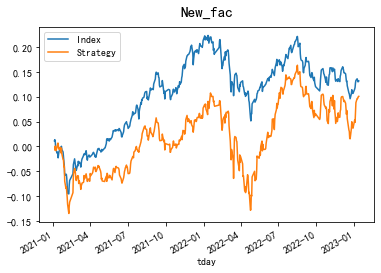

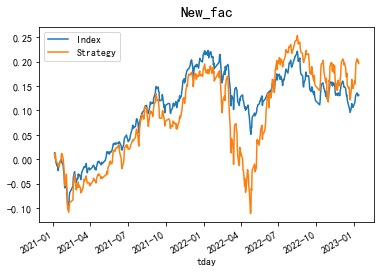

0.3074524080453742 0.5128087692923269
[40, 80] [5, 10] -1 1 3


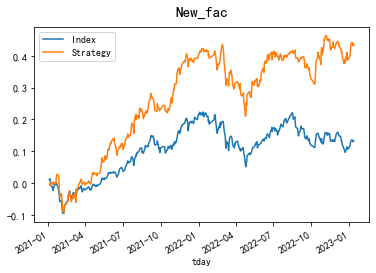

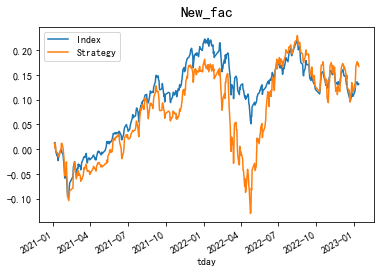

1.2336492612600116 0.4387947849660444
[40, 80] [5, 10] 1 -1 3


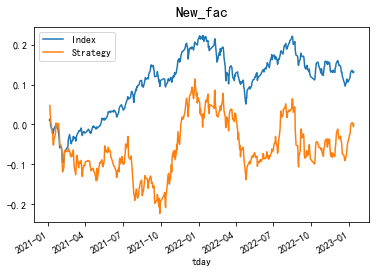

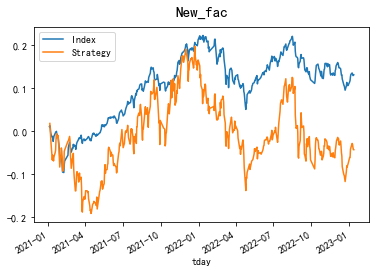

-0.0008558123574984133 -0.07843261754446929
[40, 80] [5, 10] 1 1 3


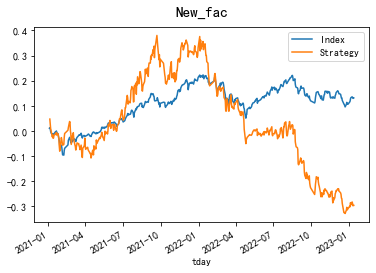

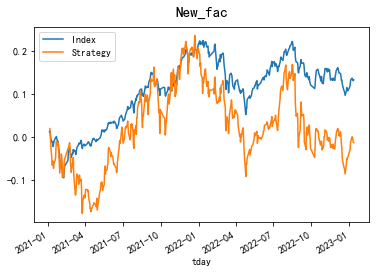

-0.5113597426661811 -0.02575407421169379
[40, 80] [5, 20] -1 -1 3


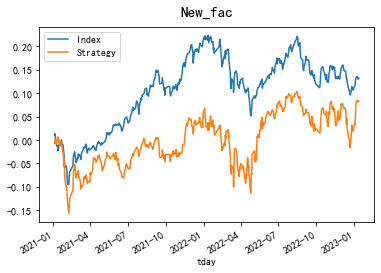

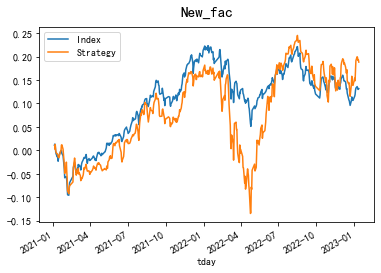

0.25027771184013153 0.4907054575232968
[40, 80] [5, 20] -1 1 3


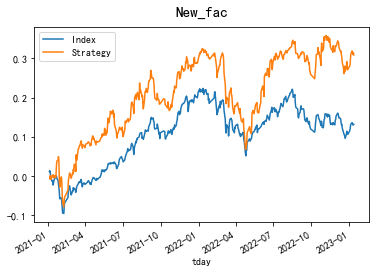

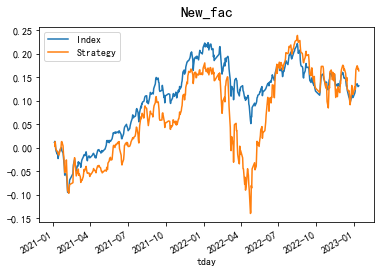

0.8395090755663978 0.4227175630716856
[40, 80] [5, 20] 1 -1 3


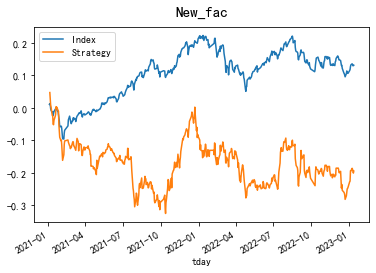

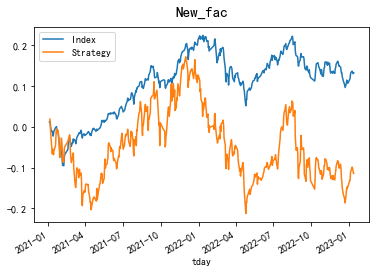

-0.40644927331387315 -0.21045169323993354
[40, 80] [5, 20] 1 1 3


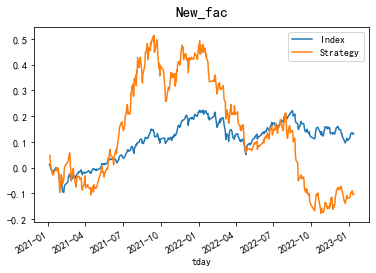

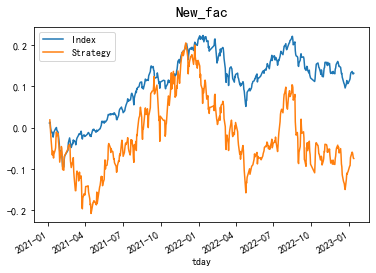

-0.16771030852458887 -0.1378746174938449
[40, 80] [20, 40] -1 -1 3


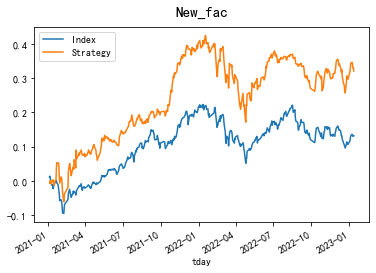

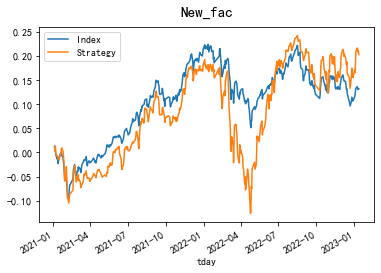

0.8809624189447606 0.525383464646873
[40, 80] [20, 40] -1 1 3


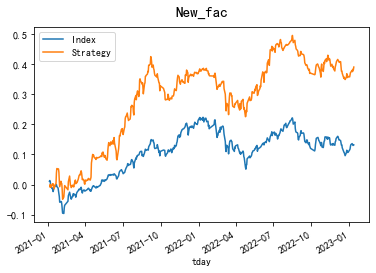

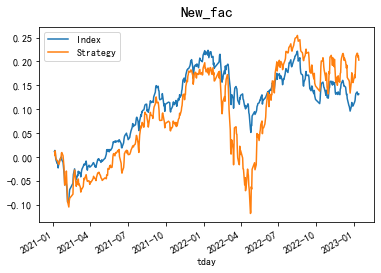

1.0457779790521786 0.5230853742194584
[40, 80] [20, 40] 1 -1 3


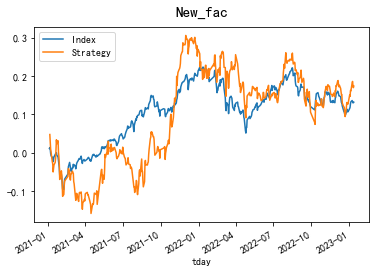

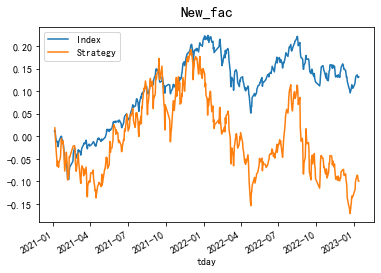

0.35668477090844386 -0.18458438799679985
[40, 80] [20, 40] 1 1 3


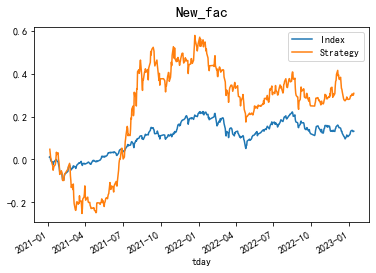

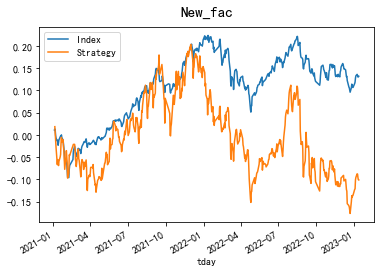

0.4519178129022466 -0.18767150080185457
[40, 80] [20, 60] -1 -1 3


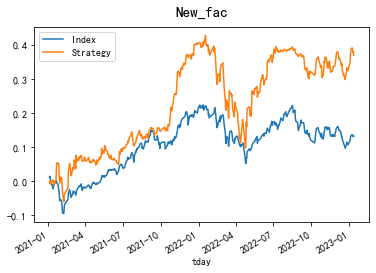

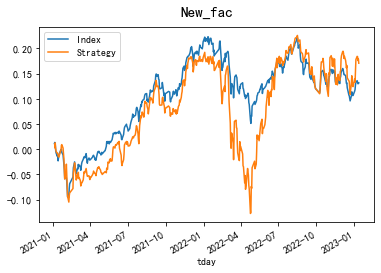

0.8988842912266239 0.44791988823418527
[40, 80] [20, 60] -1 1 3


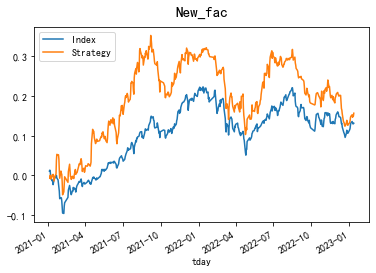

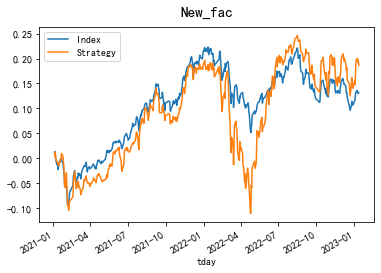

0.41263360926686493 0.48260757481426403
[40, 80] [20, 60] 1 -1 3


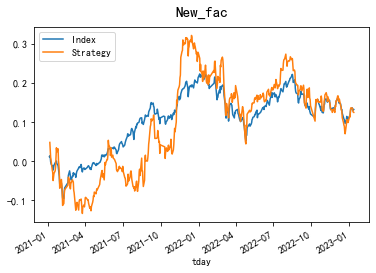

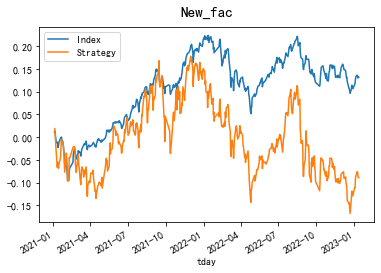

0.2657335701743937 -0.1662402127487834
[40, 80] [20, 60] 1 1 3


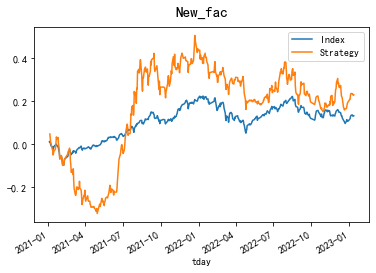

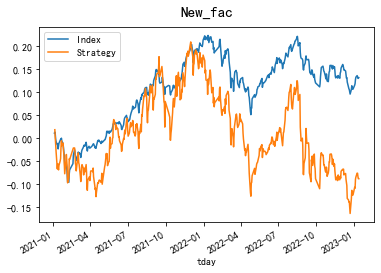

0.3351376015093593 -0.1644806400714769
[40, 80] [40, 80] -1 -1 3


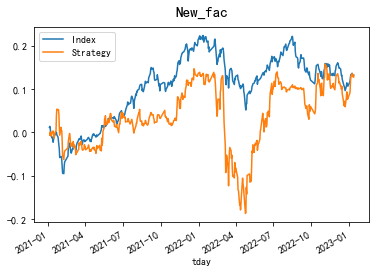

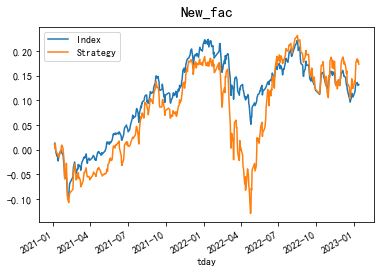

0.30338561999237706 0.44885362116894756
[40, 80] [40, 80] -1 1 3


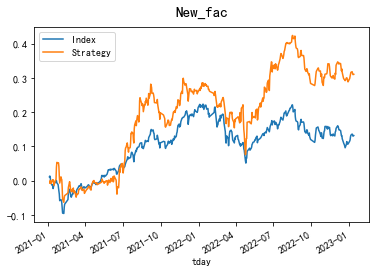

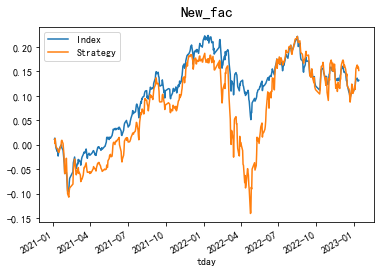

0.8064916992660045 0.39302027597801964
[40, 80] [40, 80] 1 -1 3


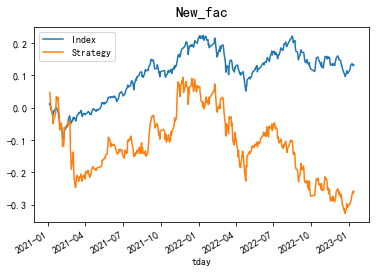

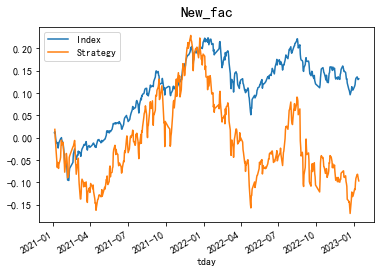

-0.5303564419919787 -0.18392644333370078
[40, 80] [40, 80] 1 1 3


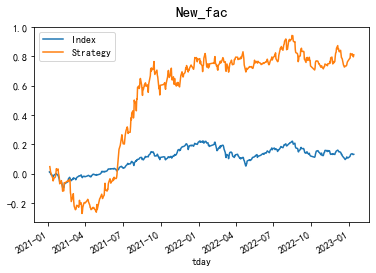

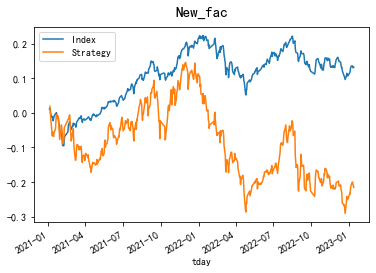

1.083343734372586 -0.4132321212051548
[40, 80] [60, 120] -1 -1 3


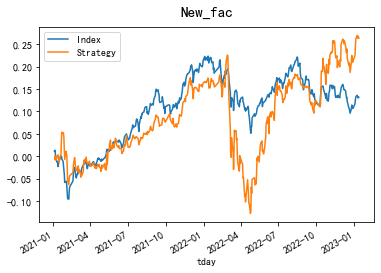

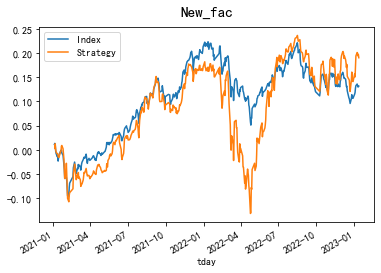

0.6460533907303455 0.49558116041769235
[40, 80] [60, 120] -1 1 3


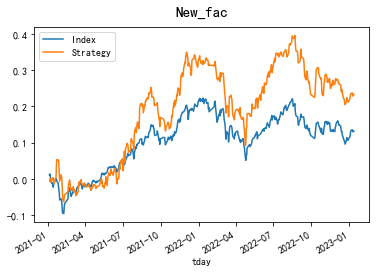

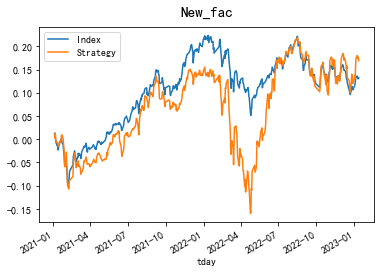

0.6025500011046775 0.44017609289229376
[40, 80] [60, 120] 1 -1 3


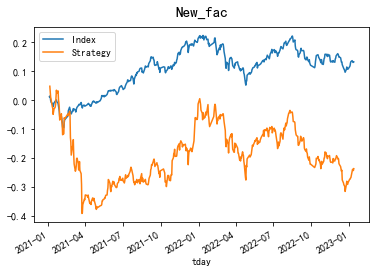

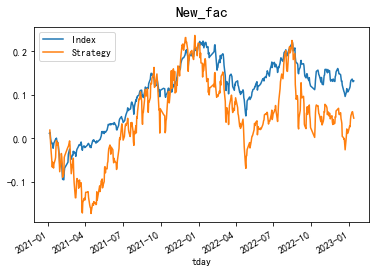

-0.47558800726786815 0.08592718172705763
[40, 80] [60, 120] 1 1 3


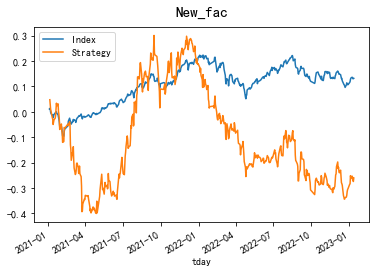

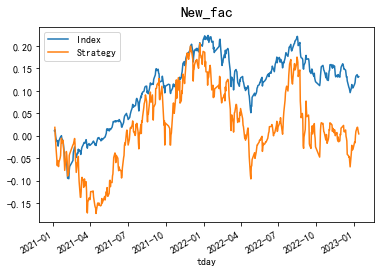

-0.3467882452912928 0.007779459737463032
[60, 120] [1, 5] -1 -1 3


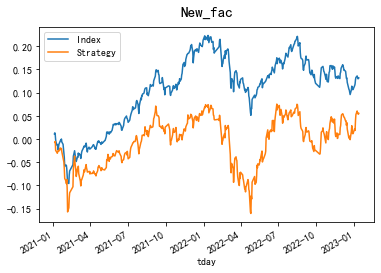

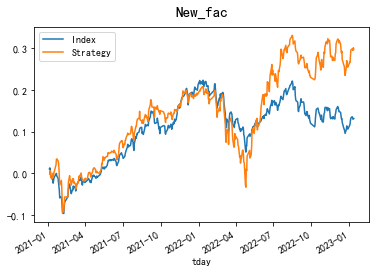

0.17455882114031512 0.8700490840281112
[60, 120] [1, 5] -1 1 3


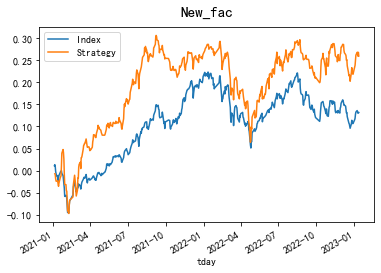

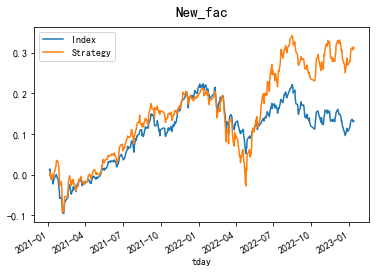

0.8102305930538346 0.9041363902268196
[60, 120] [1, 5] 1 -1 3


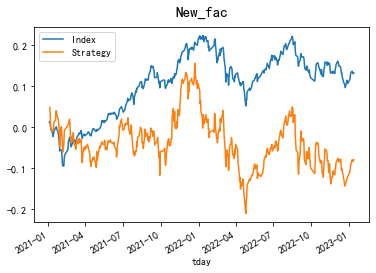

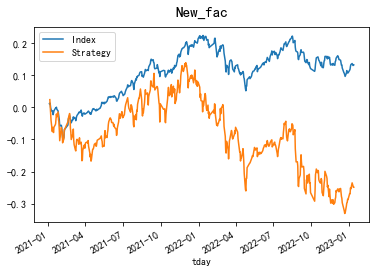

-0.16300294788348 -0.45034971756640024
[60, 120] [1, 5] 1 1 3


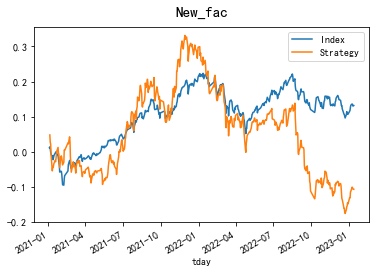

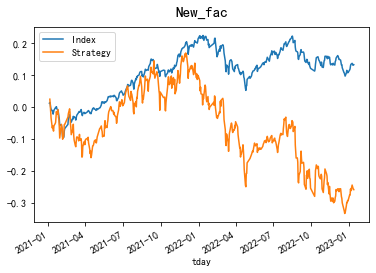

-0.22547916730735593 -0.4671377491217661
[60, 120] [1, 10] -1 -1 3


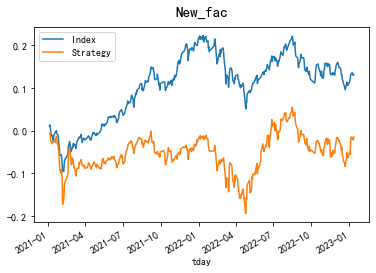

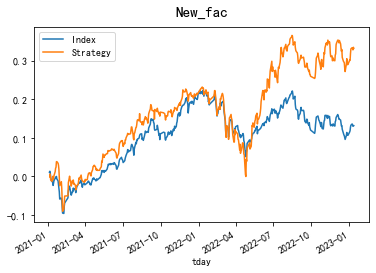

-0.04554936206561442 0.9617315114085636
[60, 120] [1, 10] -1 1 3


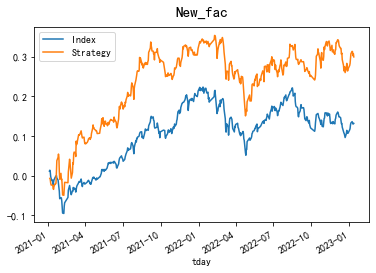

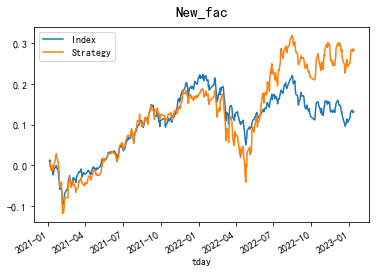

0.8871051597707631 0.822874904906871
[60, 120] [1, 10] 1 -1 3


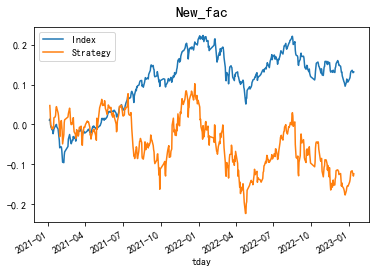

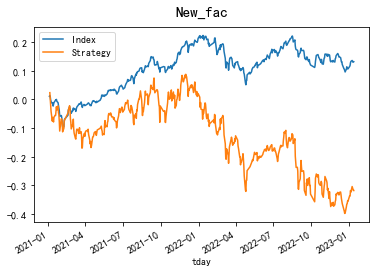

-0.24693122538419274 -0.5740809278008783
[60, 120] [1, 10] 1 1 3


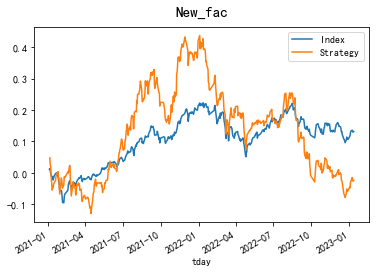

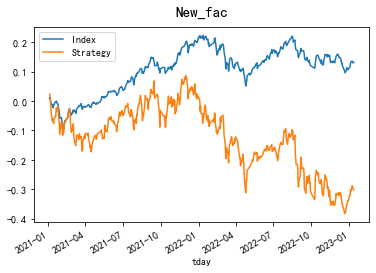

-0.048090459934582094 -0.547780063391309
[60, 120] [5, 10] -1 -1 3


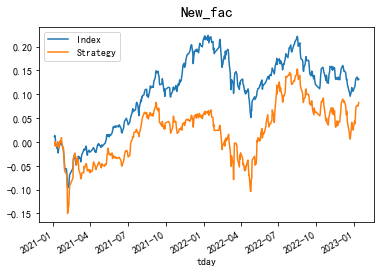

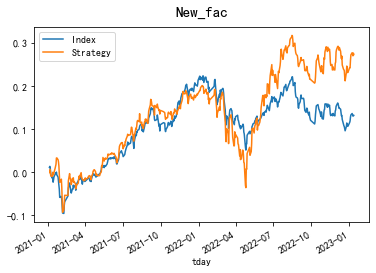

0.2670969548341836 0.7983474388522036
[60, 120] [5, 10] -1 1 3


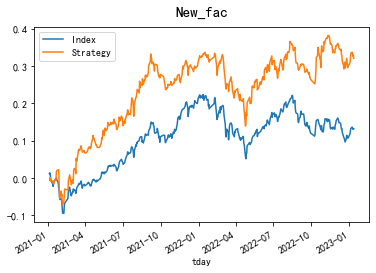

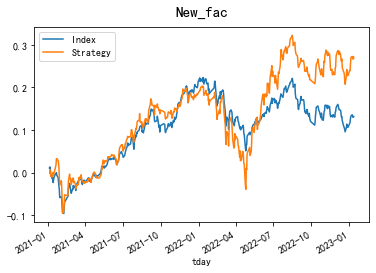

0.9438700077220177 0.7793631510687701
[60, 120] [5, 10] 1 -1 3


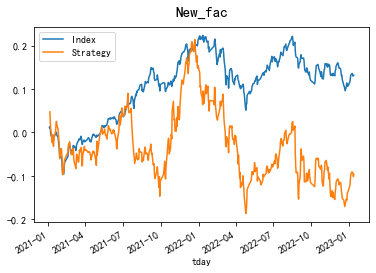

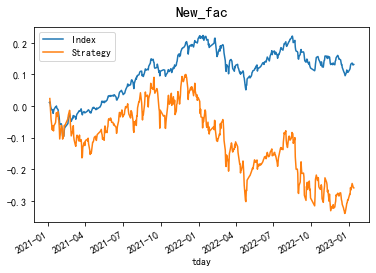

-0.19349155516747335 -0.46818342009178904
[60, 120] [5, 10] 1 1 3


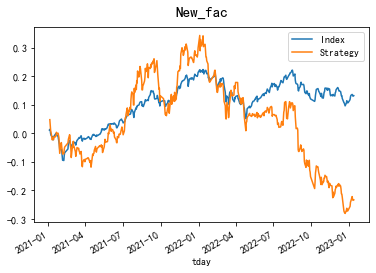

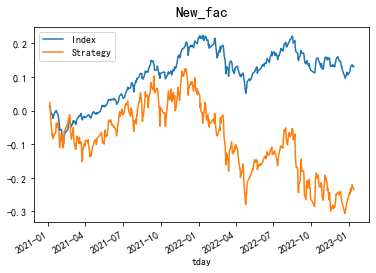

-0.4290892542843258 -0.42933884969630826
[60, 120] [5, 20] -1 -1 3


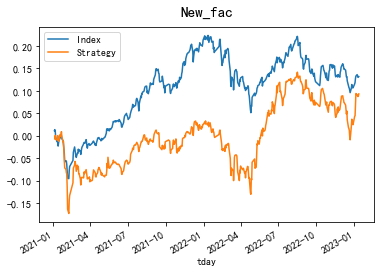

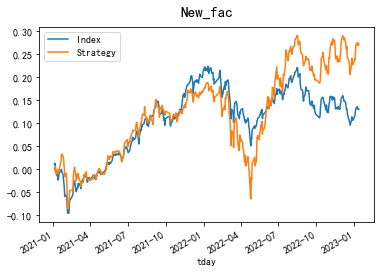

0.30518902840689927 0.794400725652376
[60, 120] [5, 20] -1 1 3


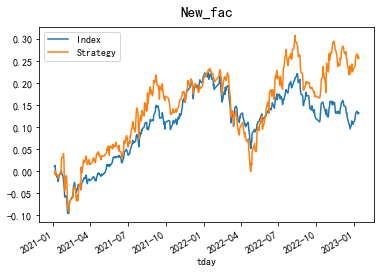

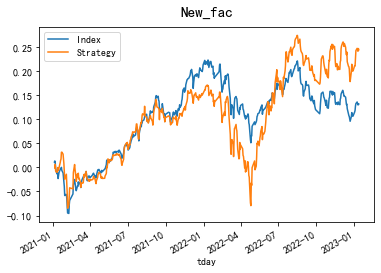

0.6776343224449374 0.712611115629846
[60, 120] [5, 20] 1 -1 3


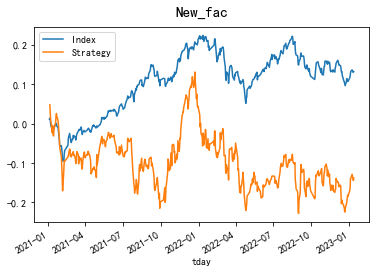

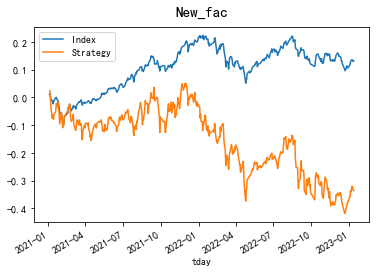

-0.26707940858472135 -0.6048317158878851
[60, 120] [5, 20] 1 1 3


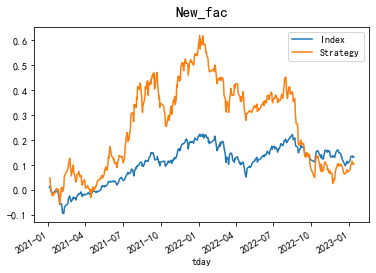

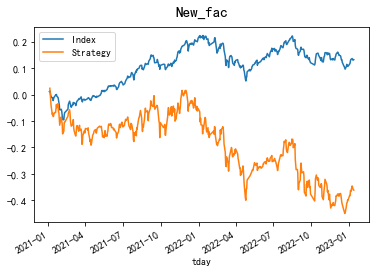

0.17515271265718071 -0.6512329560589853
[60, 120] [20, 40] -1 -1 3


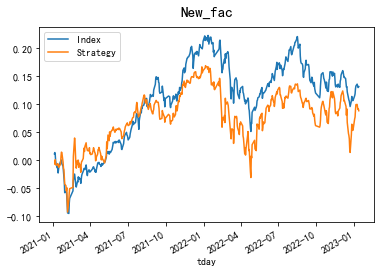

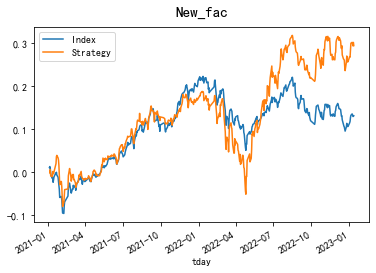

0.2940396696519252 0.8498091860697351
[60, 120] [20, 40] -1 1 3


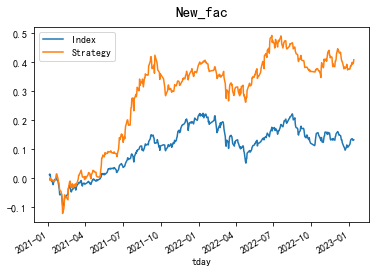

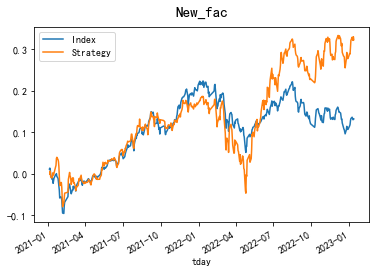

1.0822226168060234 0.92503535755261
[60, 120] [20, 40] 1 -1 3


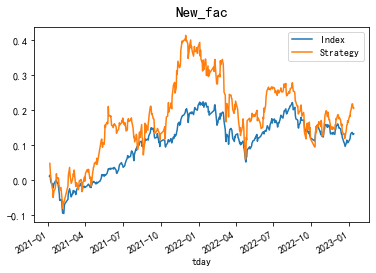

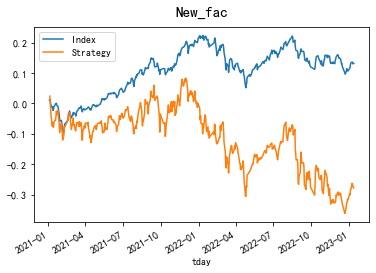

0.39832521661939957 -0.5101580950555358
[60, 120] [20, 40] 1 1 3


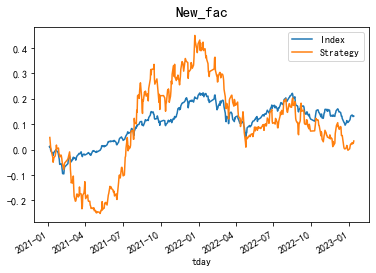

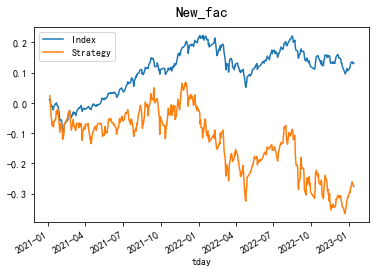

0.052742150011528745 -0.5056613689212622
[60, 120] [20, 60] -1 -1 3


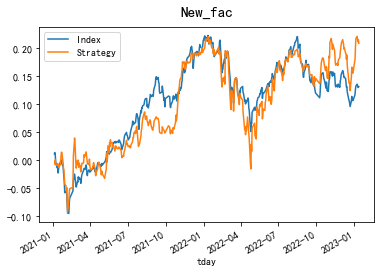

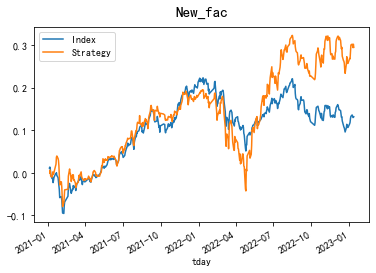

0.6139351907498751 0.8505856926119999
[60, 120] [20, 60] -1 1 3


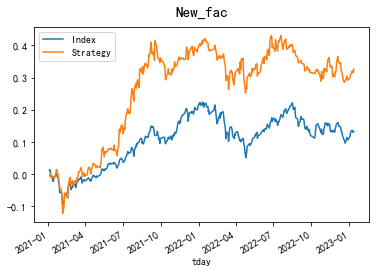

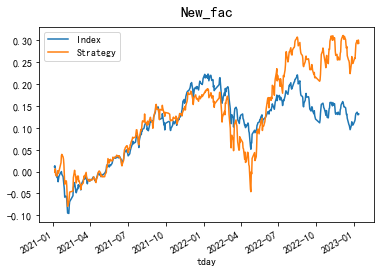

0.8366469259728733 0.8470864337258864
[60, 120] [20, 60] 1 -1 3


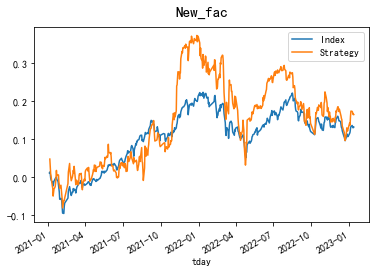

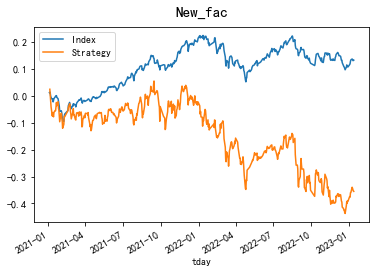

0.3338281949463023 -0.6599644496249982
[60, 120] [20, 60] 1 1 3


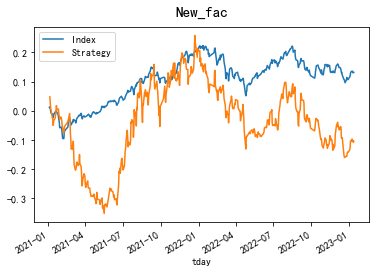

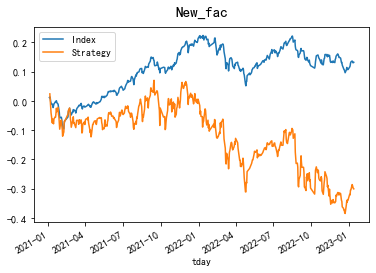

-0.15674213956202335 -0.5577667187558877
[60, 120] [40, 80] -1 -1 3


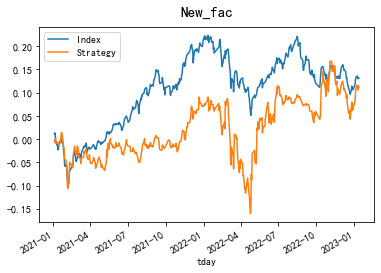

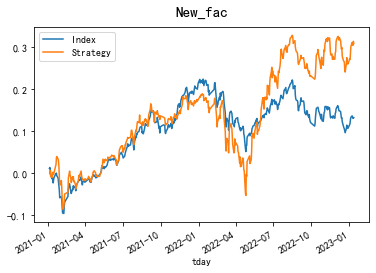

0.29113275037887915 0.8774921495641729
[60, 120] [40, 80] -1 1 3


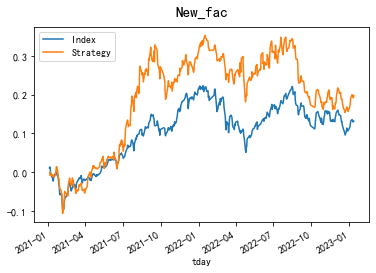

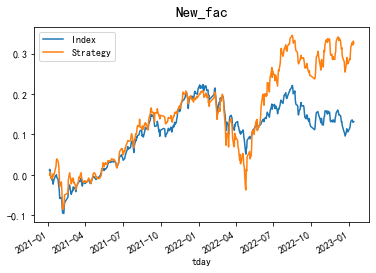

0.5152047368691182 0.9220504554379853
[60, 120] [40, 80] 1 -1 3


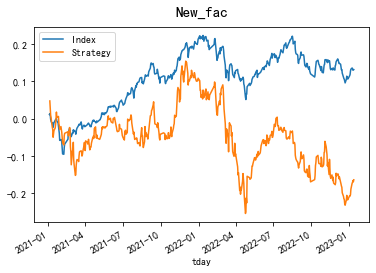

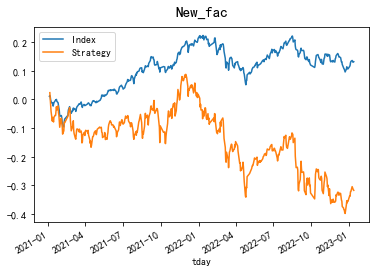

-0.33786133424154174 -0.5912998267586728
[60, 120] [40, 80] 1 1 3


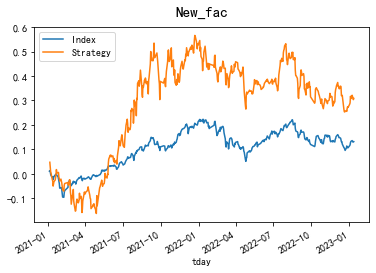

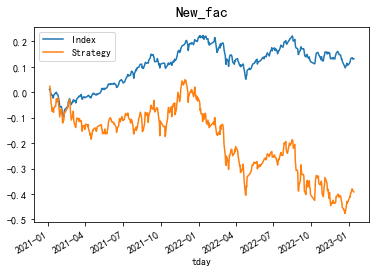

0.4319001518466225 -0.7362758148371956
[60, 120] [60, 120] -1 -1 3


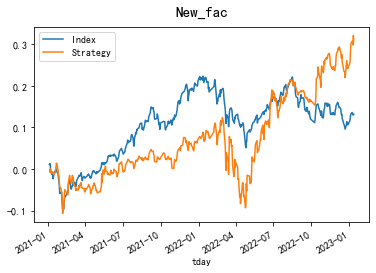

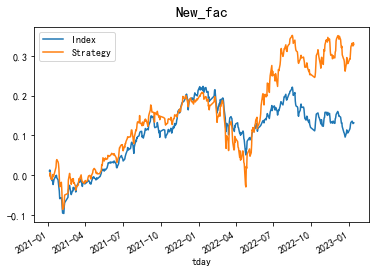

0.8319334723778464 0.9318563219843337
[60, 120] [60, 120] -1 1 3


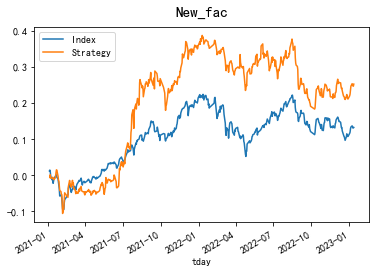

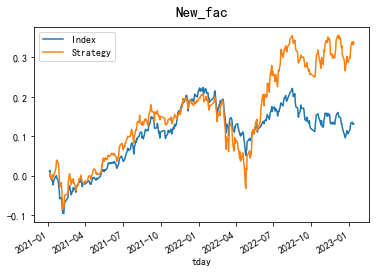

0.6754109465937466 0.9471643326903415
[60, 120] [60, 120] 1 -1 3


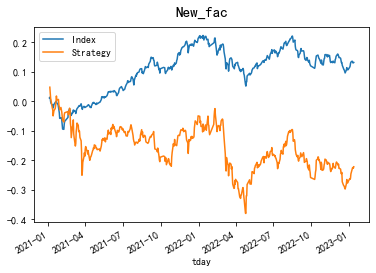

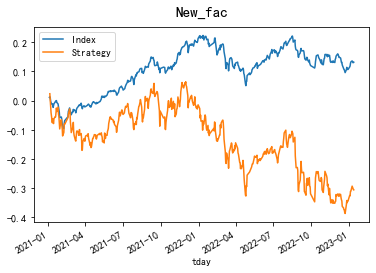

-0.48237380795213813 -0.5701856505713083
[60, 120] [60, 120] 1 1 3


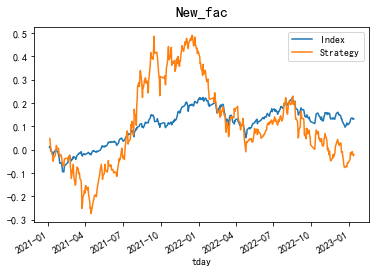

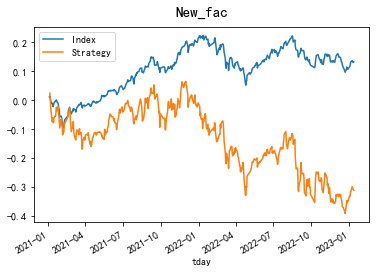

-0.029807704156861622 -0.589501256297724


In [3319]:
s1_list = []
s2_list = []
try_outs = [[1,5],[1,10],[5,10],[5,20],[20,40],[20,60],[40,80],[60,120]]
for bond_arg in try_outs:
    for indus_arg in try_outs:
        for bond_direction in [-1,1]:
            for ind_direction in [-1,1]:
                s1,s2 = brutal_search(bond_arg,indus_arg,bond_direction,ind_direction,3)
                s1_list.append(s1)
                s2_list.append(s2)
                print(s1,s2)

In [3320]:
np.array([8,8])

array([8, 8])

In [3328]:
mm=np.zeros([8,8])
mr=np.zeros([8,8])
rm=np.zeros([8,8])
rr=np.zeros([8,8])
All = [mm,mr,rm,rr]
posi = 0
for bond_arg in try_outs:
    for indus_arg in try_outs:
        for bond_direction in [-1,1]:
            for ind_direction in [-1,1]:
                res = s1_list[posi]
                all_index = 0
                if bond_direction==1:
                    if ind_direction==-1:
                        All_index=1
                    else:
                        All_index=0
                else:
                    if ind_direction==-1:
                        All_index=2
                    else:
                        All_index=3
                bond_posi = try_outs.index(bond_arg)
                ind_posi = try_outs.index(indus_arg)
                All[All_index][bond_posi][ind_posi] = res
                posi+=1

In [3342]:
[str(i) for i in try_outs]

['[1, 5]',
 '[1, 10]',
 '[5, 10]',
 '[5, 20]',
 '[20, 40]',
 '[20, 60]',
 '[40, 80]',
 '[60, 120]']

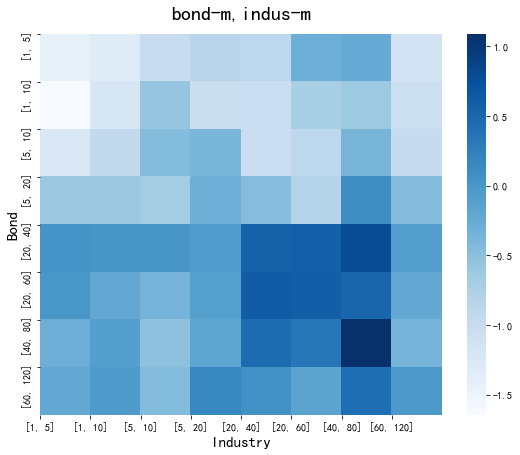

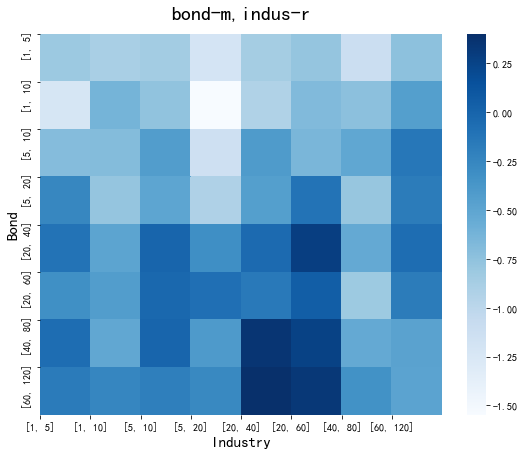

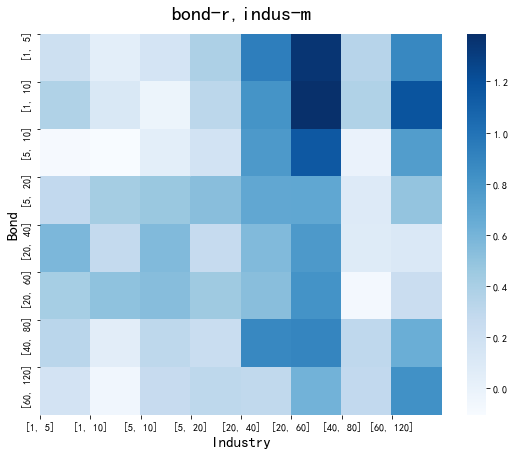

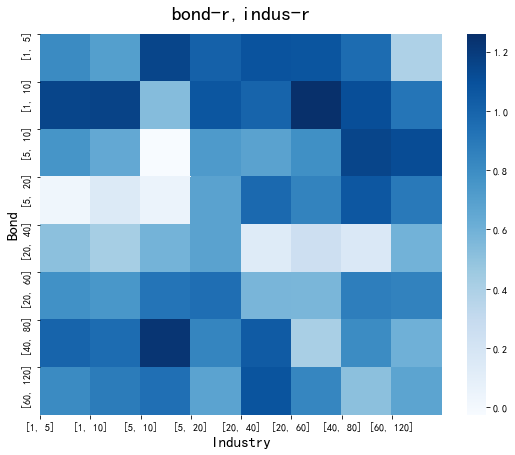

In [3358]:
def draw_heatmap(data,title):
    plt.figure(figsize=(9,7))
    sns.heatmap(pd.DataFrame(data),cmap='Blues')
    plt.xticks(np.arange(0,8),[str(i) for i in try_outs])
    plt.yticks(np.arange(0,8),[str(i) for i in try_outs])
    plt.xlabel('Industry',fontsize=15)
    plt.ylabel('Bond',fontsize=15)
    plt.title(title,fontsize=20,pad=15)
    plt.show()
draw_heatmap(All[0],'bond-m,indus-m')
draw_heatmap(All[1],'bond-m,indus-r')
draw_heatmap(All[2],'bond-r,indus-m')
draw_heatmap(All[3],'bond-r,indus-r')

[1, 10] [20, 40] -1 -1 3


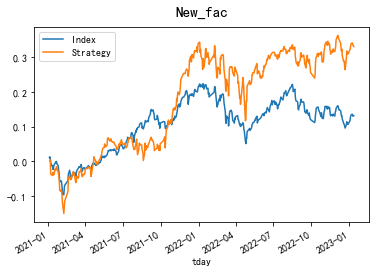

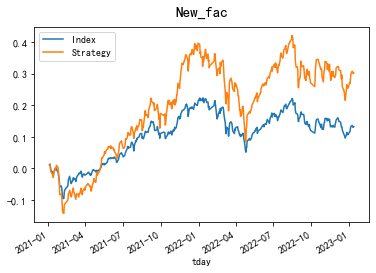

(0.8137595985786065, 0.6708868924508959)

In [3373]:
brutal_search([1,10],[20,40],-1,-1,3)

[40, 80] [40, 80] 1 1 3


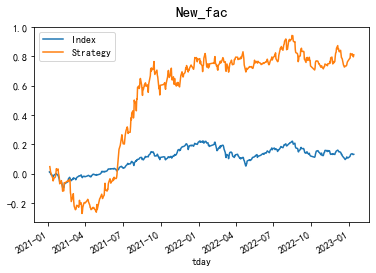

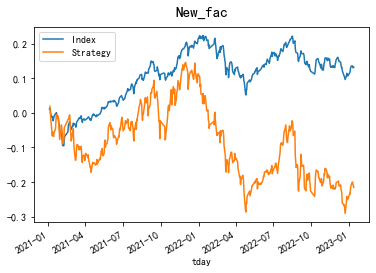

(1.083343734372586, -0.4132321212051548)

In [3363]:
brutal_search([40,80],[40,80],1,1,3)

[1, 5] [20, 60] -1 1 3


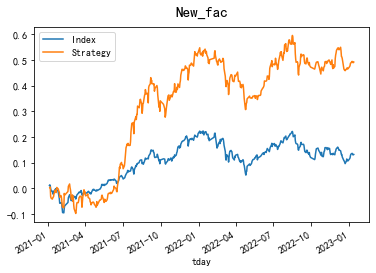

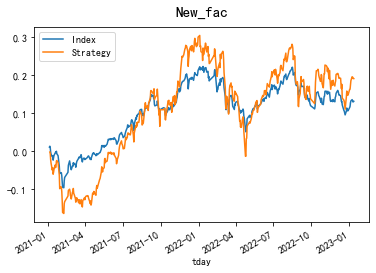

(1.0772718035694933, 0.4325423325717165)

In [3360]:
brutal_search([1,5],[20,60],-1,1,3)

[1, 10] [20, 60] -1 1 3


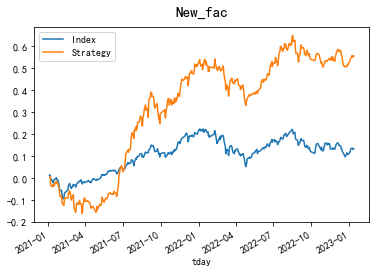

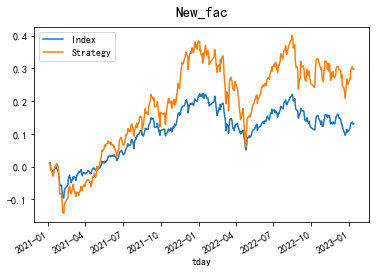

(1.2591660704864887, 0.657220607630284)

In [3376]:
brutal_search([1,10],[20,60],-1,1,3,0.5,0.5)

[5, 20] [20, 60] -1 1 3


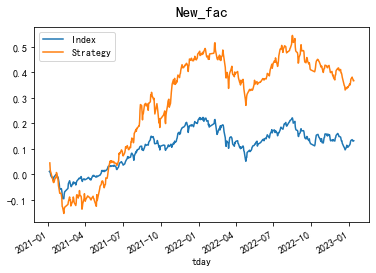

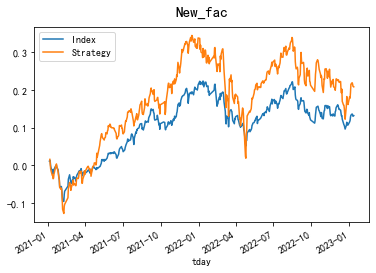

(0.8479894486876705, 0.47083034620397013)

In [3366]:
brutal_search([5,20],[20,60],-1,1,3)

In [3176]:
data_for_bt_pro.corr().round(4)[['ChangePCT_shift','ma5/ma20']].sort_values(by='ChangePCT_shift')#.ChangePCT_shift

,ChangePCT_shift,ma5/ma20
ma5/ma20,-0.0370,1.0000
MA_5,-0.0306,0.0357
MA_20,-0.0262,-0.0550
MA5_20,-0.0260,0.4984
MA_60,-0.0254,-0.0976
MA_80,-0.0240,-0.1003
Bond_cum_ret,-0.0226,0.0435
ChangePCT,-0.0158,0.0366
DEA_20,-0.0144,-0.0048
DIFF_20_80,-0.0096,0.1289


In [3177]:
#按照各个行业的收益进行轮动的探究
def f(x):
    return (x.sort_values().reset_index()['行业分类简洁'])
    return x
data_for_bt_pro.set_index('tday').groupby('行业分类简洁').resample('2M').ChangePCT.sum().reset_index().pivot(index='tday',columns='行业分类简洁').apply(f,axis=1)


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
tday,,,,,,,,,,,,,,,,,,
2021-01-31,汽车,TMT,消费之衣食住行用,传统基建,医药生物,新基建,环保产业,农林牧渔,机械设备,金融,军工,轻工制造,新能源汽车,采掘与初加工,半导体,化工材料与产品,交通运输,风电光伏
2021-03-31,医药生物,农林牧渔,军工,金融,半导体,新能源汽车,交通运输,化工材料与产品,风电光伏,新基建,机械设备,采掘与初加工,汽车,消费之衣食住行用,TMT,轻工制造,传统基建,环保产业
2021-05-31,农林牧渔,交通运输,轻工制造,环保产业,半导体,新基建,机械设备,军工,风电光伏,金融,采掘与初加工,化工材料与产品,传统基建,医药生物,TMT,新能源汽车,汽车,消费之衣食住行用
2021-07-31,消费之衣食住行用,轻工制造,医药生物,金融,农林牧渔,交通运输,环保产业,机械设备,军工,新基建,化工材料与产品,采掘与初加工,汽车,传统基建,风电光伏,半导体,TMT,新能源汽车
2021-09-30,TMT,半导体,医药生物,汽车,农林牧渔,交通运输,机械设备,军工,采掘与初加工,轻工制造,金融,新能源汽车,消费之衣食住行用,新基建,化工材料与产品,风电光伏,传统基建,环保产业
2021-11-30,金融,环保产业,交通运输,农林牧渔,采掘与初加工,轻工制造,风电光伏,军工,半导体,消费之衣食住行用,传统基建,新基建,化工材料与产品,机械设备,新能源汽车,医药生物,TMT,汽车
2022-01-31,新能源汽车,汽车,风电光伏,机械设备,军工,新基建,化工材料与产品,采掘与初加工,轻工制造,半导体,环保产业,消费之衣食住行用,交通运输,TMT,金融,农林牧渔,医药生物,传统基建
2022-03-31,TMT,汽车,新能源汽车,风电光伏,消费之衣食住行用,传统基建,化工材料与产品,环保产业,金融,新基建,半导体,轻工制造,医药生物,机械设备,军工,交通运输,农林牧渔,采掘与初加工
2022-05-31,医药生物,农林牧渔,半导体,采掘与初加工,机械设备,军工,轻工制造,金融,新基建,传统基建,新能源汽车,交通运输,汽车,化工材料与产品,TMT,消费之衣食住行用,环保产业,风电光伏


In [3179]:
data_for_bt_pro.columns

Index(['InnerCode', 'tday', 'ma5/ma20', 'ChangePCT', 'ChangePCT_shift',
       'Bond_cum_ret', 'MA_5', 'MA_20', 'MA_60', 'MA_80', 'MA5_20', 'MA20_80',
       'MA20_60', 'DIFF_20_80', 'DEA_20', 'MACD', 'MA5_20_w', 'MA20_80_w',
       'MA20_60_w', 'MACD_w', 'ChiName', 'WindCode', '行业分类一级', '行业分类简洁'],
      dtype='object')

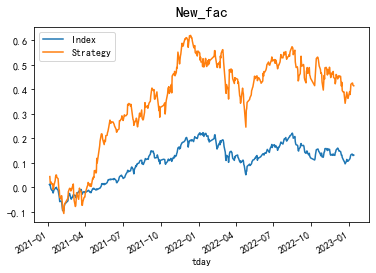

In [3180]:
data_for_bt_pro['New_fac'] = data_for_bt_pro['ma5/ma20']
dt_rev = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

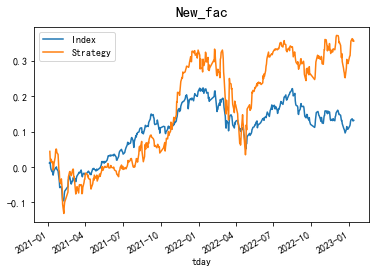

In [3181]:
data_for_bt_pro['New_fac'] = data_for_bt_pro.groupby('tday')['ma5/ma20'].rank(pct=True)+\
                        data_for_bt_pro.groupby('tday')['MA20_60'].rank(pct=True)
dt_rev_20_60 = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

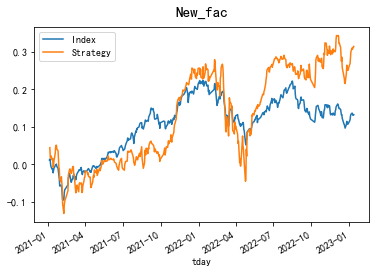

In [3182]:
data_for_bt_pro['New_fac'] = data_for_bt_pro.groupby('tday')['ma5/ma20'].rank(pct=True)+\
                        data_for_bt_pro.groupby('tday')['MA20_80'].rank(pct=True)
dt_rev_20_80 = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

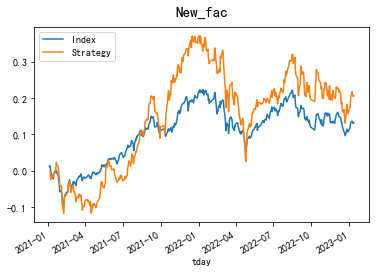

In [3183]:
data_for_bt_pro['New_fac'] = data_for_bt_pro.groupby('tday')['ma5/ma20'].rank(pct=True)+\
                        data_for_bt_pro.groupby('tday')['MA20_60_w'].rank(pct=True)
dt_rev_20_60_w = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

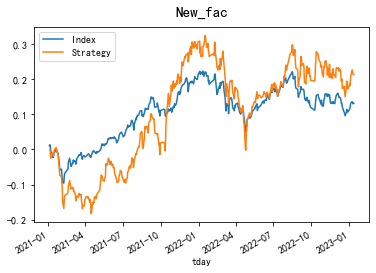

In [3184]:
data_for_bt_pro['New_fac'] = data_for_bt_pro.groupby('tday')['ma5/ma20'].rank(pct=True)+\
                        data_for_bt_pro.groupby('tday')['MA20_80_w'].rank(pct=True)
dt_rev_20_80_w = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

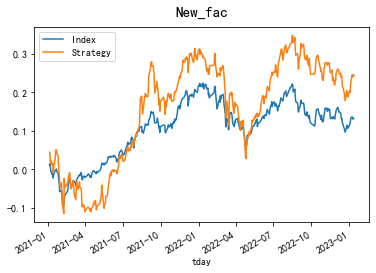

In [3185]:
data_for_bt_pro['New_fac'] = data_for_bt_pro.groupby('tday')['ma5/ma20'].rank(pct=True)-\
                        data_for_bt_pro.groupby('tday')['MACD'].rank(pct=True)
dt_rev_MACD = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

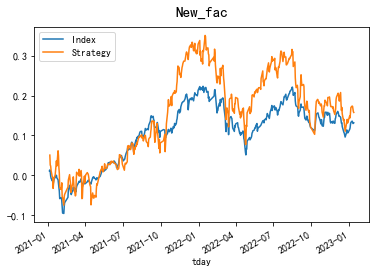

In [3186]:
data_for_bt_pro['New_fac'] = data_for_bt_pro.groupby('tday')['ma5/ma20'].rank(pct=True)-\
                        data_for_bt_pro.groupby('tday')['MACD_w'].rank(pct=True)
dt_rev_MACD_w = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

In [3187]:
dt_rev_20_80[dt_rev_20_80.tday==datetime(2023,1,10)].dropna(subset=['hld_ret'])

,行业分类一级,InnerCode,WindCode,ChiName,ChangePCT,tday,New_fac,sig_ma,shift_sig,hld_sig,hld_ret
32979,采掘与初加工,234456.0,113027.SH,华钰转债,-0.0118,2023-01-10,0.201278,NaN,NaN,True,-0.0118
37322,采掘与初加工,255266.0,113545.SH,金能转债,-0.0086,2023-01-10,0.009585,True,True,True,-0.0086
63660,采掘与初加工 军工,300286.0,128109.SZ,楚江转债,-0.0014,2023-01-10,0.265176,NaN,NaN,True,-0.0014
100209,采掘与初加工,337107.0,127027.SZ,靖远转债,-0.0102,2023-01-10,0.031949,NaN,True,True,-0.0102
104177,采掘与初加工,339635.0,113615.SH,金诚转债,0.0184,2023-01-10,0.194888,NaN,NaN,True,0.0184
109749,新能源汽车,350462.0,118000.SH,嘉元转债,-0.0076,2023-01-10,0.003195,True,True,True,-0.0076
112769,风电光伏,357190.0,127030.SZ,盛虹转债,-0.0002,2023-01-10,0.469649,NaN,NaN,True,-0.0002
119639,新能源汽车,372965.0,127036.SZ,三花转债,0.0030,2023-01-10,0.271565,NaN,NaN,True,0.003
131462,风电光伏,421631.0,113053.SH,隆22转债,-0.0083,2023-01-10,0.019169,True,True,True,-0.0083
132295,采掘与初加工 新能源汽车,431496.0,113641.SH,华友转债,-0.0015,2023-01-10,0.309904,NaN,NaN,True,-0.0015


In [3188]:
dt_rev[dt_rev.tday==datetime(2023,1,10)].dropna(subset=['hld_ret'])

,行业分类一级,InnerCode,WindCode,ChiName,ChangePCT,tday,New_fac,sig_ma,shift_sig,hld_sig,hld_ret
2277,化工材料与产品,149818.0,128017.SZ,金禾转债,-0.0051,2023-01-10,0.033058,NaN,True,True,-0.0051
4980,医药生物,155258.0,128025.SZ,特一转债,0.0163,2023-01-10,0.002755,True,True,True,0.0163
15130,轻工制造 新能源汽车,183924.0,123012.SZ,万顺转债,-0.0024,2023-01-10,0.283747,NaN,NaN,True,-0.0024
29687,采掘与初加工 传统基建 新能源汽车,223692.0,113534.SH,鼎胜转债,-0.0126,2023-01-10,0.804408,NaN,NaN,True,-0.0126
48033,医药生物,271202.0,128091.SZ,新天转债,-0.0112,2023-01-10,0.011019,True,True,True,-0.0112
69570,化工材料与产品,304996.0,123057.SZ,美联转债,0.0182,2023-01-10,0.685950,NaN,NaN,True,0.0182
83549,医药生物,314768.0,113601.SH,塞力转债,-0.0030,2023-01-10,0.013774,True,True,True,-0.003
85835,医药生物,316969.0,123064.SZ,万孚转债,0.0021,2023-01-10,0.008264,True,True,True,0.0021
100855,轻工制造 新能源汽车,337394.0,123085.SZ,万顺转2,-0.0027,2023-01-10,0.504132,NaN,NaN,True,-0.0027
105661,医药生物,341498.0,127028.SZ,英特转债,-0.0038,2023-01-10,0.005510,True,True,True,-0.0038


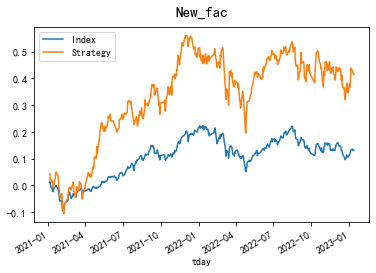

In [3189]:
def f(x,args):
    thres,direction = args[0],args[1]
    if direction=='rev':
        try:
            thres = x.sort_values().unique()[-3]
        except:
            thres=x.max()
        return (x<=thres).replace(False,np.nan)
    else:
        try:
            thres = x.sort_values().unique()[3]
        except:
            thres=x.min()
        return (x>=thres).replace(False,np.nan)
data_for_bt_pro['Ind_mask'] = data_for_bt_pro.groupby('tday')['MA20_80'].apply(f,(3,'rev'))
data_for_bt_pro['New_fac'] = data_for_bt_pro['Ind_mask']*data_for_bt_pro['ma5/ma20']
dt_rev_20_80_mask = cal_performance(data_for_bt_pro,'New_fac',quantile=0.02)

In [3190]:
def eval_group(df_list,legend):
    df_ret_list = [i.groupby('tday').hld_ret.mean() for i in df_list]
    rdf = pd.DataFrame([df_list[0].groupby('tday').ChangePCT.mean()]+df_ret_list).T
    #print(rdf)
    rdf.columns = ['index']+legend
    cum(rdf).plot(figsize=(15,8))
    res = pd.DataFrame([rdf.mean()*252,rdf.std()*np.sqrt(252),rdf.mean()*np.sqrt(252)/rdf.std()],index=['Ret','Vol','Sharpe'])
    return res.round(3)

,index,Rev,Rev_20_60,Rev_20_80,Rev_20_60_w,Rev_20_80_w
Ret,0.067,0.212,0.182,0.160,0.105,0.109
Vol,0.121,0.304,0.240,0.237,0.227,0.238
Sharpe,0.557,0.697,0.759,0.675,0.463,0.457


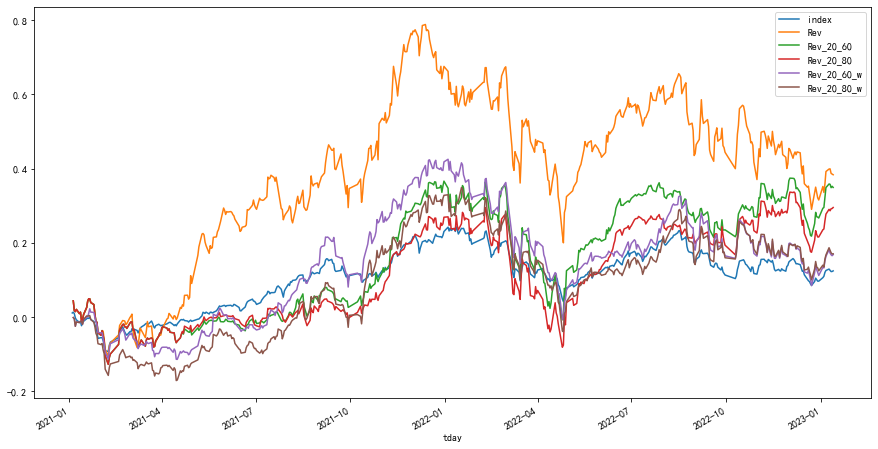

In [3191]:
eval_group([dt_rev,dt_rev_20_60,dt_rev_20_80,dt_rev_20_60_w,dt_rev_20_80_w],
          ['Rev','Rev_20_60','Rev_20_80','Rev_20_60_w','Rev_20_80_w'])

,index,Rev,Rev_MACD,Rev_MACD_w
Ret,0.067,0.212,0.125,0.081
Vol,0.121,0.304,0.223,0.242
Sharpe,0.557,0.697,0.561,0.333


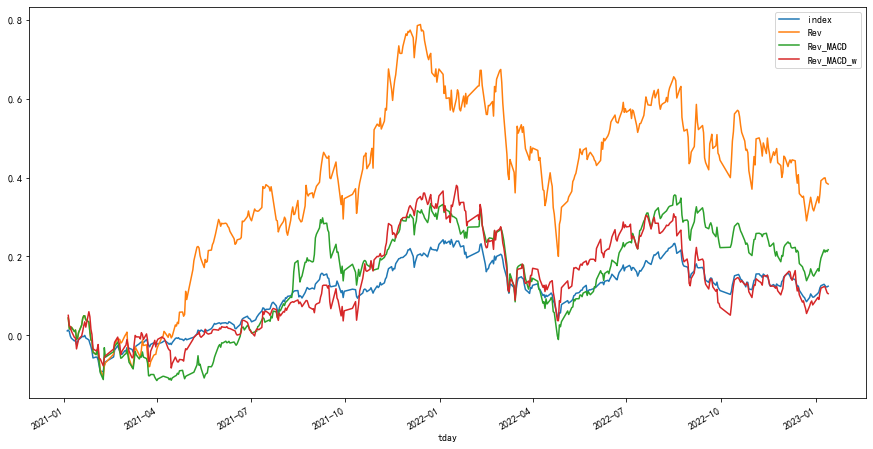

In [3192]:
eval_group([dt_rev,dt_rev_MACD,dt_rev_MACD_w],
          ['Rev','Rev_MACD','Rev_MACD_w'])


In [3193]:
dt_rev_20_80_w[dt_rev_20_80_w.tday==datetime(2023,1,10)].dropna(subset=['hld_ret'])

,行业分类一级,InnerCode,WindCode,ChiName,ChangePCT,tday,New_fac,sig_ma,shift_sig,hld_sig,hld_ret
4980,医药生物,155258.0,128025.SZ,特一转债,0.0163,2023-01-10,0.090062,NaN,NaN,True,0.0163
15130,轻工制造 新能源汽车,183924.0,123012.SZ,万顺转债,-0.0024,2023-01-10,0.149068,NaN,True,True,-0.0024
21575,消费之衣食住行用,211665.0,113527.SH,维格转债,-0.0027,2023-01-10,0.015528,True,True,True,-0.0027
24418,消费之衣食住行用,219851.0,110055.SH,伊力转债,-0.0152,2023-01-10,0.229814,NaN,NaN,True,-0.0152
45149,消费之衣食住行用,268391.0,128087.SZ,孚日转债,-0.0449,2023-01-10,0.372671,NaN,NaN,True,-0.0449
49021,农林牧渔,272028.0,127015.SZ,希望转债,-0.0034,2023-01-10,0.027950,NaN,True,True,-0.0034
50992,农林牧渔,280290.0,113565.SH,宏辉转债,-0.0053,2023-01-10,0.006211,True,True,True,-0.0053
66120,农林牧渔,302469.0,128114.SZ,正邦转债,-0.0063,2023-01-10,0.003106,True,True,True,-0.0063
82181,新能源汽车,314194.0,110074.SH,精达转债,-0.0080,2023-01-10,0.394410,NaN,NaN,True,-0.008
85835,医药生物,316969.0,123064.SZ,万孚转债,0.0021,2023-01-10,0.096273,NaN,NaN,True,0.0021


In [2658]:
dt_rev_20_80_w.merge(jy2wind(list(dt.InnerCode)),left_on='InnerCode',right_index=True).to_excel('反转+行业_先算指标再平均.xlsx')

In [ ]:
#不要重新读取数据，计算指标，看看为什莫选择的债券数量差异很大。试一试排除最不好的行业进行择券

In [2041]:
data_part = (cdata[(cdata.tday>=datetime(2022,1,1)) & (cdata.tday<=datetime(2023,1,15))]
       ).merge(merge_code,left_on='InnerCode',right_index=True,how='left').merge(
    ht_sec,left_on = 'WindCode',right_on='代码',how='left').drop(columns=['代码','证券简称','行业分类']).dropna(
    subset={'行业分类一级'})


In [2042]:
sec_mean_price = data_part.groupby(['行业分类一级','tday']).ClosePrice.mean().reset_index().sort_values(by=['行业分类一级','tday'],ascending=True)
#.rolling(window=5).mean()
sec_mean_price['pct_change'] = sec_mean_price.groupby(['行业分类一级']).ClosePrice.pct_change(30)
sec_mean_price['MA_5_20'] = (sec_mean_price.groupby(['行业分类一级']).ClosePrice.rolling(window=5,min_periods = 1).mean()/sec_mean_price.groupby(['行业分类一级']).ClosePrice.rolling(window=20,min_periods = 1).mean()).values
sec_mean_price['MA_20_60'] = (sec_mean_price.groupby(['行业分类一级']).ClosePrice.rolling(window=20,min_periods = 1).mean()/sec_mean_price.groupby(['行业分类一级']).ClosePrice.rolling(window=60,min_periods = 1).mean()).values
sec_mean_price['MA_20'] = sec_mean_price.groupby(['行业分类一级']).ClosePrice.rolling(window=20,min_periods = 1).mean().values
sec_mean_price['MA_60'] = sec_mean_price.groupby(['行业分类一级']).ClosePrice.rolling(window=60,min_periods = 1).mean().values
sec_mean_price['DIFF_20_60'] = sec_mean_price['MA_20'] - sec_mean_price['MA_60']
sec_mean_price['DEA_10'] = sec_mean_price.groupby(['行业分类一级']).DIFF_20_60.rolling(window=10,min_periods = 1).mean().values
sec_mean_price['MACD'] = sec_mean_price['DIFF_20_60'] - sec_mean_price['DEA_10']

In [2043]:
def f(x):
    return (pd.Series(x.sort_values().reset_index().行业分类一级))
    return x
ma2060_round = sec_mean_price[['tday','行业分类一级','MA_20_60']].pivot(columns='行业分类一级',index='tday').resample('M').mean().rank(axis=1).apply(f,axis=1)
macd_round = sec_mean_price[['tday','行业分类一级','MACD']].pivot(columns='行业分类一级',index='tday').resample('M').mean().rank(axis=1).apply(f,axis=1)
pct_round = sec_mean_price[['tday','行业分类一级','pct_change']].pivot(columns='行业分类一级',index='tday').resample('M').mean().rank(axis=1).apply(f,axis=1)

In [2044]:
pct_round 

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
tday,,,,,,,,,,,,,,,,,,
2022-01-31,TMT,交通运输,传统基建,军工,农林牧渔,化工材料与产品,医药生物,半导体,新基建,新能源汽车,机械设备,汽车,消费之衣食住行用,环保产业,轻工制造,采掘与初加工,金融,风电光伏
2022-02-28,新能源汽车,半导体,TMT,风电光伏,机械设备,医药生物,消费之衣食住行用,军工,农林牧渔,轻工制造,汽车,传统基建,新基建,金融,化工材料与产品,交通运输,环保产业,采掘与初加工
2022-03-31,新能源汽车,TMT,风电光伏,半导体,汽车,军工,化工材料与产品,机械设备,新基建,采掘与初加工,消费之衣食住行用,传统基建,轻工制造,金融,交通运输,环保产业,医药生物,农林牧渔
2022-04-30,风电光伏,军工,新能源汽车,化工材料与产品,汽车,TMT,新基建,机械设备,半导体,采掘与初加工,环保产业,轻工制造,医药生物,消费之衣食住行用,传统基建,交通运输,金融,农林牧渔
2022-05-31,化工材料与产品,军工,农林牧渔,采掘与初加工,医药生物,半导体,风电光伏,TMT,新基建,机械设备,轻工制造,金融,新能源汽车,传统基建,消费之衣食住行用,环保产业,交通运输,汽车
2022-06-30,金融,医药生物,农林牧渔,交通运输,传统基建,环保产业,轻工制造,消费之衣食住行用,TMT,半导体,新基建,采掘与初加工,机械设备,军工,化工材料与产品,新能源汽车,风电光伏,汽车
2022-07-31,金融,传统基建,交通运输,TMT,医药生物,消费之衣食住行用,半导体,环保产业,新基建,轻工制造,采掘与初加工,机械设备,风电光伏,农林牧渔,新能源汽车,化工材料与产品,军工,汽车
2022-08-31,医药生物,金融,军工,农林牧渔,传统基建,交通运输,消费之衣食住行用,化工材料与产品,TMT,新基建,机械设备,轻工制造,环保产业,新能源汽车,采掘与初加工,风电光伏,汽车,半导体
2022-09-30,化工材料与产品,新能源汽车,采掘与初加工,风电光伏,军工,机械设备,轻工制造,汽车,新基建,TMT,消费之衣食住行用,环保产业,医药生物,农林牧渔,半导体,传统基建,交通运输,金融


In [2062]:
macd_round

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
tday,,,,,,,,,,,,,,,,,,
2022-01-31,TMT,采掘与初加工,轻工制造,环保产业,消费之衣食住行用,汽车,机械设备,新能源汽车,新基建,半导体,医药生物,化工材料与产品,农林牧渔,军工,传统基建,交通运输,金融,风电光伏
2022-02-28,新能源汽车,半导体,军工,TMT,医药生物,风电光伏,机械设备,汽车,化工材料与产品,消费之衣食住行用,轻工制造,农林牧渔,新基建,传统基建,采掘与初加工,环保产业,金融,交通运输
2022-03-31,新能源汽车,风电光伏,军工,化工材料与产品,TMT,采掘与初加工,汽车,半导体,机械设备,新基建,传统基建,交通运输,环保产业,金融,消费之衣食住行用,轻工制造,农林牧渔,医药生物
2022-04-30,风电光伏,军工,化工材料与产品,新基建,汽车,环保产业,医药生物,机械设备,采掘与初加工,轻工制造,传统基建,半导体,消费之衣食住行用,交通运输,TMT,金融,农林牧渔,新能源汽车
2022-05-31,农林牧渔,医药生物,金融,交通运输,采掘与初加工,轻工制造,消费之衣食住行用,传统基建,环保产业,化工材料与产品,新基建,机械设备,半导体,TMT,军工,汽车,风电光伏,新能源汽车
2022-06-30,金融,交通运输,传统基建,医药生物,农林牧渔,环保产业,消费之衣食住行用,轻工制造,TMT,半导体,新基建,机械设备,采掘与初加工,汽车,新能源汽车,军工,风电光伏,化工材料与产品
2022-07-31,TMT,交通运输,消费之衣食住行用,传统基建,金融,汽车,半导体,机械设备,新能源汽车,新基建,风电光伏,环保产业,轻工制造,医药生物,采掘与初加工,化工材料与产品,军工,农林牧渔
2022-08-31,军工,农林牧渔,化工材料与产品,新能源汽车,医药生物,消费之衣食住行用,新基建,交通运输,机械设备,金融,传统基建,轻工制造,汽车,风电光伏,采掘与初加工,环保产业,TMT,半导体
2022-09-30,化工材料与产品,风电光伏,新能源汽车,采掘与初加工,汽车,半导体,机械设备,军工,轻工制造,新基建,环保产业,TMT,消费之衣食住行用,农林牧渔,医药生物,传统基建,交通运输,金融


In [2046]:
ddf = sec_mean_price.copy()

In [2047]:
sec_mean_price.drop(columns=['ClosePrice'],inplace=True)

In [2048]:
data_part = data_part.merge(sec_mean_price,on=['行业分类一级','tday'],how='left')

In [2049]:
data_part['ChangePCT_s'] = data_part.groupby('InnerCode').ChangePCT.shift(-1)

In [2050]:
#data_part.corr()[['ChangePCT_s','ma5/ma20']]

In [2051]:
def uni(x):
    return (x - x.min())/(x.max()-x.min())
data_part['fac_rev'] = data_part.groupby(['tday'])['ma5/ma20'].rank(pct=True,ascending=True)
data_part['fac_MACD'] = data_part.groupby(['tday'])['MACD'].rank(pct=True,ascending=True)
data_part['fac_MA_5_20'] = data_part.groupby(['tday'])['MA_5_20'].rank(pct=True,ascending=True)
data_part['fac_MA_20_60'] = data_part.groupby(['tday'])['MA_20_60'].rank(pct=True,ascending=True)

data_part['fac_rev_MA_5_20'] = (1*data_part['fac_rev'] + 1*data_part['fac_MA_5_20']).rank(pct=True,ascending=True)
data_part['fac_rev_MA_20_60'] = (1*data_part['fac_rev'] + 1*data_part['fac_MA_20_60']).rank(pct=True,ascending=True)
data_part['fac_rev_MACD'] = (1*data_part['fac_rev'] - 1*data_part['fac_MACD']).rank(pct=True,ascending=True)
data_part['fac_rev_MACD_20_60'] = (2*data_part['fac_rev'] - data_part['fac_MACD'] + data_part['fac_MA_20_60'] ).rank(pct=True,ascending=True)


In [2052]:
data_part.corr().loc[['fac_rev_MA_5_20','fac_rev_MA_20_60','fac_rev_MACD',
                  'fac_rev_MACD_20_60','fac_rev','fac_MACD','ChangePCT_s'],['fac_rev_MA_5_20','fac_rev_MA_20_60','fac_rev_MACD',
                  'fac_rev_MACD_20_60','fac_rev','fac_MACD','ChangePCT_s']].round(4)

,fac_rev_MA_5_20,fac_rev_MA_20_60,fac_rev_MACD,fac_rev_MACD_20_60,fac_rev,fac_MACD,ChangePCT_s
fac_rev_MA_5_20,1.0000,0.7212,0.2756,0.6464,0.8280,0.5116,-0.0160
fac_rev_MA_20_60,0.7212,1.0000,0.3814,0.8711,0.7560,0.3049,-0.0193
fac_rev_MACD,0.2756,0.3814,1.0000,0.7706,0.6188,-0.5695,-0.0226
fac_rev_MACD_20_60,0.6464,0.8711,0.7706,1.0000,0.8521,-0.0730,-0.0251
fac_rev,0.8280,0.7560,0.6188,0.8521,1.0000,0.2608,-0.0254
fac_MACD,0.5116,0.3049,-0.5695,-0.0730,0.2608,1.0000,0.0011
ChangePCT_s,-0.0160,-0.0193,-0.0226,-0.0251,-0.0254,0.0011,1.0000


In [2053]:
def get_hld(data_part,fac_name):
    data_part['sig_ma'] = (data_part[fac_name] < 0.02).replace(False,np.nan)
    data_part['shift_sig'] = data_part.groupby('InnerCode')['sig_ma'].shift(1)
    data_part['hld_'+fac_name] = data_part.groupby('InnerCode')['shift_sig'].ffill(limit=4)
    data_part['hld_'+fac_name] = data_part['hld_'+fac_name]*data_part['ChangePCT']/100
    data_part#.drop(columns=['sig_ma','shift_sig'])
    return data_part
    #data_part['rev_sec_sig'] = ((data_part.rev_fac+data_part.sec_fac)/2 < 0.02).replace(False,np.nan)

In [2054]:
data_part = get_hld(data_part,'fac_rev')
data_part = get_hld(data_part,'fac_rev_MA_5_20')
data_part = get_hld(data_part,'fac_rev_MA_20_60')
data_part = get_hld(data_part,'fac_rev_MACD')
data_part = get_hld(data_part,'fac_rev_MACD_20_60')

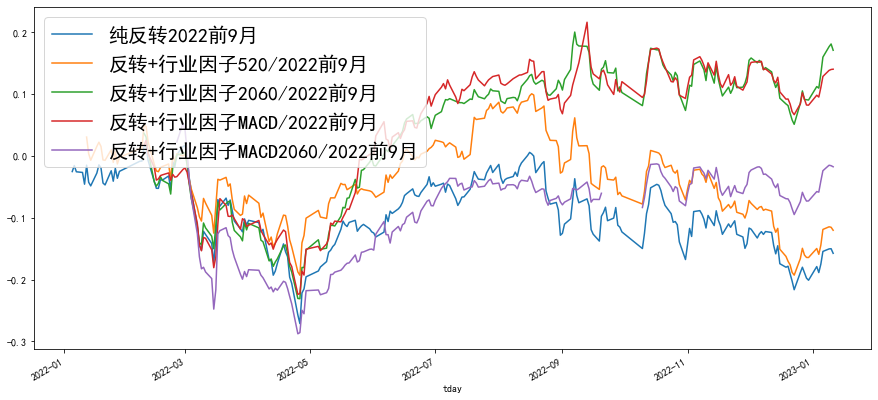

In [2055]:
def cum(x):
    return (1+x).cumprod()-1
cum(data_part.groupby('tday').hld_fac_rev.mean()).plot(figsize=(15,7))
cum(data_part.groupby('tday').hld_fac_rev_MA_5_20.mean()).plot()
cum(data_part.groupby('tday').hld_fac_rev_MA_20_60.mean()).plot()
cum(data_part.groupby('tday').hld_fac_rev_MACD.mean()).plot()
cum(data_part.groupby('tday').hld_fac_rev_MACD_20_60.mean()).plot()
plt.legend(['纯反转2022前9月','反转+行业因子520/2022前9月','反转+行业因子2060/2022前9月','反转+行业因子MACD/2022前9月','反转+行业因子MACD2060/2022前9月'],fontsize=20)


In [2056]:
#data_part[(data_part.SecuAbbr=='金禾转债')&(~data_part.hld_rev_fac.isna())].sort_values(by='ChangePCT')

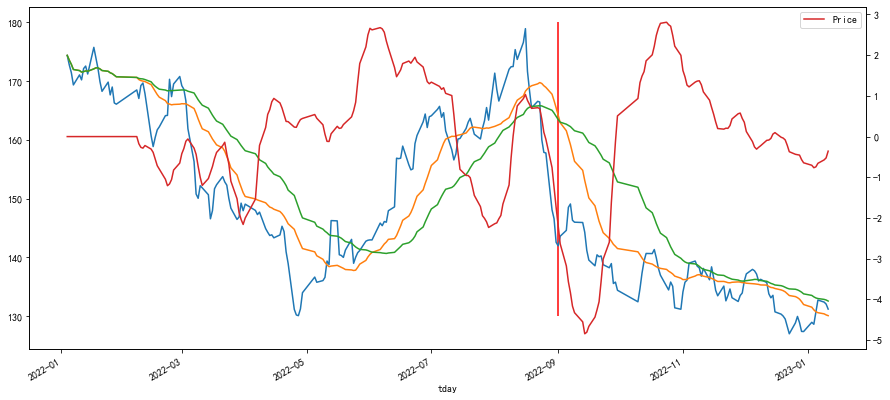

In [2057]:
date = datetime(2022,9,1)
t = ddf[ddf.行业分类一级.str.contains('化工')].set_index('tday').ClosePrice#.plot()
#sec_mean_price[sec_mean_price.行业分类一级.str.contains('汽车')].ClosePrice.plot()
t.plot(figsize=(15,7))
t20 = t.rolling(window=20,min_periods=1).mean()
t80 = t.rolling(window=40,min_periods=1).mean()
t20.plot()
t80.plot()
#plt.show()
diff = (t20-t80)#.plot()
plt.vlines(date,130,180,color = 'red')
(diff-diff.rolling(window=10,min_periods=1).mean()).plot(secondary_y=True)
plt.legend(['Price','MA20','MA40','MACD'])

In [2060]:
data_part[(data_part.tday==date)&(~data_part.hld_fac_rev.isna())][['SecuAbbr','ChangePCT','行业分类一级']]

,SecuAbbr,ChangePCT,行业分类一级
7227,万顺转债,1.54,轻工制造
10083,台华转债,-2.31,消费之衣食住行用
10890,今飞转债,0.05,汽车
14690,明泰转债,5.09,采掘与初加工
24506,恩捷转债,0.74,化工材料与产品
30579,火炬转债,0.21,军工
40808,精达转债,2.98,新能源汽车
43790,斯莱转债,-4.10,机械设备
77585,城市转债,-1.03,传统基建


In [2061]:
data_part[(data_part.tday==date)&(~data_part.hld_fac_rev_MA_20_60.isna())][['SecuAbbr','ChangePCT','行业分类一级']]

,SecuAbbr,ChangePCT,行业分类一级
23510,新天转债,-1.76,医药生物
30579,火炬转债,0.21,军工
62432,九典转债,-0.61,医药生物
65370,三角转债,-1.37,军工


In [1961]:
data_part[(data_part.tday==date)&(~data_part.hld_fac_rev_MACD.isna())][['SecuAbbr','ChangePCT','行业分类一级']]

,SecuAbbr,ChangePCT,行业分类一级
17936,远东转债,-0.37,传统基建
37002,苏试转债,1.61,半导体
44288,鸿路转债,0.48,传统基建
45532,天能转债,0.82,风电光伏
52987,旺能转债,-2.93,环保产业
54726,韦尔转债,-0.34,半导体
63129,旗滨转债,0.27,传统基建
66362,捷捷转债,-0.18,半导体
71276,江丰转债,-6.89,半导体
71689,晶瑞转2,1.02,半导体


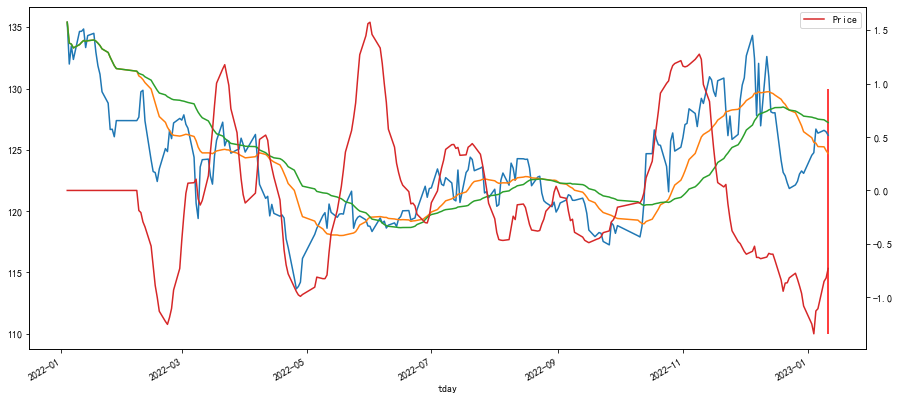

In [1962]:
t = ddf[ddf.行业分类一级.str.contains('医药')].set_index('tday').ClosePrice#.plot()
#sec_mean_price[sec_mean_price.行业分类一级.str.contains('汽车')].ClosePrice.plot()
t.plot(figsize=(15,7))
t20 = t.rolling(window=20,min_periods=1).mean()
t80 = t.rolling(window=40,min_periods=1).mean()
t20.plot()
t80.plot()
#plt.show()
diff = (t20-t80)#.plot()
plt.vlines(datetime(2023,1,11),110,130,color = 'red')
(diff-diff.rolling(window=10,min_periods=1).mean()).plot(secondary_y=True)
plt.legend(['Price','MA20','MA40','MACD'])

In [1963]:
data_part[(data_part.tday==datetime(2023,1,11))&(~data_part.hld_fac_rev.isna())][['SecuAbbr','ChangePCT','行业分类一级']]

,SecuAbbr,ChangePCT,行业分类一级
1063,金禾转债,0.27,化工材料与产品
2303,特一转债,-2.34,医药生物
7314,万顺转债,-2.42,轻工制造
14528,鼎胜转债,0.26,采掘与初加工
23597,新天转债,-1.02,医药生物
34378,美联转债,-2.14,化工材料与产品
41637,塞力转债,-0.25,医药生物
42881,万孚转债,-0.09,医药生物
49846,灵康转债,-0.07,医药生物
51945,万顺转2,-2.53,轻工制造


In [1964]:
data_part[(data_part.tday==datetime(2023,1,11))&(~data_part.hld_fac_rev_MA_20_60.isna())][['SecuAbbr','ChangePCT','行业分类一级']]

,SecuAbbr,ChangePCT,行业分类一级
15773,文灿转债,-1.55,汽车
54813,韦尔转债,-0.09,半导体
60278,盛虹转债,-0.27,风电光伏
66947,长汽转债,-0.86,汽车
73023,泉峰转债,-1.28,汽车
77193,卡倍转债,-0.55,汽车
77573,隆22转债,-0.25,风电光伏
79740,永东转2,-0.55,汽车
80441,瑞鹄转债,-2.34,汽车


In [1965]:
data_part[(data_part.tday==datetime(2023,1,11))&(~data_part.hld_fac_rev_MACD.isna())][['SecuAbbr','ChangePCT','行业分类一级']]

,SecuAbbr,ChangePCT,行业分类一级
4824,金农转债,0.03,农林牧渔
5322,敖东转债,-1.77,金融
14528,鼎胜转债,0.26,采掘与初加工
15773,文灿转债,-1.55,汽车
16151,华钰转债,-1.24,采掘与初加工
24095,希望转债,0.47,农林牧渔
25091,宏辉转债,-0.20,农林牧渔
28439,华统转债,3.69,农林牧渔
32635,正邦转债,-0.19,农林牧渔
33133,雪榕转债,0.42,农林牧渔


In [1966]:
os.getcwd()

'/home/aifi/script/jupyter_projects/hjc/cb'

In [2605]:
dt

,行业分类一级,InnerCode,ChangePCT,tday,New_fac,sig_ma,shift_sig,hld_sig,hld_ret
0,金融,119138,-0.0017,2022-01-04,0.127660,NaN,NaN,NaN,NaN
1,金融,119138,0.0051,2022-01-05,0.172535,NaN,NaN,NaN,NaN
2,金融,119138,0.0042,2022-01-06,0.182456,NaN,NaN,NaN,NaN
3,金融,119138,0.0031,2022-01-07,0.231579,NaN,NaN,NaN,NaN
4,金融,119138,0.0056,2022-01-10,0.266667,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
80495,传统基建,456970,-0.0047,2023-01-10,0.423676,NaN,NaN,NaN,NaN
80496,传统基建,456970,-0.0048,2023-01-11,0.379939,NaN,NaN,NaN,NaN
80497,半导体,457253,-0.0004,2023-01-09,0.034161,NaN,NaN,NaN,NaN
80498,半导体,457253,0.0015,2023-01-10,0.040498,NaN,NaN,NaN,NaN


In [2607]:
data.columns

Index(['InnerCode', 'YrMat', 'tday', 'StockPrice', 'ClosePrice',
       'PrevClosePrice', 'OpenPrice', 'HighPrice', 'LowPrice', 'TurnoverRate',
       'ConvertPremiumRate', 'ChangePCT', 'TurnoverVolume', 'TurnoverValue',
       'TurnoverDeals', 'ConvTermStartDate', 'RemainingAmount',
       'ChangePCT_stock', 'BackwardPrice', 'MarketValue',
       'TurnoverVolume_stock', 'TurnoverRate_stock', 'OpenPrice_stock',
       'ClosePrice_stock', 'HighPrice_stock', 'LowPrice_stock', 'ma5/ma20',
       'ma1/ma5', 'ma1/ma10', 'ma2/ma20', 'ma2/ma10', 'ma2/ma5',
       'ma5/ma20_stock', 'ma20/ma40_stock', 'ma2/ma20_stock',
       'ma20/ma60_stock', 'ma40/ma120_stock'],
      dtype='object')

,行业分类一级,InnerCode,ChangePCT,tday,New_fac,sig_ma,shift_sig,hld_sig,hld_ret,WindCode,ChiName
0,金融,119138,-0.0017,2022-01-04,0.127660,NaN,NaN,NaN,NaN,113011.SH,光大转债
1,金融,119138,0.0051,2022-01-05,0.172535,NaN,NaN,NaN,NaN,113011.SH,光大转债
2,金融,119138,0.0042,2022-01-06,0.182456,NaN,NaN,NaN,NaN,113011.SH,光大转债
3,金融,119138,0.0031,2022-01-07,0.231579,NaN,NaN,NaN,NaN,113011.SH,光大转债
4,金融,119138,0.0056,2022-01-10,0.266667,NaN,NaN,NaN,NaN,113011.SH,光大转债
...,...,...,...,...,...,...,...,...,...,...,...
80495,传统基建,456970,-0.0047,2023-01-10,0.423676,NaN,NaN,NaN,NaN,113650.SH,博22转债
80496,传统基建,456970,-0.0048,2023-01-11,0.379939,NaN,NaN,NaN,NaN,113650.SH,博22转债
80497,半导体,457253,-0.0004,2023-01-09,0.034161,NaN,NaN,NaN,NaN,118011.SH,银微转债
80498,半导体,457253,0.0015,2023-01-10,0.040498,NaN,NaN,NaN,NaN,118011.SH,银微转债


In [1967]:
dt= pd.read_excel('/home/aifi/script/jupyter_projects/hjc/cb/钢厂盈利率(247家)_全国.xlsx')

In [312]:
dt = dt.set_index('指标名称').resample('D').ffill().rolling(window=30,min_periods=1).mean()#.to_excel('/home/aifi/script/jupyter_projects/hjc/cb/钢厂盈利率(247家)_全国_ResD.xlsx')

In [314]:
dt.to_excel('/home/aifi/script/jupyter_projects/hjc/cb/钢厂盈利率(247家)_全国_RspRol.xlsx')